In [1]:
import os
import re
import pandas as pd
import numpy as np
from sklearn.model_selection import train_test_split
from khmernltk import word_tokenize
import librosa
import librosa.display
import matplotlib.pyplot as plt

In [2]:
# output_path = '/content/drive/MyDrive/CADT/Machine Learning/datasets/khmer-tts'
# output_path = '/content/drive/MyDrive/khmer-tts'

output_path = '../dataset'
print(output_path)

../dataset


In [3]:
df = pd.read_csv(f"{output_path}/line_index.tsv", sep='\t', names=["filename", "original_text"], index_col=1)
df.head()

,filename,original_text
NaN,khm_0308_0011865648,ស្ពាន កំពង់ ចម្លង អ្នកលឿង នៅ ព្រៃវែង ជា ស្ពាន ...
NaN,khm_0308_0032157149,ភ្លើង កំពុង ឆាប ឆេះ ផ្ទះ ប្រជា ពលរដ្ឋ នៅ សង្កា...
NaN,khm_0308_0038959268,អ្នក សុំ ទាន ដេក ប្រកាច់ ម្នាក់ ឯង ក្បែរ ខ្លោង...
NaN,khm_0308_0054635313,ស្ករ ត្នោត ដែល មាន គុណភាព ល្អ ផលិត នៅ ខេត្ត កំ...
NaN,khm_0308_0055735195,ភ្នំបាខែង មាន កម្ពស់ តែ ចិត សិប ម៉ែត្រ សោះ


### Text Extraction

In [4]:
def normalize_text(text):
    # Remove unwanted punctuation
    text = re.sub(r'[!?]', '', text)
    # Replace multiple spaces with a single space
    text = re.sub(r'\s+', ' ', text)
    # Trim leading/trailing spaces
    text = text.strip()
    return text

# Example usage
text = "  អា  ហារ!  "
normalized_text = normalize_text(text)
print(normalized_text)

អា ហារ


In [5]:
df["tokenized_text"] = df["original_text"].apply(word_tokenize)
df.head()

| 2025-01-07 06:05:11,467 | INFO | khmer-nltk | Loaded model from f:\Anaconda\envs\khmer-tts\Lib\site-packages\khmernltk\word_tokenize\sklearn_crf_ner_10000.sav |


,filename,original_text,tokenized_text
NaN,khm_0308_0011865648,ស្ពាន កំពង់ ចម្លង អ្នកលឿង នៅ ព្រៃវែង ជា ស្ពាន ...,"[ស្ពាន, , កំពង់, , ចម្លង, , អ្នកលឿង, , នៅ,..."
NaN,khm_0308_0032157149,ភ្លើង កំពុង ឆាប ឆេះ ផ្ទះ ប្រជា ពលរដ្ឋ នៅ សង្កា...,"[ភ្លើង, , កំពុង, , ឆាប, , ឆេះ, , ផ្ទះ, , ..."
NaN,khm_0308_0038959268,អ្នក សុំ ទាន ដេក ប្រកាច់ ម្នាក់ ឯង ក្បែរ ខ្លោង...,"[អ្នក, , សុំ, , ទាន, , ដេក, , ប្រកាច់, , ..."
NaN,khm_0308_0054635313,ស្ករ ត្នោត ដែល មាន គុណភាព ល្អ ផលិត នៅ ខេត្ត កំ...,"[ស្ករ, , ត្នោត, , ដែល, , មាន, , គុណភាព, ,..."
NaN,khm_0308_0055735195,ភ្នំបាខែង មាន កម្ពស់ តែ ចិត សិប ម៉ែត្រ សោះ,"[ភ្នំ, បាខែង, , មាន, , កម្ពស់, , តែ, , ចិត..."


In [6]:
# Filter empty tokens
df["tokenized_text"] = df["tokenized_text"].apply(
    lambda tokens: [token for token in tokens if token.strip() != '']
)
df.head()

,filename,original_text,tokenized_text
NaN,khm_0308_0011865648,ស្ពាន កំពង់ ចម្លង អ្នកលឿង នៅ ព្រៃវែង ជា ស្ពាន ...,"[ស្ពាន, កំពង់, ចម្លង, អ្នកលឿង, នៅ, ព្រៃវែង, ជា..."
NaN,khm_0308_0032157149,ភ្លើង កំពុង ឆាប ឆេះ ផ្ទះ ប្រជា ពលរដ្ឋ នៅ សង្កា...,"[ភ្លើង, កំពុង, ឆាប, ឆេះ, ផ្ទះ, ប្រជា, ពលរដ្ឋ, ..."
NaN,khm_0308_0038959268,អ្នក សុំ ទាន ដេក ប្រកាច់ ម្នាក់ ឯង ក្បែរ ខ្លោង...,"[អ្នក, សុំ, ទាន, ដេក, ប្រកាច់, ម្នាក់, ឯង, ក្ប..."
NaN,khm_0308_0054635313,ស្ករ ត្នោត ដែល មាន គុណភាព ល្អ ផលិត នៅ ខេត្ត កំ...,"[ស្ករ, ត្នោត, ដែល, មាន, គុណភាព, ល្អ, ផលិត, នៅ,..."
NaN,khm_0308_0055735195,ភ្នំបាខែង មាន កម្ពស់ តែ ចិត សិប ម៉ែត្រ សោះ,"[ភ្នំ, បាខែង, មាន, កម្ពស់, តែ, ចិត, សិប, ម៉ែត្..."


In [7]:
def grapheme_tokenize(text):
    return list(text)

df["grapheme_tokenized"] = df["original_text"].apply(grapheme_tokenize)
df.head()

,filename,original_text,tokenized_text,grapheme_tokenized
NaN,khm_0308_0011865648,ស្ពាន កំពង់ ចម្លង អ្នកលឿង នៅ ព្រៃវែង ជា ស្ពាន ...,"[ស្ពាន, កំពង់, ចម្លង, អ្នកលឿង, នៅ, ព្រៃវែង, ជា...","[ស, ្, ព, ា, ន, , ក, ំ, ព, ង, ់, , ច, ម, ្, ..."
NaN,khm_0308_0032157149,ភ្លើង កំពុង ឆាប ឆេះ ផ្ទះ ប្រជា ពលរដ្ឋ នៅ សង្កា...,"[ភ្លើង, កំពុង, ឆាប, ឆេះ, ផ្ទះ, ប្រជា, ពលរដ្ឋ, ...","[ភ, ្, ល, ើ, ង, , ក, ំ, ព, ុ, ង, , ឆ, ា, ប, ..."
NaN,khm_0308_0038959268,អ្នក សុំ ទាន ដេក ប្រកាច់ ម្នាក់ ឯង ក្បែរ ខ្លោង...,"[អ្នក, សុំ, ទាន, ដេក, ប្រកាច់, ម្នាក់, ឯង, ក្ប...","[អ, ្, ន, ក, , ស, ុ, ំ, , ទ, ា, ន, , ដ, េ, ..."
NaN,khm_0308_0054635313,ស្ករ ត្នោត ដែល មាន គុណភាព ល្អ ផលិត នៅ ខេត្ត កំ...,"[ស្ករ, ត្នោត, ដែល, មាន, គុណភាព, ល្អ, ផលិត, នៅ,...","[ស, ្, ក, រ, , ត, ្, ន, ោ, ត, , ដ, ែ, ល, , ..."
NaN,khm_0308_0055735195,ភ្នំបាខែង មាន កម្ពស់ តែ ចិត សិប ម៉ែត្រ សោះ,"[ភ្នំ, បាខែង, មាន, កម្ពស់, តែ, ចិត, សិប, ម៉ែត្...","[ភ, ្, ន, ំ, ប, ា, ខ, ែ, ង, , ម, ា, ន, , ក, ..."


In [8]:
# Build vocabulary for graphemes
all_graphemes = set("".join(df["grapheme_tokenized"].sum()))
vocab = {grapheme: idx for idx, grapheme in enumerate(sorted(all_graphemes))}
print(vocab)

with open(f"{output_path}/tacotron2_grapheme_vocab.txt", "w+") as f:
  f.write(str(vocab))

{' ': 0, 'ក': 1, 'ខ': 2, 'គ': 3, 'ឃ': 4, 'ង': 5, 'ច': 6, 'ឆ': 7, 'ជ': 8, 'ឈ': 9, 'ញ': 10, 'ដ': 11, 'ឋ': 12, 'ឌ': 13, 'ឍ': 14, 'ណ': 15, 'ត': 16, 'ថ': 17, 'ទ': 18, 'ធ': 19, 'ន': 20, 'ប': 21, 'ផ': 22, 'ព': 23, 'ភ': 24, 'ម': 25, 'យ': 26, 'រ': 27, 'ល': 28, 'វ': 29, 'ស': 30, 'ហ': 31, 'ឡ': 32, 'អ': 33, 'ឥ': 34, 'ឧ': 35, 'ឪ': 36, 'ឫ': 37, 'ឬ': 38, 'ឭ': 39, 'ឮ': 40, 'ឯ': 41, 'ឱ': 42, 'ា': 43, 'ិ': 44, 'ី': 45, 'ឹ': 46, 'ឺ': 47, 'ុ': 48, 'ូ': 49, 'ួ': 50, 'ើ': 51, 'ឿ': 52, 'ៀ': 53, 'េ': 54, 'ែ': 55, 'ៃ': 56, 'ោ': 57, 'ៅ': 58, 'ំ': 59, 'ះ': 60, 'ៈ': 61, '៉': 62, '៊': 63, '់': 64, '៌': 65, '៍': 66, '៎': 67, '៏': 68, '័': 69, '្': 70}


In [9]:
# Encode grapheme-tokenized text
df["encoded_grapheme_text"] = df["grapheme_tokenized"].apply(
    lambda graphemes: [vocab[grapheme] for grapheme in graphemes]
)
df.head()

,filename,original_text,tokenized_text,grapheme_tokenized,encoded_grapheme_text
NaN,khm_0308_0011865648,ស្ពាន កំពង់ ចម្លង អ្នកលឿង នៅ ព្រៃវែង ជា ស្ពាន ...,"[ស្ពាន, កំពង់, ចម្លង, អ្នកលឿង, នៅ, ព្រៃវែង, ជា...","[ស, ្, ព, ា, ន, , ក, ំ, ព, ង, ់, , ច, ម, ្, ...","[30, 70, 23, 43, 20, 0, 1, 59, 23, 5, 64, 0, 6..."
NaN,khm_0308_0032157149,ភ្លើង កំពុង ឆាប ឆេះ ផ្ទះ ប្រជា ពលរដ្ឋ នៅ សង្កា...,"[ភ្លើង, កំពុង, ឆាប, ឆេះ, ផ្ទះ, ប្រជា, ពលរដ្ឋ, ...","[ភ, ្, ល, ើ, ង, , ក, ំ, ព, ុ, ង, , ឆ, ា, ប, ...","[24, 70, 28, 51, 5, 0, 1, 59, 23, 48, 5, 0, 7,..."
NaN,khm_0308_0038959268,អ្នក សុំ ទាន ដេក ប្រកាច់ ម្នាក់ ឯង ក្បែរ ខ្លោង...,"[អ្នក, សុំ, ទាន, ដេក, ប្រកាច់, ម្នាក់, ឯង, ក្ប...","[អ, ្, ន, ក, , ស, ុ, ំ, , ទ, ា, ន, , ដ, េ, ...","[33, 70, 20, 1, 0, 30, 48, 59, 0, 18, 43, 20, ..."
NaN,khm_0308_0054635313,ស្ករ ត្នោត ដែល មាន គុណភាព ល្អ ផលិត នៅ ខេត្ត កំ...,"[ស្ករ, ត្នោត, ដែល, មាន, គុណភាព, ល្អ, ផលិត, នៅ,...","[ស, ្, ក, រ, , ត, ្, ន, ោ, ត, , ដ, ែ, ល, , ...","[30, 70, 1, 27, 0, 16, 70, 20, 57, 16, 0, 11, ..."
NaN,khm_0308_0055735195,ភ្នំបាខែង មាន កម្ពស់ តែ ចិត សិប ម៉ែត្រ សោះ,"[ភ្នំ, បាខែង, មាន, កម្ពស់, តែ, ចិត, សិប, ម៉ែត្...","[ភ, ្, ន, ំ, ប, ា, ខ, ែ, ង, , ម, ា, ន, , ក, ...","[24, 70, 20, 59, 21, 43, 2, 55, 5, 0, 25, 43, ..."


### Audio Extraction

In [10]:
def process_audio_files(input_dir, output_dir):
    for index, row in df.iterrows():
        audio_path = os.path.join(input_dir, f"{row['filename']}.wav")
        output_path = os.path.join(output_dir, f"{row['filename']}_mel.npy")

        # Load and process audio
        waveform, sample_rate = librosa.load(audio_path, sr=22050)
        waveform = waveform / max(abs(waveform))  # Normalize
        waveform, _ = librosa.effects.trim(waveform)  # Trim silence

        # Compute Mel spectrogram
        mel_spectrogram = librosa.feature.melspectrogram(
            y=waveform, sr=sample_rate, n_fft=1024, hop_length=256, n_mels=80
        )
        mel_spectrogram_db = librosa.power_to_db(mel_spectrogram, ref=np.max)

        # Save as .npy
        np.save(output_path, mel_spectrogram_db)

    print("Audio processing completed!")

# Example usage
# process_audio_files(f"{output_path}/wavs/", f"{output_path}/processed_wavs/")

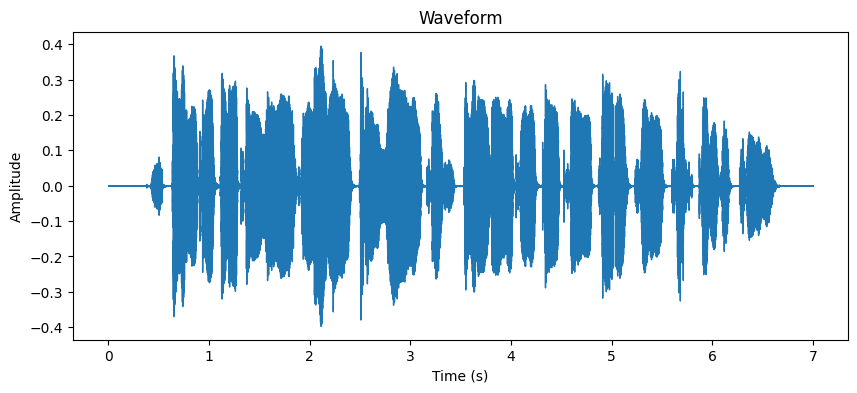

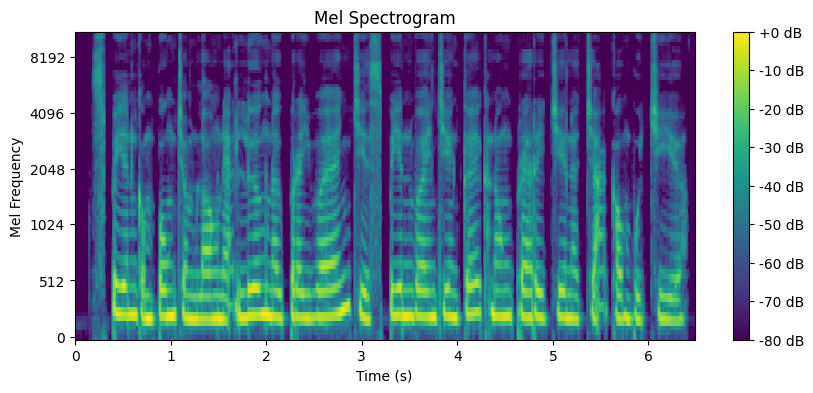

In [11]:
# Validate mel spectrogram
# Load the original waveform
audio_path = f"{output_path}/wavs/khm_0308_0011865648.wav"
waveform, sr = librosa.load(audio_path, sr=22050)

# Load the Mel spectrogram
mel_path = f"{output_path}/processed_wavs/khm_0308_0011865648_mel.npy"
mel_spectrogram = np.load(mel_path)

# Plot the waveform
plt.figure(figsize=(10, 4))
plt.title("Waveform")
librosa.display.waveshow(waveform, sr=sr)
plt.xlabel("Time (s)")
plt.ylabel("Amplitude")
plt.show()

# Plot the Mel spectrogram
plt.figure(figsize=(10, 4))
plt.title("Mel Spectrogram")
librosa.display.specshow(mel_spectrogram, sr=sr, hop_length=256, x_axis='time', y_axis='mel', cmap='viridis')
plt.colorbar(format="%+2.0f dB")
plt.xlabel("Time (s)")
plt.ylabel("Mel Frequency")
plt.show()

In [12]:
# Include the mel spectrogram path
df["mel_path"] = df["filename"].apply(lambda x: f"processed_wavs/{x.split('.')[0]}_mel.npy")
df.head()

,filename,original_text,tokenized_text,grapheme_tokenized,encoded_grapheme_text,mel_path
NaN,khm_0308_0011865648,ស្ពាន កំពង់ ចម្លង អ្នកលឿង នៅ ព្រៃវែង ជា ស្ពាន ...,"[ស្ពាន, កំពង់, ចម្លង, អ្នកលឿង, នៅ, ព្រៃវែង, ជា...","[ស, ្, ព, ា, ន, , ក, ំ, ព, ង, ់, , ច, ម, ្, ...","[30, 70, 23, 43, 20, 0, 1, 59, 23, 5, 64, 0, 6...",processed_wavs/khm_0308_0011865648_mel.npy
NaN,khm_0308_0032157149,ភ្លើង កំពុង ឆាប ឆេះ ផ្ទះ ប្រជា ពលរដ្ឋ នៅ សង្កា...,"[ភ្លើង, កំពុង, ឆាប, ឆេះ, ផ្ទះ, ប្រជា, ពលរដ្ឋ, ...","[ភ, ្, ល, ើ, ង, , ក, ំ, ព, ុ, ង, , ឆ, ា, ប, ...","[24, 70, 28, 51, 5, 0, 1, 59, 23, 48, 5, 0, 7,...",processed_wavs/khm_0308_0032157149_mel.npy
NaN,khm_0308_0038959268,អ្នក សុំ ទាន ដេក ប្រកាច់ ម្នាក់ ឯង ក្បែរ ខ្លោង...,"[អ្នក, សុំ, ទាន, ដេក, ប្រកាច់, ម្នាក់, ឯង, ក្ប...","[អ, ្, ន, ក, , ស, ុ, ំ, , ទ, ា, ន, , ដ, េ, ...","[33, 70, 20, 1, 0, 30, 48, 59, 0, 18, 43, 20, ...",processed_wavs/khm_0308_0038959268_mel.npy
NaN,khm_0308_0054635313,ស្ករ ត្នោត ដែល មាន គុណភាព ល្អ ផលិត នៅ ខេត្ត កំ...,"[ស្ករ, ត្នោត, ដែល, មាន, គុណភាព, ល្អ, ផលិត, នៅ,...","[ស, ្, ក, រ, , ត, ្, ន, ោ, ត, , ដ, ែ, ល, , ...","[30, 70, 1, 27, 0, 16, 70, 20, 57, 16, 0, 11, ...",processed_wavs/khm_0308_0054635313_mel.npy
NaN,khm_0308_0055735195,ភ្នំបាខែង មាន កម្ពស់ តែ ចិត សិប ម៉ែត្រ សោះ,"[ភ្នំ, បាខែង, មាន, កម្ពស់, តែ, ចិត, សិប, ម៉ែត្...","[ភ, ្, ន, ំ, ប, ា, ខ, ែ, ង, , ម, ា, ន, , ក, ...","[24, 70, 20, 59, 21, 43, 2, 55, 5, 0, 25, 43, ...",processed_wavs/khm_0308_0055735195_mel.npy


In [13]:
# tokenized_texts = df['tokenized_text']

# vocab = {token: idx for idx, token in enumerate(set(sum(tokenized_texts, [])))}
# print(vocab)

# encoded_texts = [[vocab[token] for token in tokens] for tokens in tokenized_texts]
# # print(encoded_texts)

# df['encoded_text'] = encoded_texts
# df.head()

In [14]:
# Save the updated tsv
df.to_csv(f"{output_path}/updated_metadata.tsv", sep="\t", header=True, index=False)

### Training

In [15]:
from torch.utils.data import Dataset
import torch
import torch.nn.functional as F  # Add this import

class TTS_Dataset(Dataset):
    def __init__(self, metadata):
        self.metadata = metadata

    def __len__(self):
        return len(self.metadata)

    def __getitem__(self, idx):
        # Load encoded text and mel spectrogram
        text = self.metadata.iloc[idx]["encoded_grapheme_text"]
        mel_path = self.metadata.iloc[idx]["mel_path"]
        mel = np.load(f"{output_path}/{mel_path}")

        # Convert to tensors
        text = torch.tensor(text, dtype=torch.long)
        mel = torch.tensor(mel, dtype=torch.float)

        return text, mel

In [16]:
from torch.nn.utils.rnn import pad_sequence

def collate_fn(batch):
    # Sort by text length (descending)
    batch.sort(key=lambda x: len(x[0]), reverse=True)

    # Separate text and mel
    text_padded = []
    mel_padded = []
    text_lengths = []
    mel_lengths = []
    gates_padded = []

    max_text_len = max(len(x[0]) for x in batch)
    max_mel_len = max(x[1].size(1) for x in batch)  # Assuming mel shape is (80, time)

    for text, mel in batch:
        # Get lengths
        text_len = len(text)
        mel_len = mel.size(1)

        # Pad text
        text_pad = F.pad(text, (0, max_text_len - text_len), value=0)
        text_padded.append(text_pad)
        text_lengths.append(text_len)

        # Pad mel
        mel_pad = F.pad(mel, (0, max_mel_len - mel_len), value=0)
        mel_padded.append(mel_pad)
        mel_lengths.append(mel_len)

        # Create gate target (1s followed by a 0 at the end)
        gate = torch.ones(max_mel_len)
        gate[mel_len-1:] = 0  # Set padding positions to 0
        gates_padded.append(gate)

    # Stack everything
    text_padded = torch.stack(text_padded)
    mel_padded = torch.stack(mel_padded)
    text_lengths = torch.LongTensor(text_lengths)
    mel_lengths = torch.LongTensor(mel_lengths)
    gates_padded = torch.stack(gates_padded)

    return text_padded, text_lengths, mel_padded, mel_lengths, gates_padded

In [17]:
from torch.utils.data import DataLoader

dataset = TTS_Dataset(df)
# Reduced the batch_size if using CPU if not keep it at 30 or 32
dataloader = DataLoader(dataset, batch_size=24, shuffle=True, collate_fn=collate_fn, num_workers=0)

Using cache found in C:\Users\ADMIN/.cache\torch\hub\NVIDIA_DeepLearningExamples_torchhub
C:\Users\ADMIN/.cache\torch\hub\NVIDIA_DeepLearningExamples_torchhub\PyTorch\Classification\ConvNets\image_classification\models\common.py:13: UserWarning: pytorch_quantization module not found, quantization will not be available
  warnings.warn(
C:\Users\ADMIN/.cache\torch\hub\NVIDIA_DeepLearningExamples_torchhub\PyTorch\Classification\ConvNets\image_classification\models\efficientnet.py:17: UserWarning: pytorch_quantization module not found, quantization will not be available
  warnings.warn(


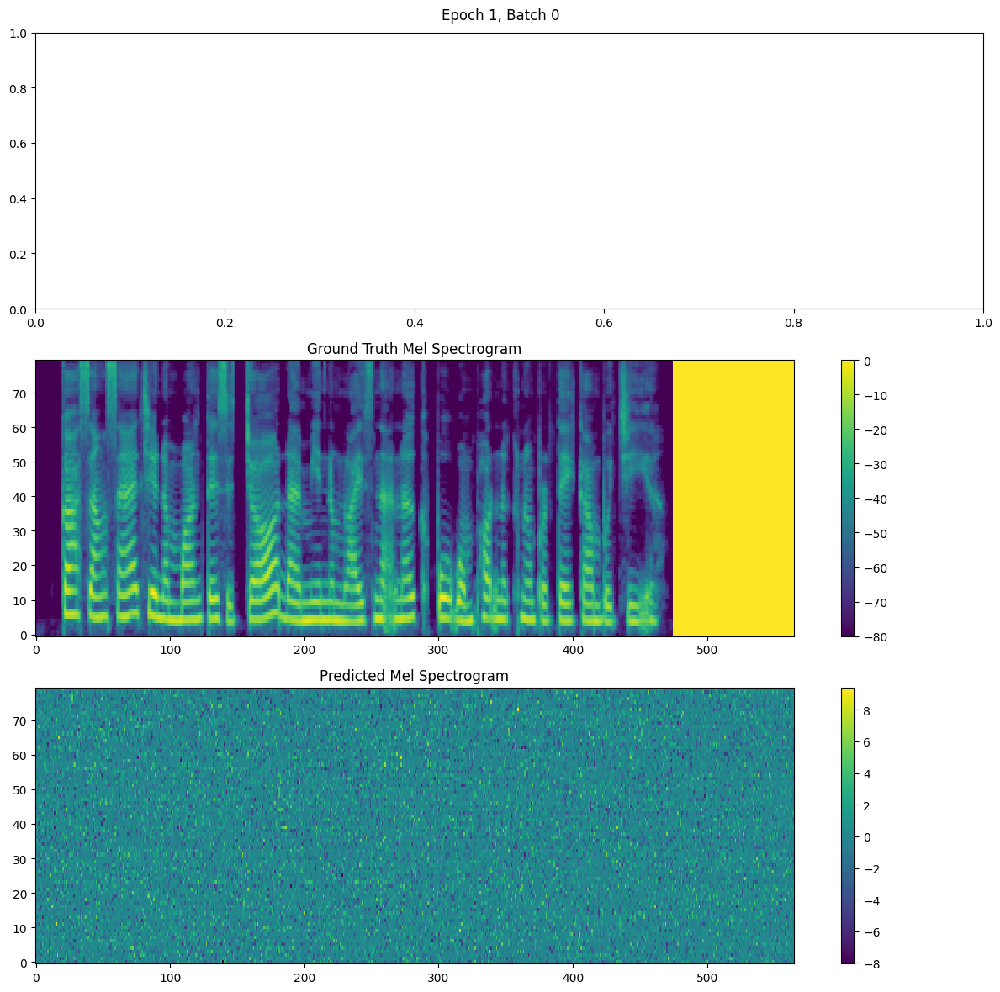

Gradient norm: 126.22593281205566
Epoch 1/20, Batch 0, Loss: 4637.2378, Mel Loss: 4636.5547, Gate Loss: 0.6832, LR: 0.000500
Gradient norm: 507.0732709725636
Epoch 1/20, Batch 10, Loss: 3804.6021, Mel Loss: 3804.2515, Gate Loss: 0.3507, LR: 0.000500
Gradient norm: 374.5627286075248
Epoch 1/20, Batch 20, Loss: 2242.9712, Mel Loss: 2242.8506, Gate Loss: 0.1206, LR: 0.000500
Gradient norm: 201.89946038414803
Epoch 1/20, Batch 30, Loss: 1011.5416, Mel Loss: 1011.5119, Gate Loss: 0.0297, LR: 0.000500
Gradient norm: 255.7947560866175
Epoch 1/20, Batch 40, Loss: 1092.9362, Mel Loss: 1092.9088, Gate Loss: 0.0274, LR: 0.000500


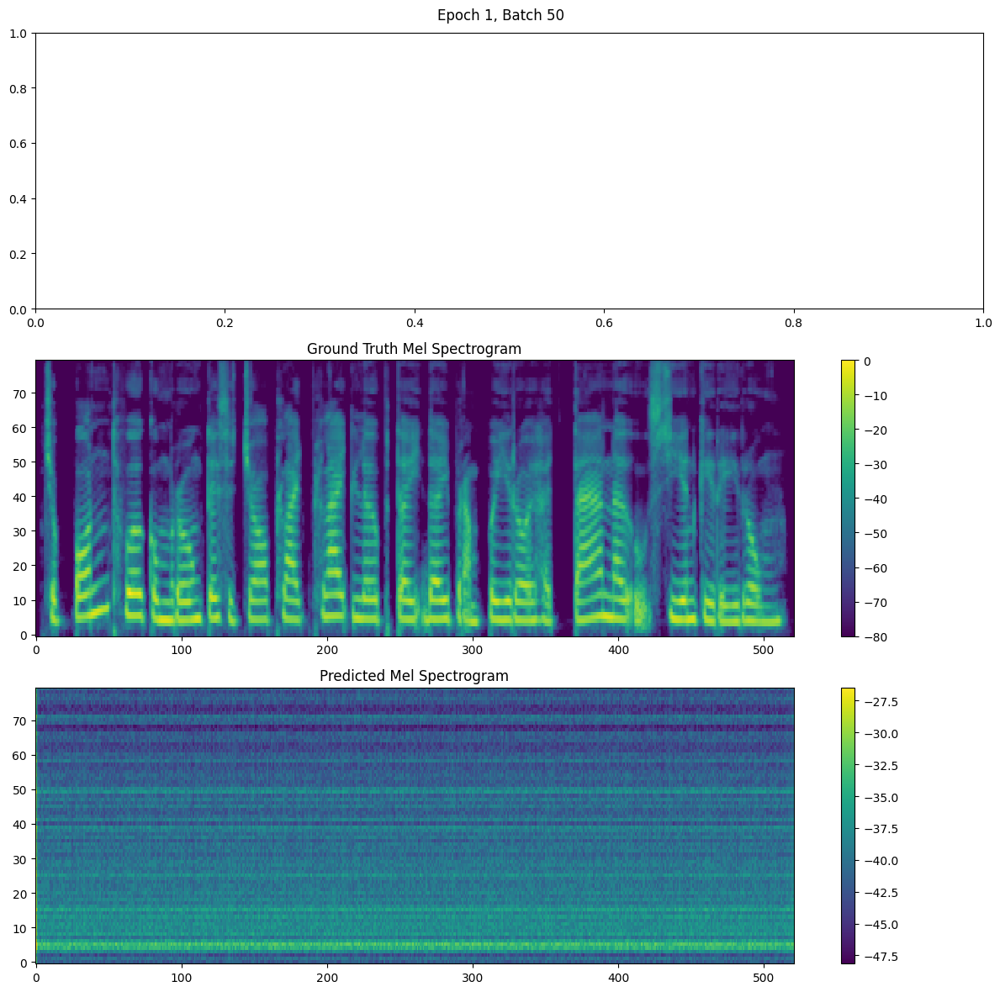

Gradient norm: 198.05591454394025
Epoch 1/20, Batch 50, Loss: 809.1794, Mel Loss: 809.1540, Gate Loss: 0.0254, LR: 0.000500
Gradient norm: 102.91491165083325
Epoch 1/20, Batch 60, Loss: 440.3563, Mel Loss: 440.3326, Gate Loss: 0.0238, LR: 0.000500
Gradient norm: 47.797639735588135
Epoch 1/20, Batch 70, Loss: 321.9781, Mel Loss: 321.9583, Gate Loss: 0.0198, LR: 0.000500
Gradient norm: 19.623407770569234
Epoch 1/20, Batch 80, Loss: 297.9873, Mel Loss: 297.9684, Gate Loss: 0.0188, LR: 0.000500
Gradient norm: 71.81965293476178
Epoch 1/20, Batch 90, Loss: 274.7171, Mel Loss: 274.7008, Gate Loss: 0.0163, LR: 0.000500


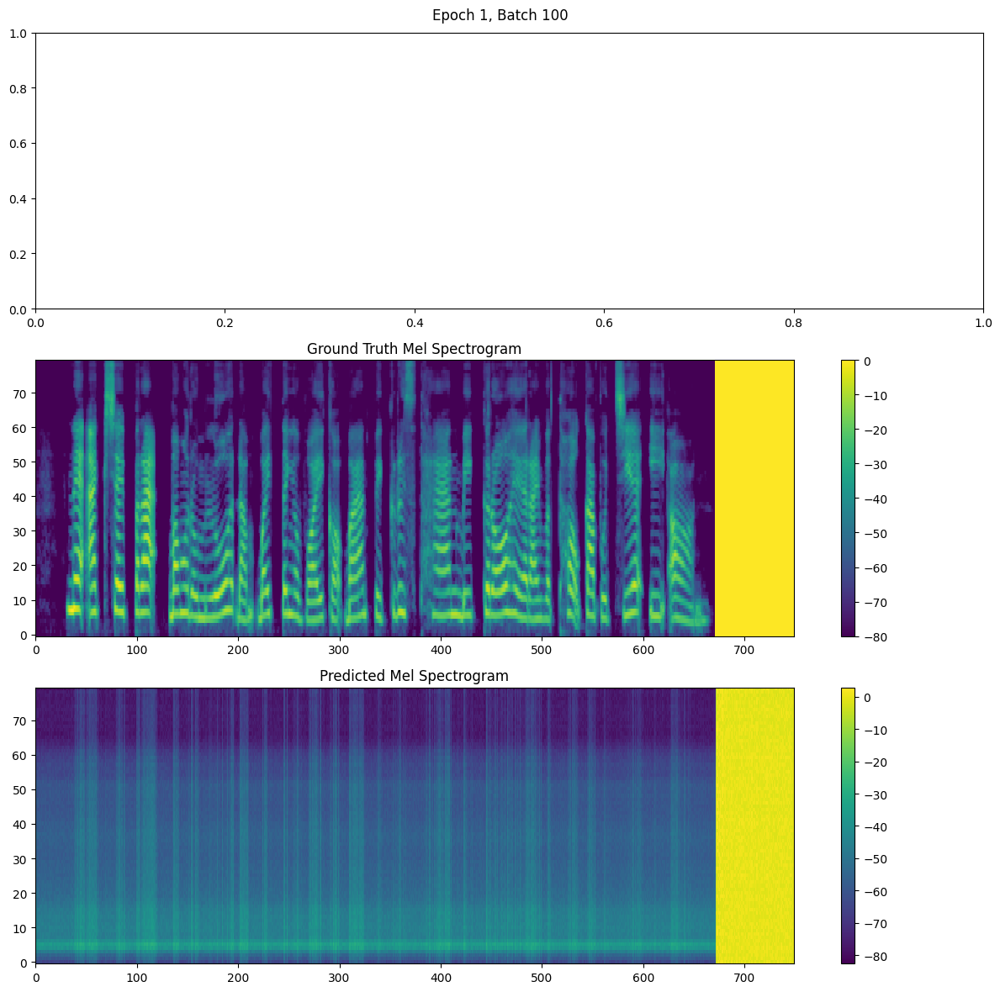

Gradient norm: 114.6833468372257
Epoch 1/20, Batch 100, Loss: 238.0223, Mel Loss: 238.0049, Gate Loss: 0.0174, LR: 0.000500
Gradient norm: 67.17435971703908
Epoch 1/20, Batch 110, Loss: 167.3011, Mel Loss: 167.2868, Gate Loss: 0.0142, LR: 0.000500
Gradient norm: 93.74297134218537
Epoch 1/20, Batch 120, Loss: 234.1390, Mel Loss: 234.1145, Gate Loss: 0.0245, LR: 0.000500
Epoch 1/20, Average Loss: 1040.4419


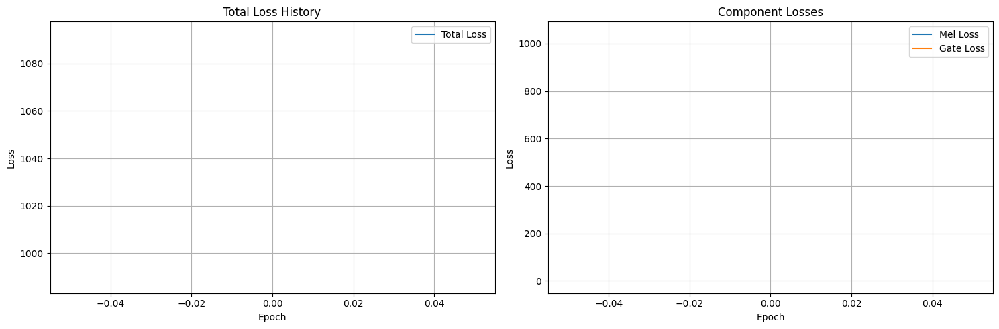

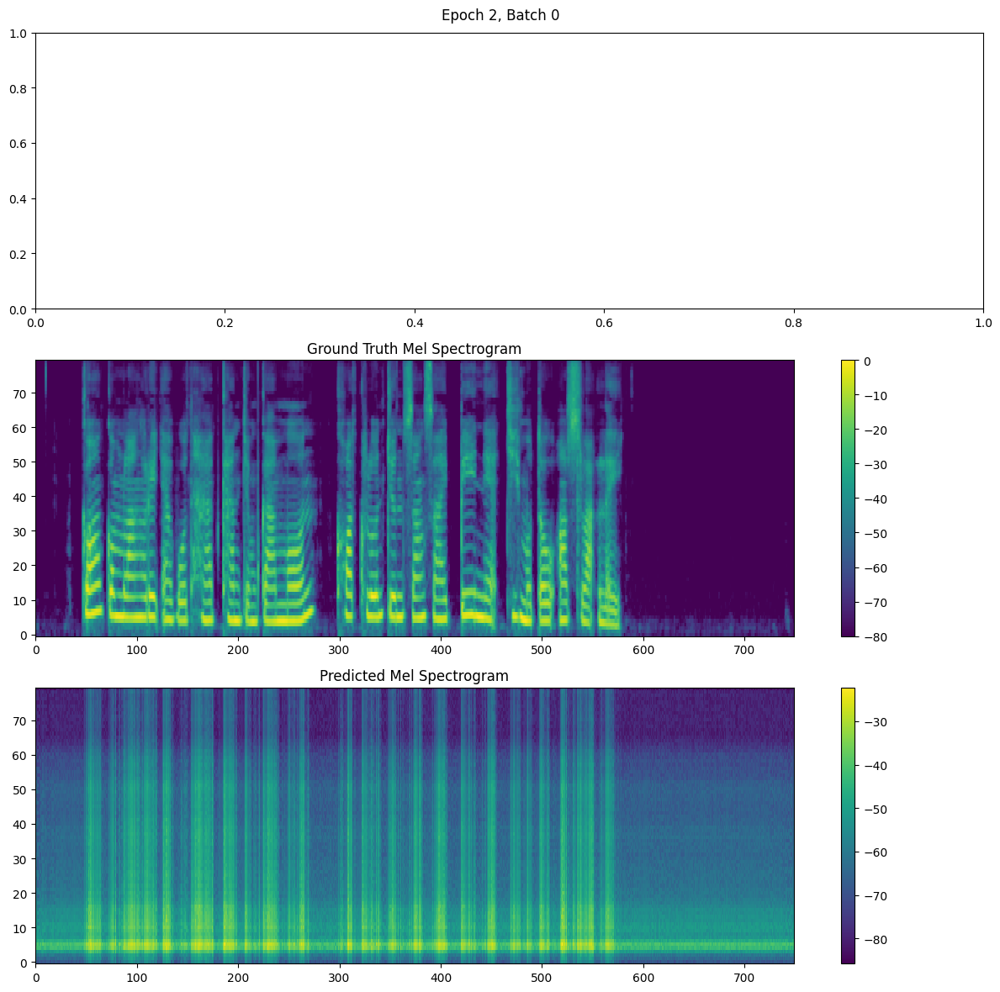

Gradient norm: 259.88493376151615
Epoch 2/20, Batch 0, Loss: 176.2406, Mel Loss: 176.2232, Gate Loss: 0.0175, LR: 0.000475
Gradient norm: 76.25594597332369
Epoch 2/20, Batch 10, Loss: 165.1478, Mel Loss: 165.1310, Gate Loss: 0.0168, LR: 0.000475
Gradient norm: 116.32463574585174
Epoch 2/20, Batch 20, Loss: 208.7014, Mel Loss: 208.6768, Gate Loss: 0.0245, LR: 0.000475
Gradient norm: 107.66516381736537
Epoch 2/20, Batch 30, Loss: 154.4897, Mel Loss: 154.4745, Gate Loss: 0.0152, LR: 0.000475
Gradient norm: 60.92641570154435
Epoch 2/20, Batch 40, Loss: 155.3461, Mel Loss: 155.3293, Gate Loss: 0.0168, LR: 0.000475


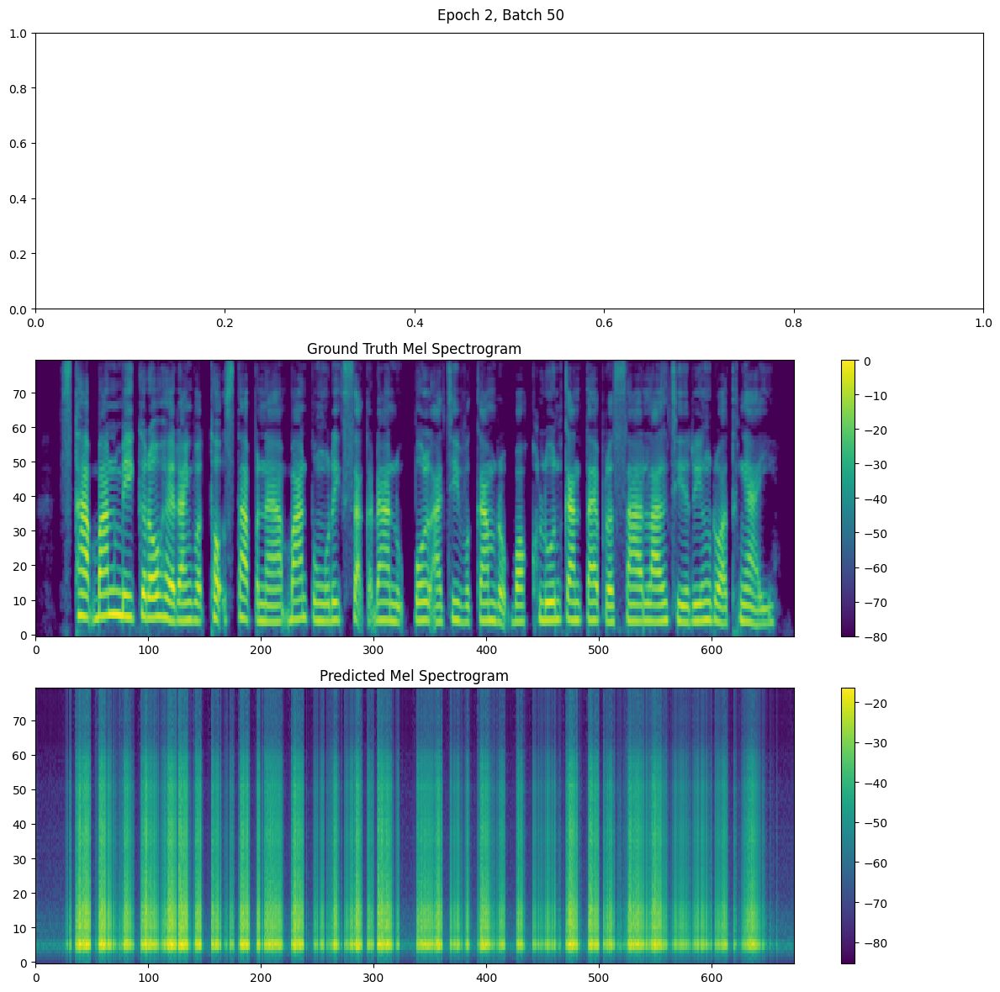

Gradient norm: 308.78353393074053
Epoch 2/20, Batch 50, Loss: 176.5345, Mel Loss: 176.5171, Gate Loss: 0.0175, LR: 0.000475
Gradient norm: 233.09152448868437
Epoch 2/20, Batch 60, Loss: 161.9061, Mel Loss: 161.8885, Gate Loss: 0.0177, LR: 0.000475
Gradient norm: 153.48199777010188
Epoch 2/20, Batch 70, Loss: 152.8994, Mel Loss: 152.8844, Gate Loss: 0.0149, LR: 0.000475
Gradient norm: 126.77617641840585
Epoch 2/20, Batch 80, Loss: 140.3957, Mel Loss: 140.3803, Gate Loss: 0.0153, LR: 0.000475
Gradient norm: 313.80348622507876
Epoch 2/20, Batch 90, Loss: 194.5405, Mel Loss: 194.5198, Gate Loss: 0.0207, LR: 0.000475


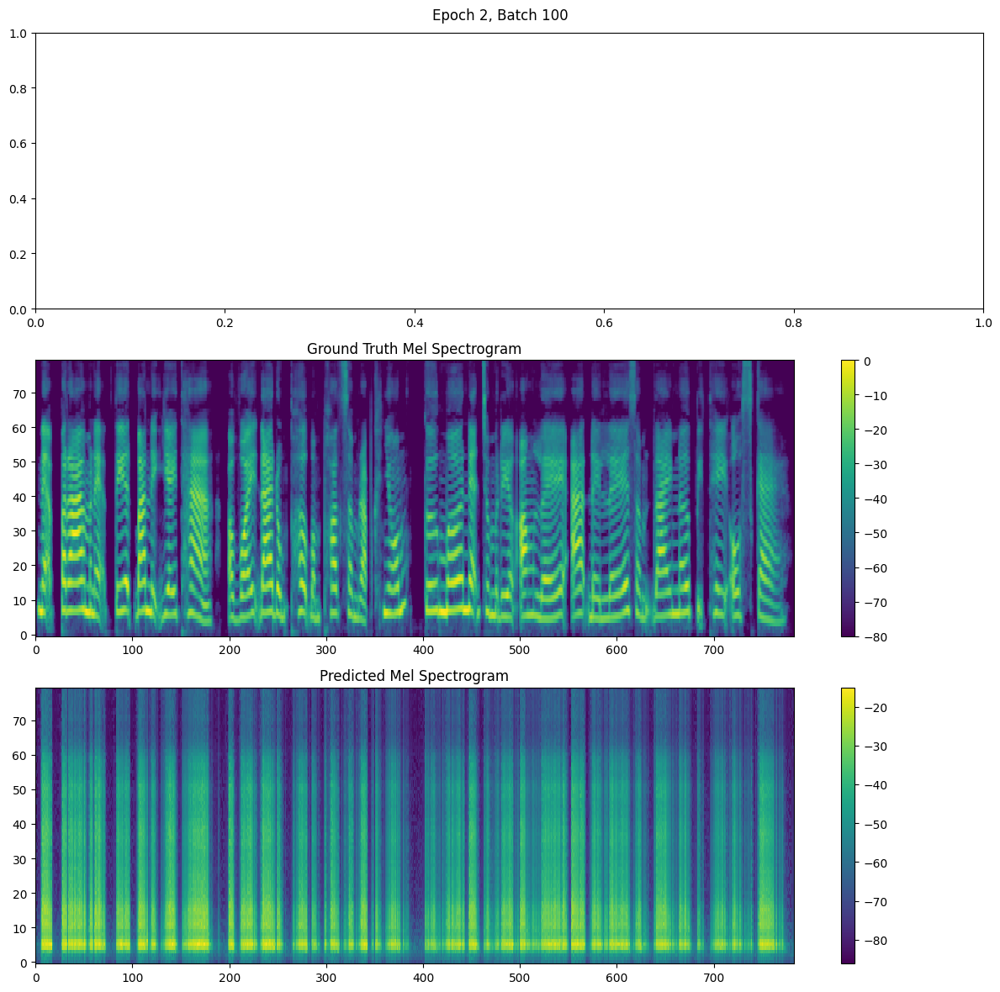

Gradient norm: 141.04814820473325
Epoch 2/20, Batch 100, Loss: 118.0078, Mel Loss: 117.9948, Gate Loss: 0.0131, LR: 0.000475
Gradient norm: 175.02963923602218
Epoch 2/20, Batch 110, Loss: 150.0556, Mel Loss: 150.0396, Gate Loss: 0.0160, LR: 0.000475
Gradient norm: 126.88032464713469
Epoch 2/20, Batch 120, Loss: 194.4896, Mel Loss: 194.4696, Gate Loss: 0.0200, LR: 0.000475
Epoch 2/20, Average Loss: 168.4215


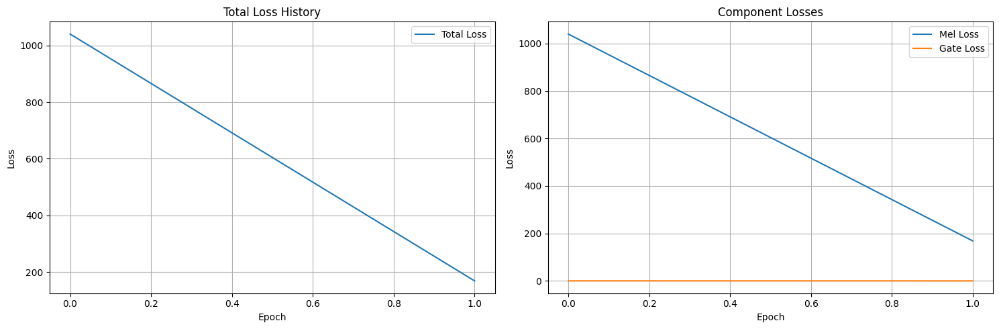

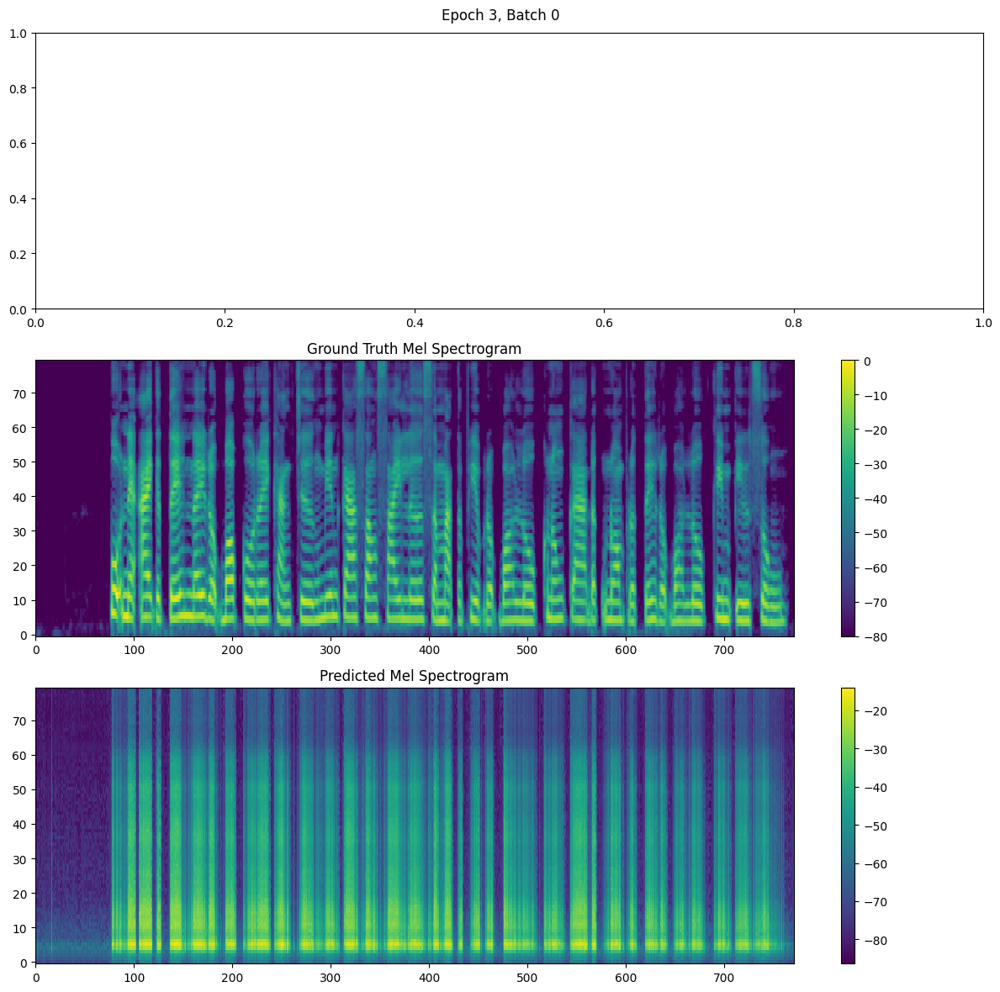

Gradient norm: 55.628936379109504
Epoch 3/20, Batch 0, Loss: 126.8249, Mel Loss: 126.8120, Gate Loss: 0.0130, LR: 0.000451
Gradient norm: 243.84938263609695
Epoch 3/20, Batch 10, Loss: 161.5649, Mel Loss: 161.5472, Gate Loss: 0.0177, LR: 0.000451
Gradient norm: 76.33476227642325
Epoch 3/20, Batch 20, Loss: 158.5270, Mel Loss: 158.5099, Gate Loss: 0.0171, LR: 0.000451
Gradient norm: 104.70719676378043
Epoch 3/20, Batch 30, Loss: 107.5564, Mel Loss: 107.5448, Gate Loss: 0.0116, LR: 0.000451
Gradient norm: 156.53889631006572
Epoch 3/20, Batch 40, Loss: 137.9453, Mel Loss: 137.9311, Gate Loss: 0.0143, LR: 0.000451


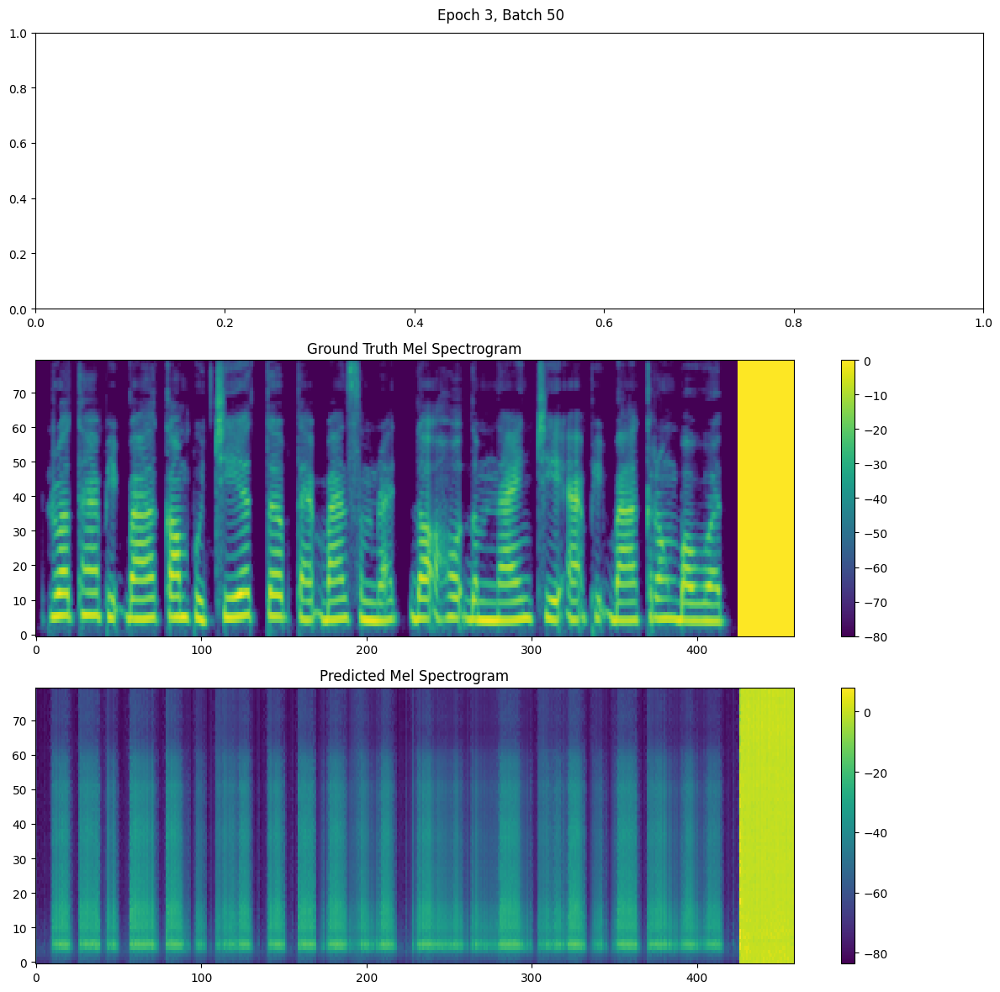

Gradient norm: 308.5500272607789
Epoch 3/20, Batch 50, Loss: 185.9296, Mel Loss: 185.9079, Gate Loss: 0.0216, LR: 0.000451
Gradient norm: 109.04944925181397
Epoch 3/20, Batch 60, Loss: 99.8323, Mel Loss: 99.8217, Gate Loss: 0.0106, LR: 0.000451
Gradient norm: 65.36084021481385
Epoch 3/20, Batch 70, Loss: 144.1881, Mel Loss: 144.1717, Gate Loss: 0.0165, LR: 0.000451
Gradient norm: 185.77523160906134
Epoch 3/20, Batch 80, Loss: 148.6806, Mel Loss: 148.6612, Gate Loss: 0.0194, LR: 0.000451
Gradient norm: 64.22881025901098
Epoch 3/20, Batch 90, Loss: 140.9431, Mel Loss: 140.9273, Gate Loss: 0.0158, LR: 0.000451


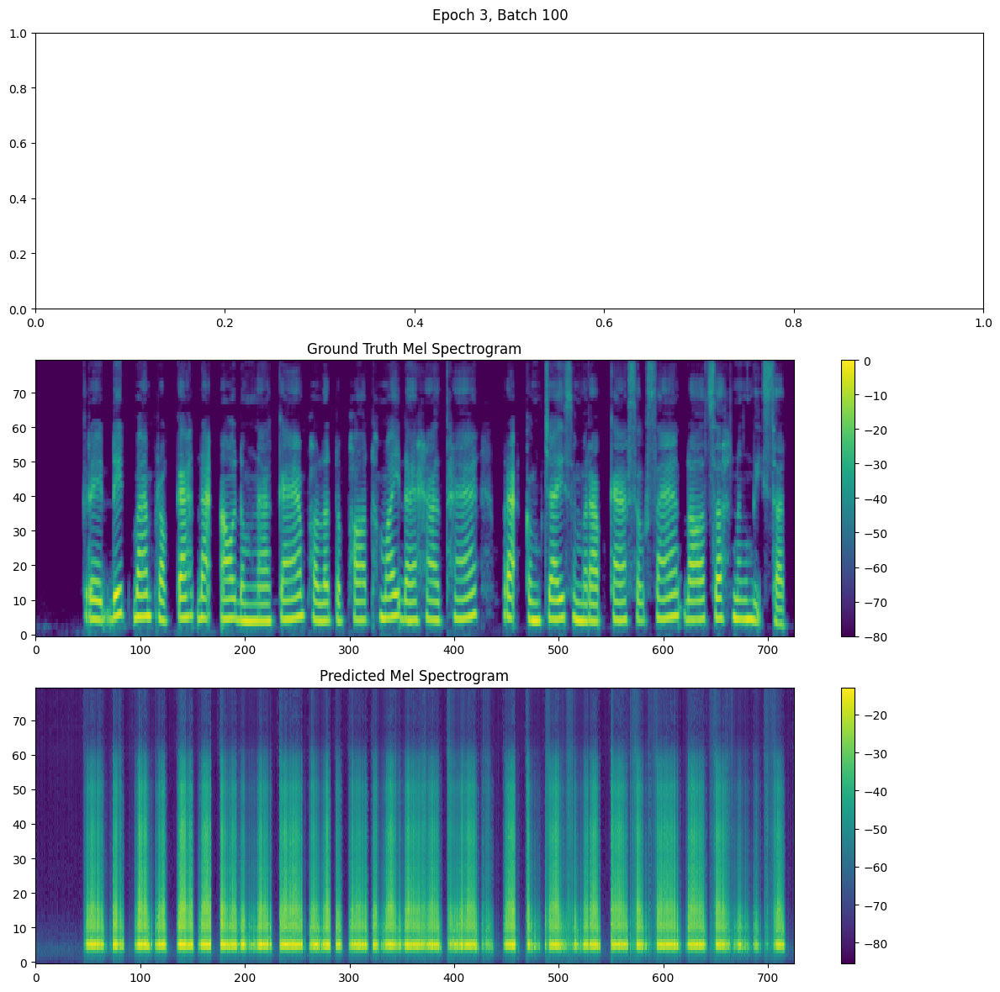

Gradient norm: 102.58364732477456
Epoch 3/20, Batch 100, Loss: 110.7498, Mel Loss: 110.7365, Gate Loss: 0.0133, LR: 0.000451
Gradient norm: 215.4452170337693
Epoch 3/20, Batch 110, Loss: 134.4212, Mel Loss: 134.4064, Gate Loss: 0.0148, LR: 0.000451
Gradient norm: 58.0290938279099
Epoch 3/20, Batch 120, Loss: 127.6000, Mel Loss: 127.5841, Gate Loss: 0.0159, LR: 0.000451
Epoch 3/20, Average Loss: 138.5824


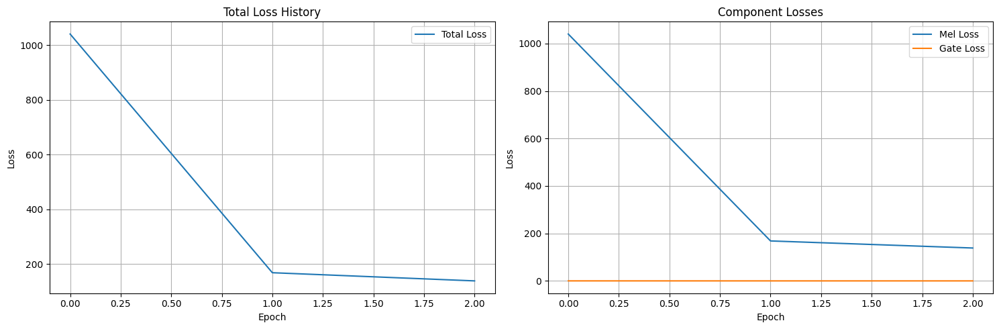

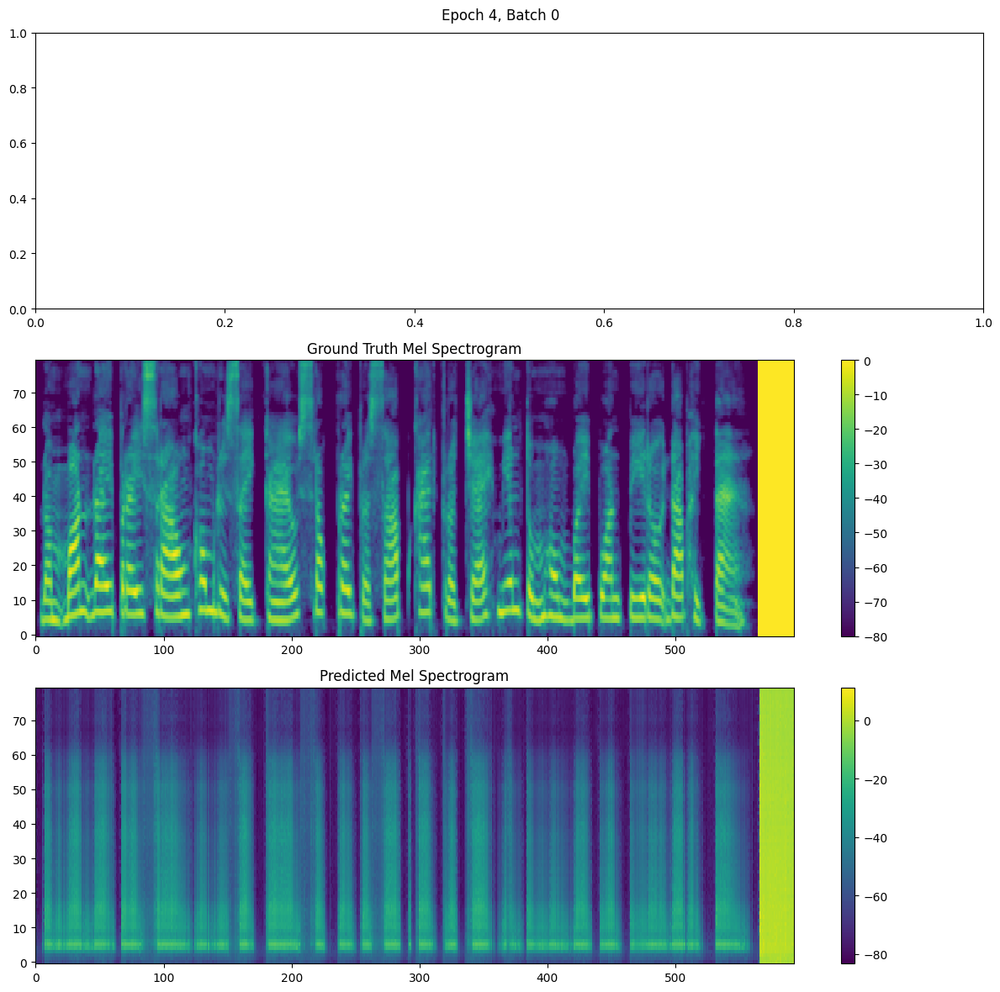

Gradient norm: 79.07661985624866
Epoch 4/20, Batch 0, Loss: 131.2186, Mel Loss: 131.2020, Gate Loss: 0.0166, LR: 0.000429
Gradient norm: 61.08398115005039
Epoch 4/20, Batch 10, Loss: 123.3428, Mel Loss: 123.3288, Gate Loss: 0.0141, LR: 0.000429
Gradient norm: 205.3229711544229
Epoch 4/20, Batch 20, Loss: 121.3837, Mel Loss: 121.3695, Gate Loss: 0.0142, LR: 0.000429
Gradient norm: 248.85431428842494
Epoch 4/20, Batch 30, Loss: 107.1870, Mel Loss: 107.1742, Gate Loss: 0.0128, LR: 0.000429
Gradient norm: 255.36061968833803
Epoch 4/20, Batch 40, Loss: 121.4884, Mel Loss: 121.4734, Gate Loss: 0.0150, LR: 0.000429


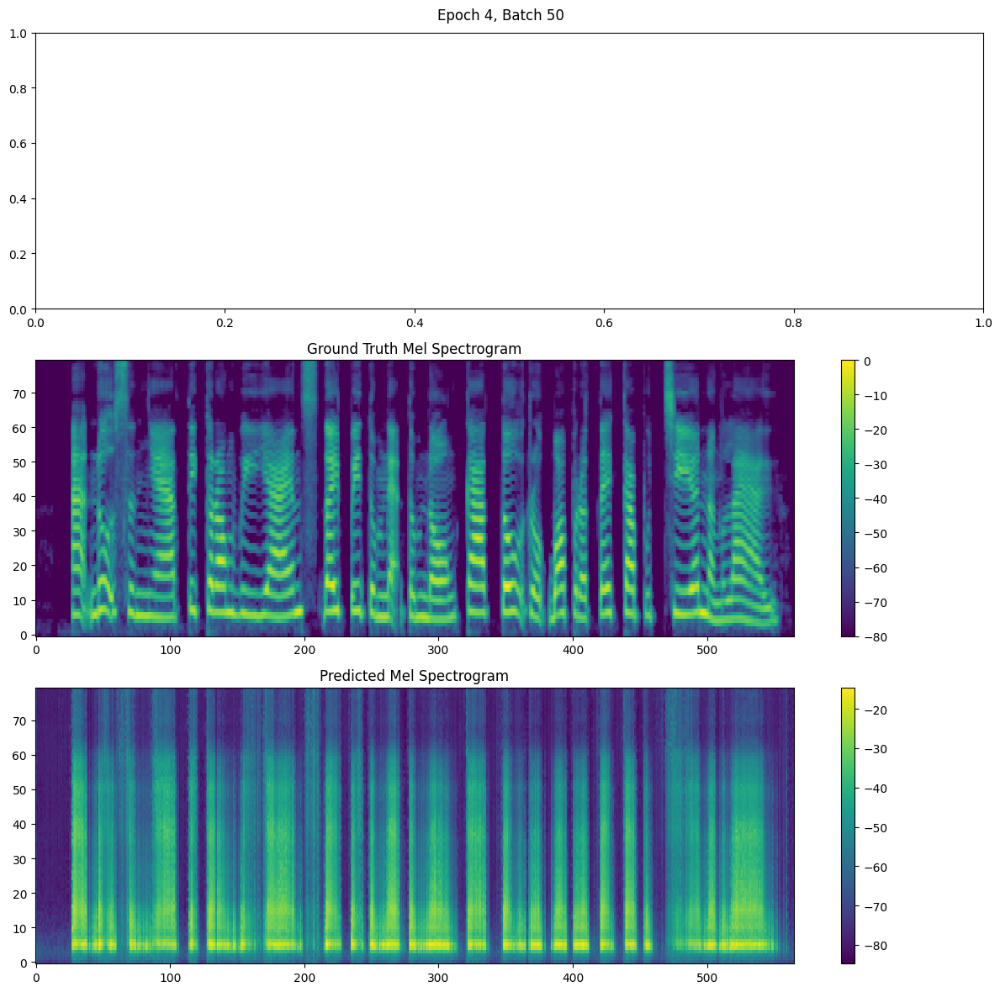

Gradient norm: 61.35531185682749
Epoch 4/20, Batch 50, Loss: 129.9005, Mel Loss: 129.8835, Gate Loss: 0.0171, LR: 0.000429
Gradient norm: 180.71349756622044
Epoch 4/20, Batch 60, Loss: 116.9800, Mel Loss: 116.9664, Gate Loss: 0.0136, LR: 0.000429
Gradient norm: 148.99998435453523
Epoch 4/20, Batch 70, Loss: 125.7213, Mel Loss: 125.7047, Gate Loss: 0.0165, LR: 0.000429
Gradient norm: 167.6201283050084
Epoch 4/20, Batch 80, Loss: 164.5107, Mel Loss: 164.4915, Gate Loss: 0.0192, LR: 0.000429
Gradient norm: 125.61101186780434
Epoch 4/20, Batch 90, Loss: 149.2767, Mel Loss: 149.2579, Gate Loss: 0.0187, LR: 0.000429


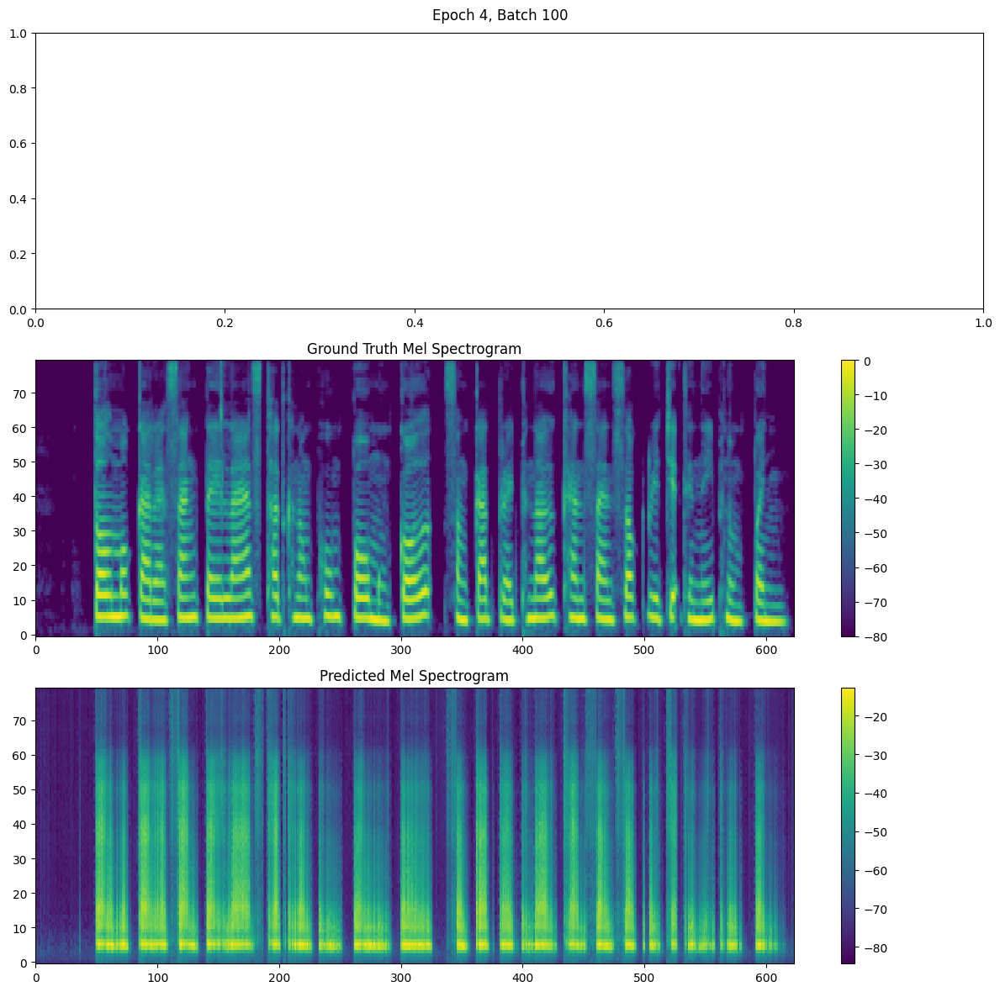

Gradient norm: 112.87009783832599
Epoch 4/20, Batch 100, Loss: 120.1694, Mel Loss: 120.1548, Gate Loss: 0.0147, LR: 0.000429
Gradient norm: 64.37366143653637
Epoch 4/20, Batch 110, Loss: 94.8564, Mel Loss: 94.8445, Gate Loss: 0.0119, LR: 0.000429
Gradient norm: 116.559300175605
Epoch 4/20, Batch 120, Loss: 157.5392, Mel Loss: 157.5189, Gate Loss: 0.0203, LR: 0.000429
Epoch 4/20, Average Loss: 124.5881


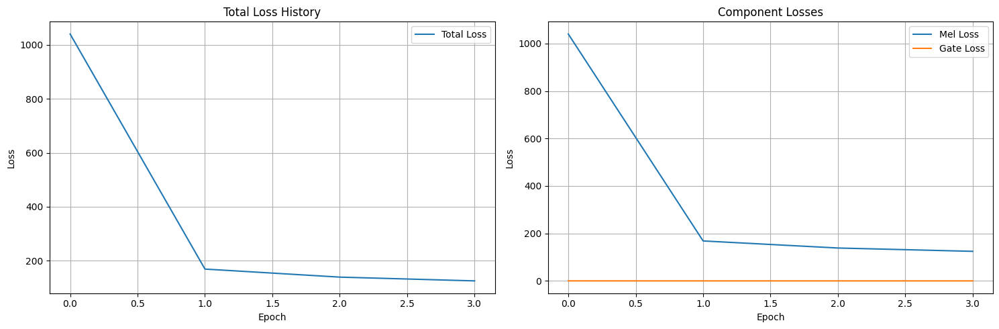

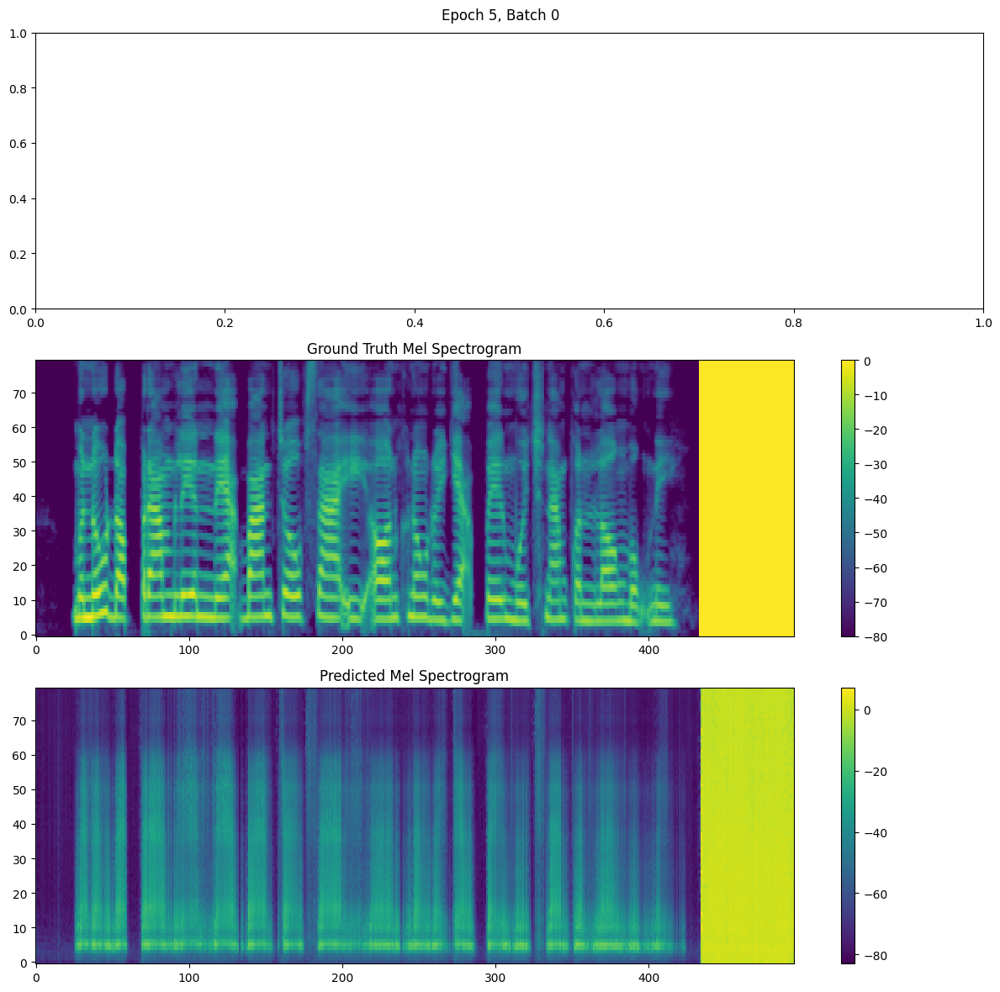

Gradient norm: 140.07510238333697
Epoch 5/20, Batch 0, Loss: 141.7547, Mel Loss: 141.7361, Gate Loss: 0.0185, LR: 0.000407
Gradient norm: 124.80198452023306
Epoch 5/20, Batch 10, Loss: 145.7207, Mel Loss: 145.7014, Gate Loss: 0.0193, LR: 0.000407
Gradient norm: 113.02907472048132
Epoch 5/20, Batch 20, Loss: 117.2636, Mel Loss: 117.2485, Gate Loss: 0.0151, LR: 0.000407
Gradient norm: 207.57868377019815
Epoch 5/20, Batch 30, Loss: 137.2306, Mel Loss: 137.2110, Gate Loss: 0.0196, LR: 0.000407
Gradient norm: 178.15884026278627
Epoch 5/20, Batch 40, Loss: 96.5368, Mel Loss: 96.5230, Gate Loss: 0.0138, LR: 0.000407


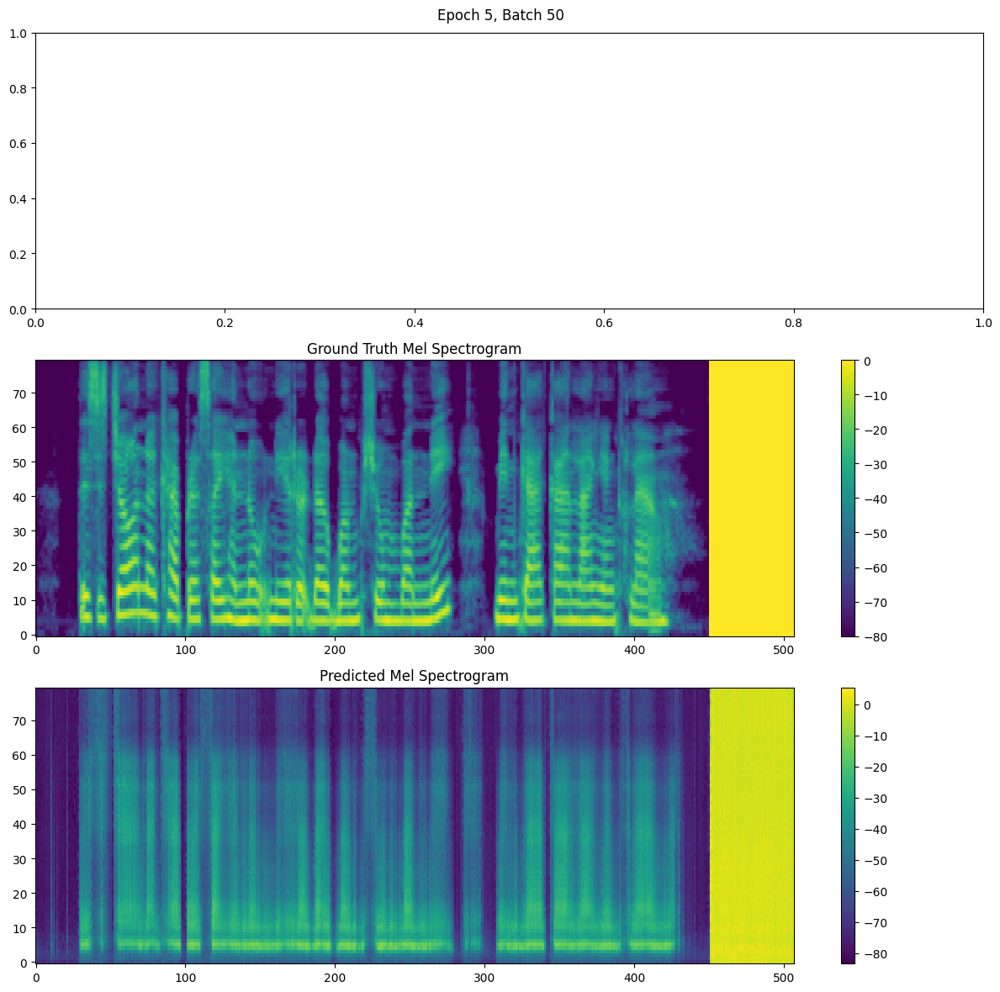

Gradient norm: 203.50330944146162
Epoch 5/20, Batch 50, Loss: 131.5837, Mel Loss: 131.5657, Gate Loss: 0.0181, LR: 0.000407
Gradient norm: 169.5587649671066
Epoch 5/20, Batch 60, Loss: 115.9666, Mel Loss: 115.9529, Gate Loss: 0.0137, LR: 0.000407
Gradient norm: 213.2110006297436
Epoch 5/20, Batch 70, Loss: 111.0173, Mel Loss: 111.0048, Gate Loss: 0.0125, LR: 0.000407
Gradient norm: 93.45580589804838
Epoch 5/20, Batch 80, Loss: 91.1351, Mel Loss: 91.1233, Gate Loss: 0.0118, LR: 0.000407
Gradient norm: 110.1371749127388
Epoch 5/20, Batch 90, Loss: 97.5880, Mel Loss: 97.5767, Gate Loss: 0.0112, LR: 0.000407


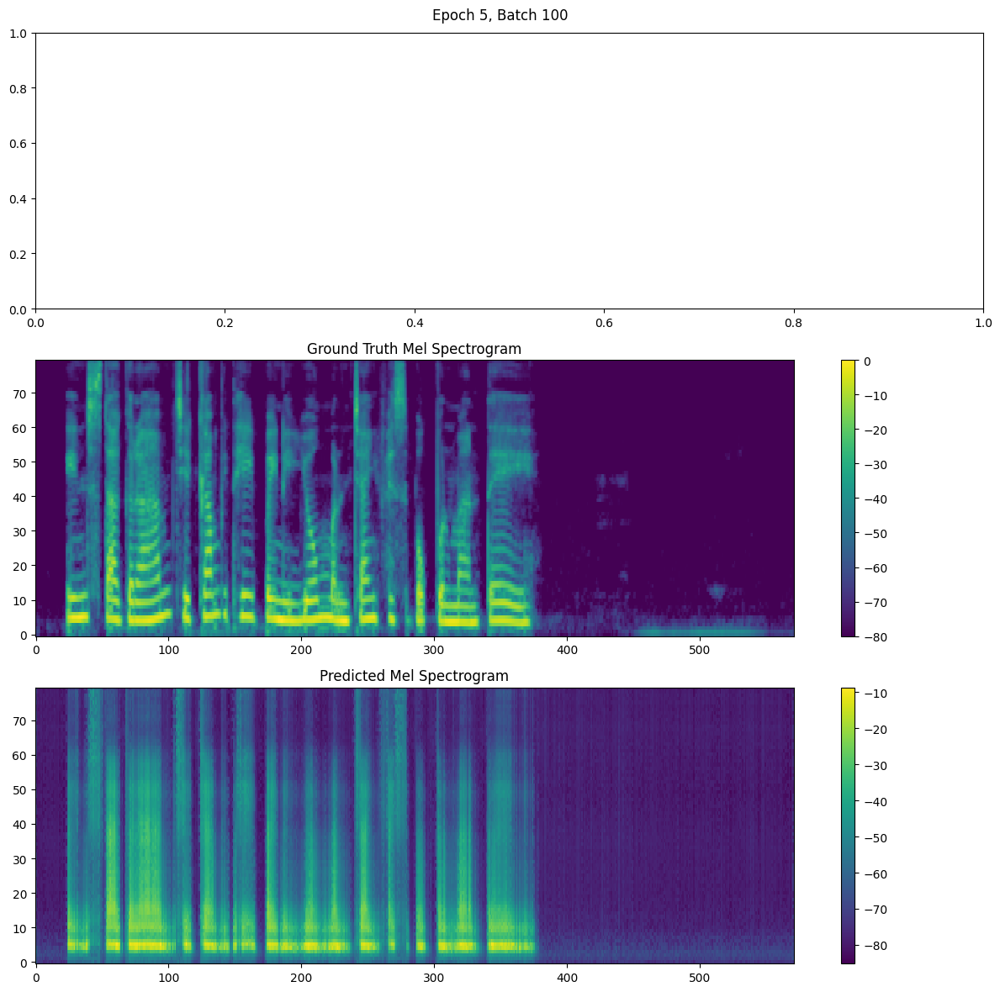

Gradient norm: 121.77183302774827
Epoch 5/20, Batch 100, Loss: 110.4176, Mel Loss: 110.4010, Gate Loss: 0.0166, LR: 0.000407
Gradient norm: 104.31512613606867
Epoch 5/20, Batch 110, Loss: 148.4397, Mel Loss: 148.4189, Gate Loss: 0.0208, LR: 0.000407
Gradient norm: 62.850173453928605
Epoch 5/20, Batch 120, Loss: 93.1509, Mel Loss: 93.1388, Gate Loss: 0.0121, LR: 0.000407
Epoch 5/20, Average Loss: 114.5567


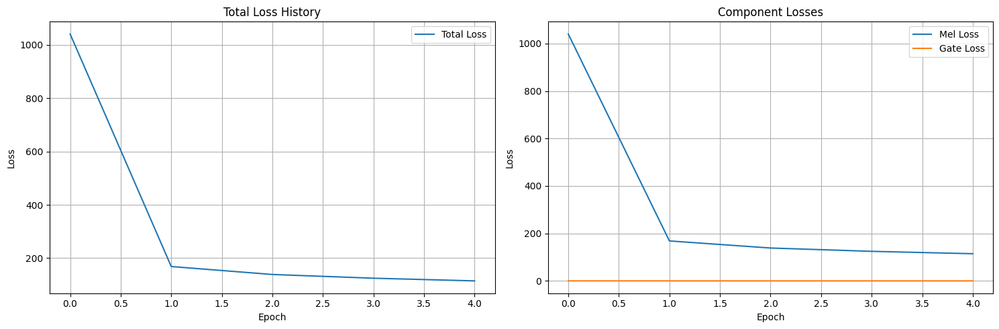

Checkpoint saved at epoch 5
Sample text shape: torch.Size([1, 80])
Sample text length: tensor([80], device='cuda:0')
Error during checkpoint generation: Tacotron2.infer() got an unexpected keyword argument 'max_decoder_steps'
Continuing training...


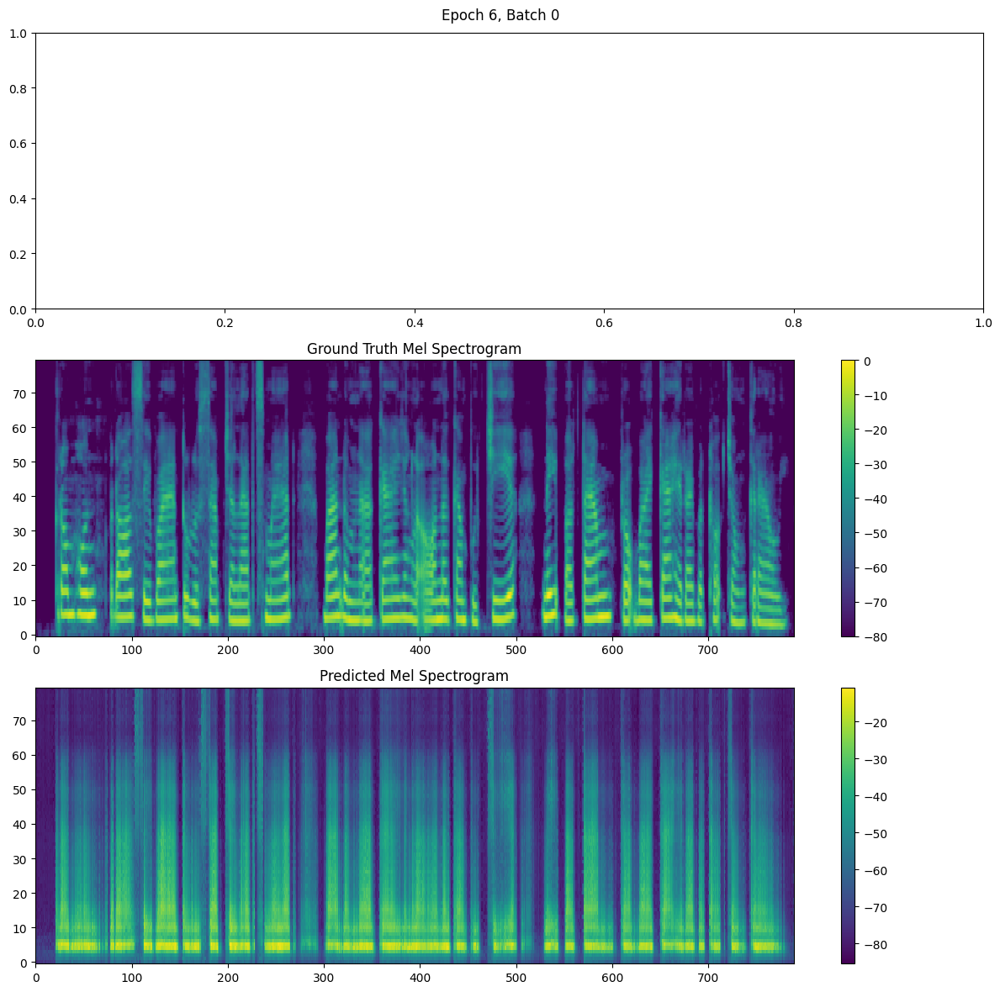

Gradient norm: 195.99648956851055
Epoch 6/20, Batch 0, Loss: 96.8309, Mel Loss: 96.8190, Gate Loss: 0.0119, LR: 0.000387
Gradient norm: 107.72936700934638
Epoch 6/20, Batch 10, Loss: 98.9509, Mel Loss: 98.9375, Gate Loss: 0.0134, LR: 0.000387
Gradient norm: 148.908391080366
Epoch 6/20, Batch 20, Loss: 101.1213, Mel Loss: 101.1068, Gate Loss: 0.0145, LR: 0.000387
Gradient norm: 60.08982708638609
Epoch 6/20, Batch 30, Loss: 117.7183, Mel Loss: 117.7029, Gate Loss: 0.0154, LR: 0.000387
Gradient norm: 57.278559008235625
Epoch 6/20, Batch 40, Loss: 88.8376, Mel Loss: 88.8272, Gate Loss: 0.0104, LR: 0.000387


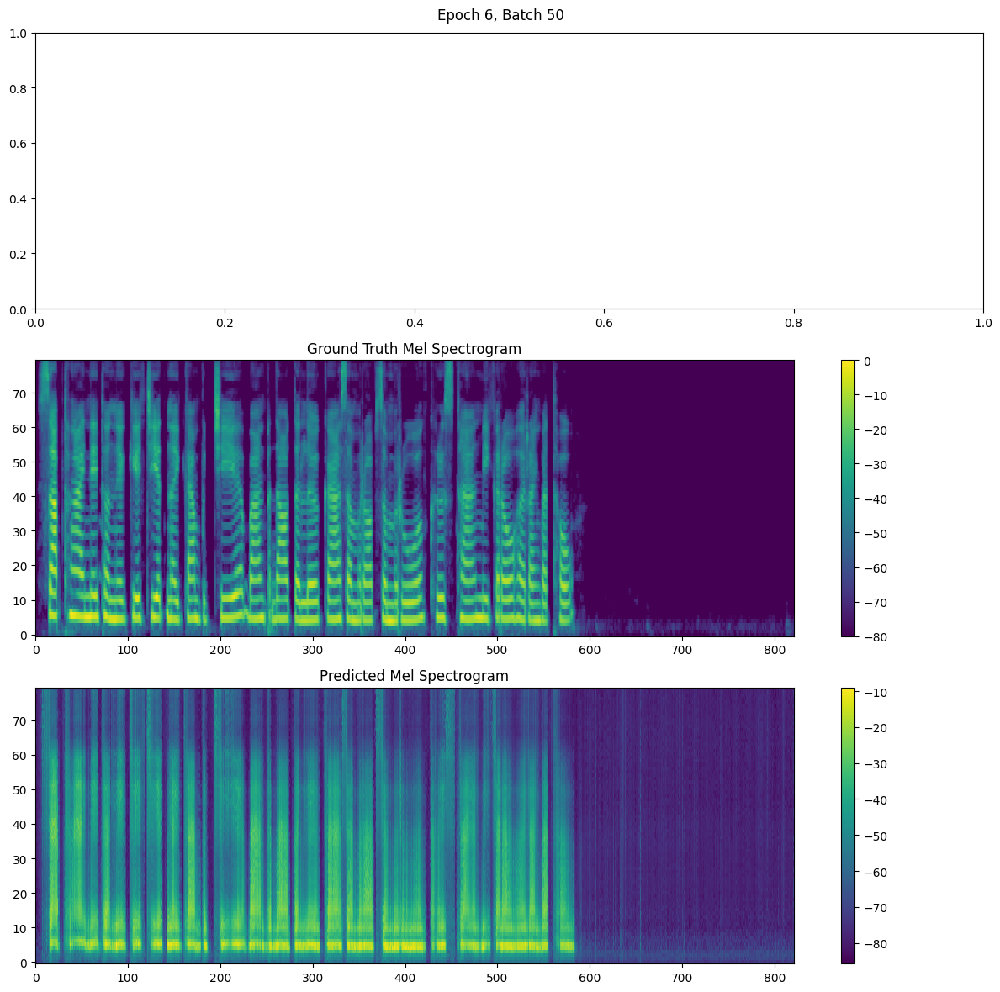

Gradient norm: 214.78733476885807
Epoch 6/20, Batch 50, Loss: 85.5542, Mel Loss: 85.5421, Gate Loss: 0.0121, LR: 0.000387
Gradient norm: 76.7860397046888
Epoch 6/20, Batch 60, Loss: 104.0818, Mel Loss: 104.0670, Gate Loss: 0.0148, LR: 0.000387
Gradient norm: 151.7182527814295
Epoch 6/20, Batch 70, Loss: 88.7169, Mel Loss: 88.7043, Gate Loss: 0.0126, LR: 0.000387
Gradient norm: 113.23350866742287
Epoch 6/20, Batch 80, Loss: 138.0961, Mel Loss: 138.0777, Gate Loss: 0.0184, LR: 0.000387
Gradient norm: 166.64271146082518
Epoch 6/20, Batch 90, Loss: 70.5184, Mel Loss: 70.5097, Gate Loss: 0.0087, LR: 0.000387


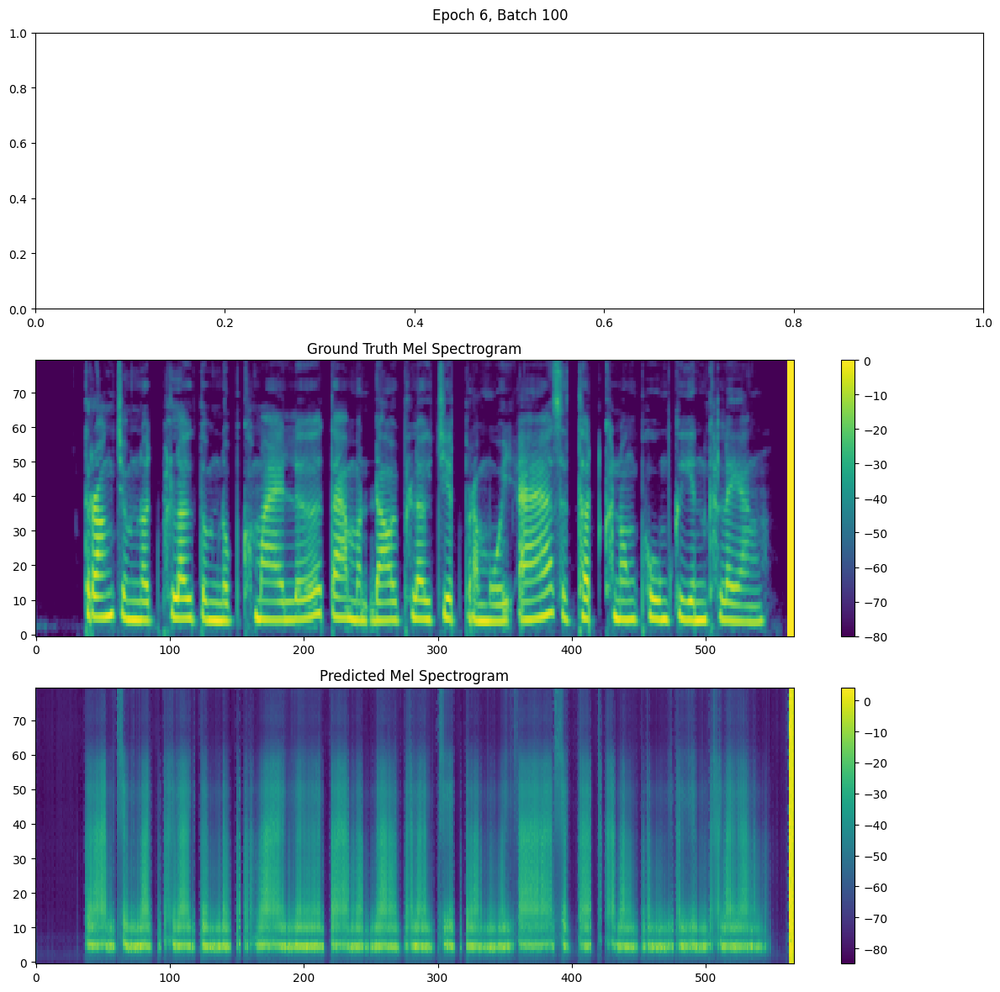

Gradient norm: 182.72375416866493
Epoch 6/20, Batch 100, Loss: 117.0829, Mel Loss: 117.0665, Gate Loss: 0.0164, LR: 0.000387
Gradient norm: 61.60237587545149
Epoch 6/20, Batch 110, Loss: 114.7593, Mel Loss: 114.7417, Gate Loss: 0.0177, LR: 0.000387
Gradient norm: 59.567440211675724
Epoch 6/20, Batch 120, Loss: 76.3251, Mel Loss: 76.3136, Gate Loss: 0.0115, LR: 0.000387
Epoch 6/20, Average Loss: 106.0671


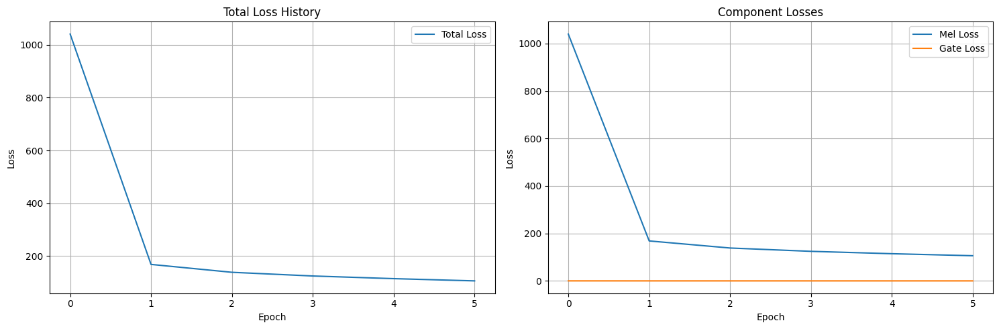

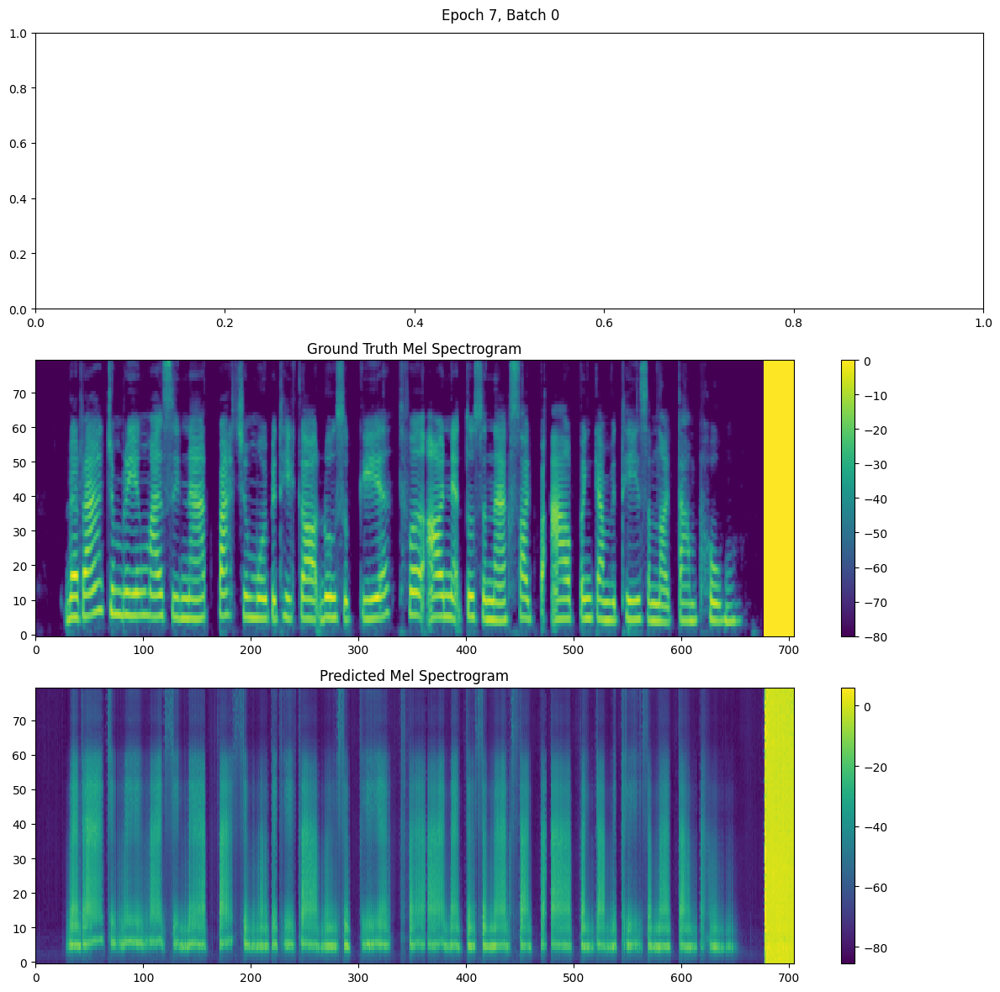

Gradient norm: 99.16391189738604
Epoch 7/20, Batch 0, Loss: 98.0615, Mel Loss: 98.0485, Gate Loss: 0.0130, LR: 0.000368
Gradient norm: 103.66630040619864
Epoch 7/20, Batch 10, Loss: 118.2106, Mel Loss: 118.1948, Gate Loss: 0.0159, LR: 0.000368
Gradient norm: 91.15125737218564
Epoch 7/20, Batch 20, Loss: 108.7531, Mel Loss: 108.7390, Gate Loss: 0.0141, LR: 0.000368
Gradient norm: 199.34838527215712
Epoch 7/20, Batch 30, Loss: 113.9005, Mel Loss: 113.8851, Gate Loss: 0.0155, LR: 0.000368
Gradient norm: 57.37313742069286
Epoch 7/20, Batch 40, Loss: 69.8274, Mel Loss: 69.8191, Gate Loss: 0.0083, LR: 0.000368


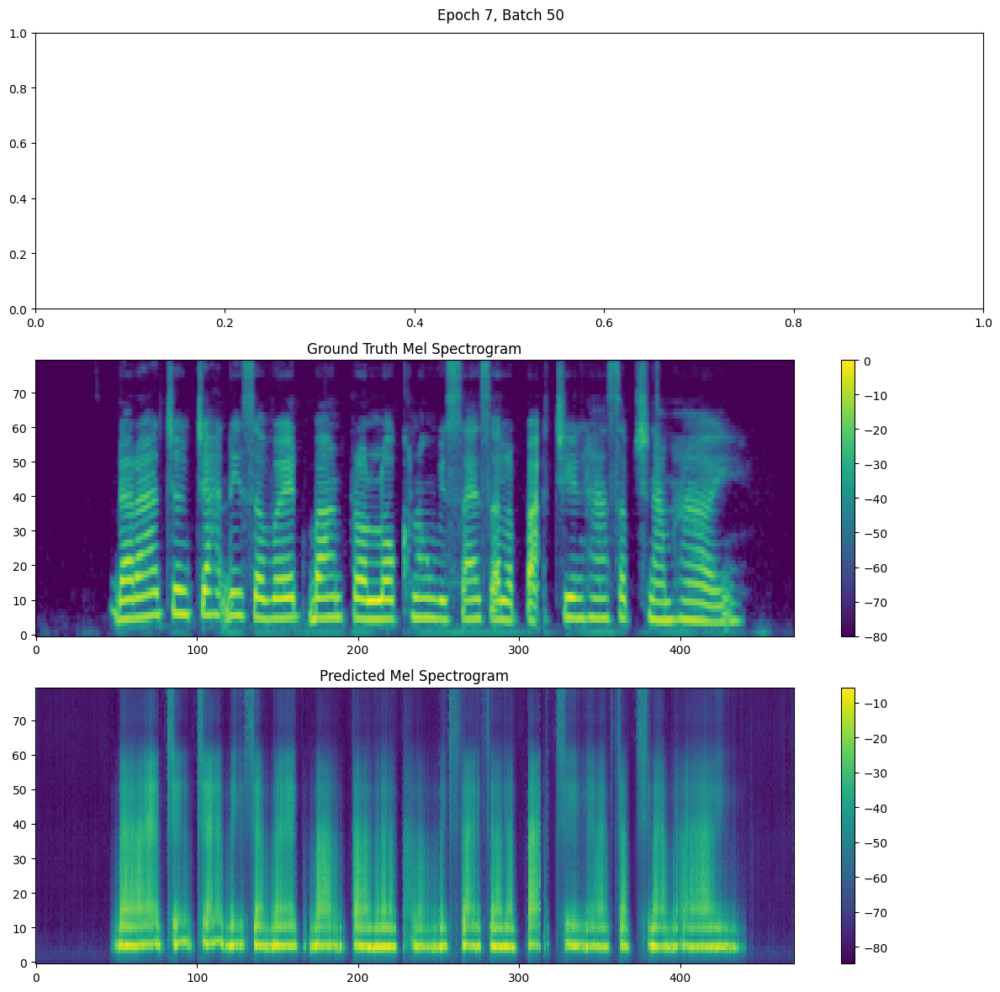

Gradient norm: 149.51635779524375
Epoch 7/20, Batch 50, Loss: 126.7814, Mel Loss: 126.7638, Gate Loss: 0.0176, LR: 0.000368
Gradient norm: 74.6861885640299
Epoch 7/20, Batch 60, Loss: 92.3013, Mel Loss: 92.2885, Gate Loss: 0.0128, LR: 0.000368
Gradient norm: 59.14234492577509
Epoch 7/20, Batch 70, Loss: 98.5553, Mel Loss: 98.5417, Gate Loss: 0.0137, LR: 0.000368
Gradient norm: 109.21477960014637
Epoch 7/20, Batch 80, Loss: 70.4878, Mel Loss: 70.4783, Gate Loss: 0.0095, LR: 0.000368
Gradient norm: 62.10963592795465
Epoch 7/20, Batch 90, Loss: 103.2606, Mel Loss: 103.2455, Gate Loss: 0.0151, LR: 0.000368


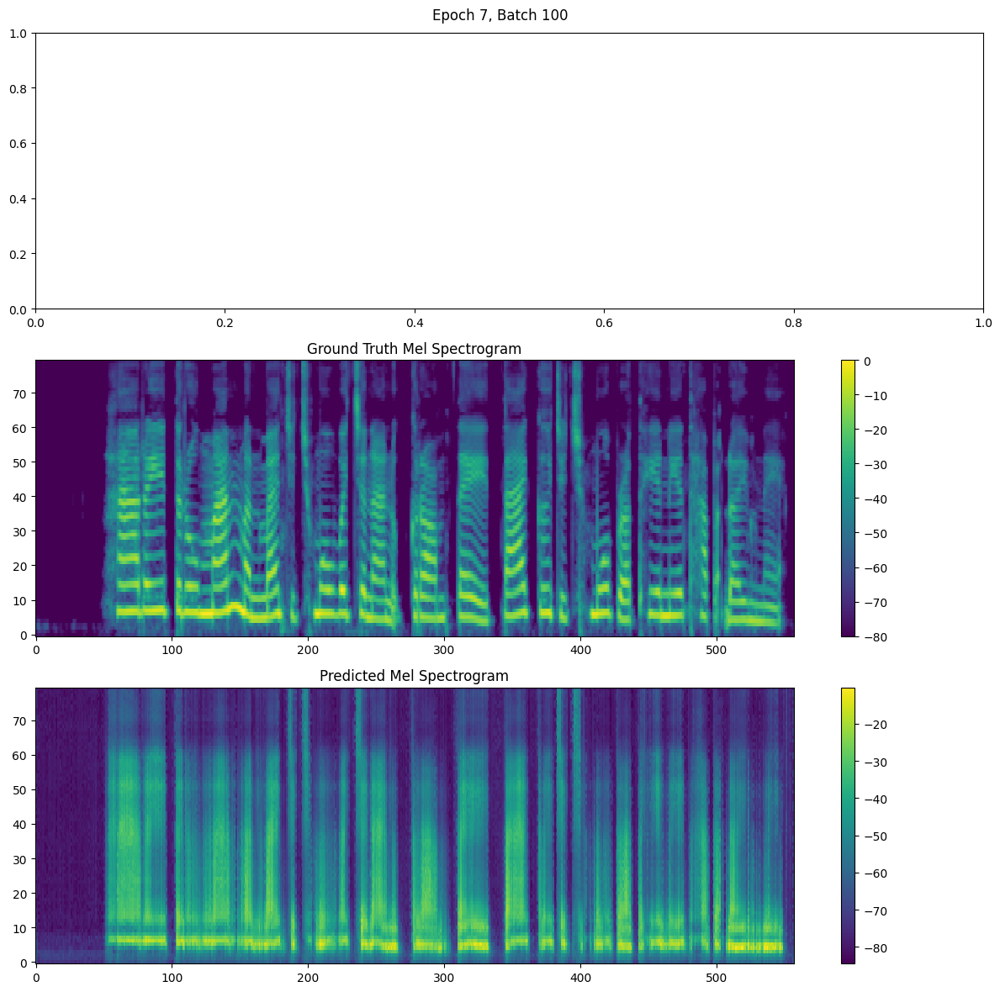

Gradient norm: 55.82897180755409
Epoch 7/20, Batch 100, Loss: 97.1925, Mel Loss: 97.1751, Gate Loss: 0.0174, LR: 0.000368
Gradient norm: 189.62402677802785
Epoch 7/20, Batch 110, Loss: 98.3574, Mel Loss: 98.3436, Gate Loss: 0.0138, LR: 0.000368
Gradient norm: 145.22337346430078
Epoch 7/20, Batch 120, Loss: 96.2356, Mel Loss: 96.2217, Gate Loss: 0.0139, LR: 0.000368
Epoch 7/20, Average Loss: 101.6509


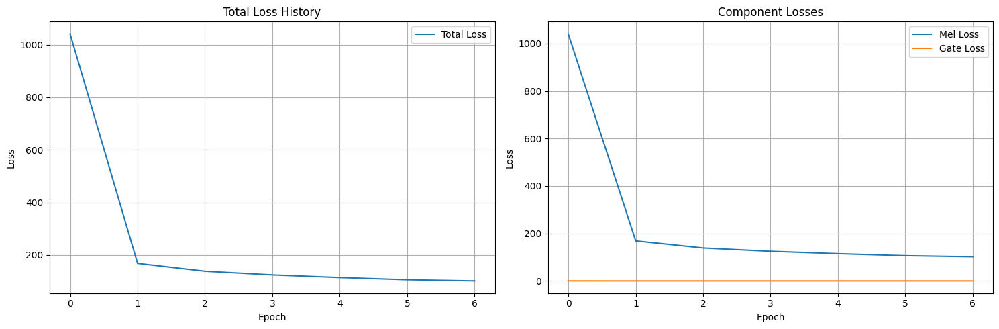

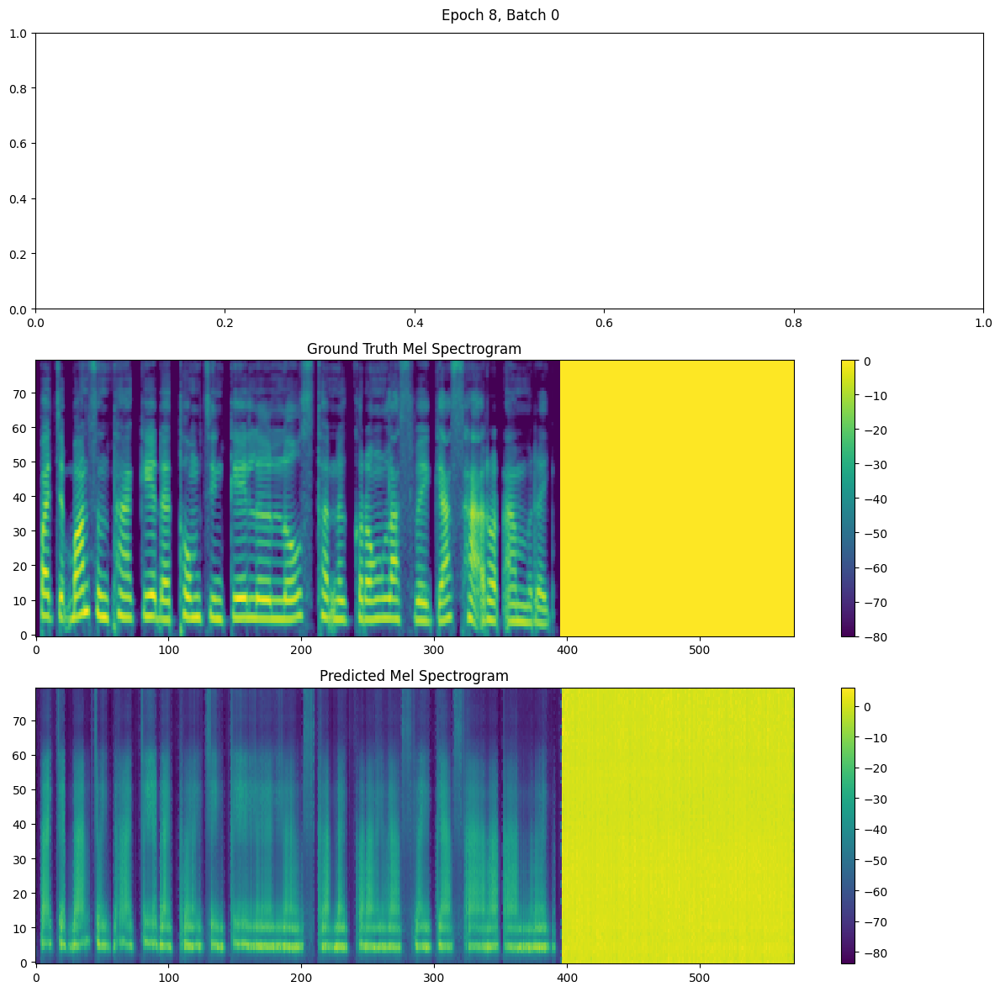

Gradient norm: 133.20801550226216
Epoch 8/20, Batch 0, Loss: 112.0818, Mel Loss: 112.0647, Gate Loss: 0.0171, LR: 0.000349
Gradient norm: 249.83184648079813
Epoch 8/20, Batch 10, Loss: 105.9562, Mel Loss: 105.9411, Gate Loss: 0.0151, LR: 0.000349
Gradient norm: 33.58805144905517
Epoch 8/20, Batch 20, Loss: 65.2572, Mel Loss: 65.2486, Gate Loss: 0.0085, LR: 0.000349
Gradient norm: 125.95177993581248
Epoch 8/20, Batch 30, Loss: 94.0258, Mel Loss: 94.0120, Gate Loss: 0.0138, LR: 0.000349
Gradient norm: 201.34397645605745
Epoch 8/20, Batch 40, Loss: 90.3742, Mel Loss: 90.3633, Gate Loss: 0.0109, LR: 0.000349


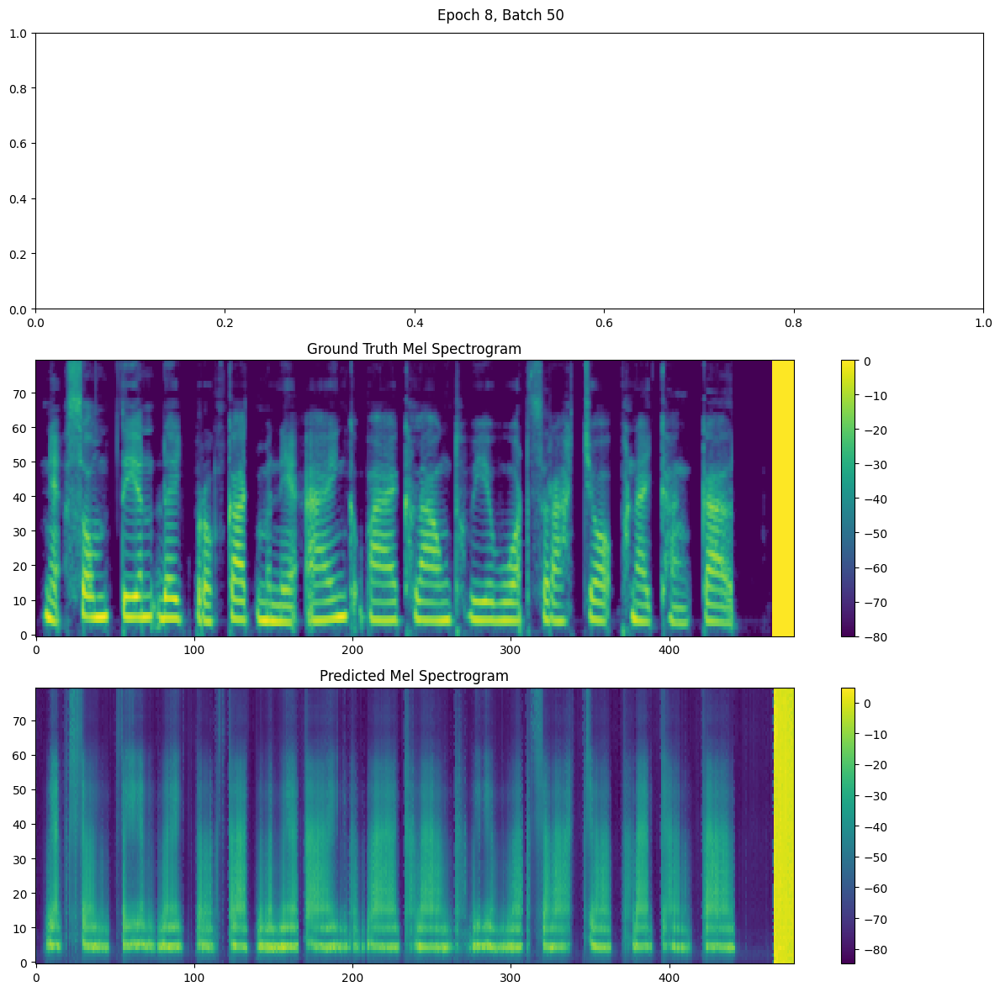

Gradient norm: 81.59673459689519
Epoch 8/20, Batch 50, Loss: 121.2648, Mel Loss: 121.2476, Gate Loss: 0.0173, LR: 0.000349
Gradient norm: 141.62903901365235
Epoch 8/20, Batch 60, Loss: 116.2909, Mel Loss: 116.2739, Gate Loss: 0.0170, LR: 0.000349
Gradient norm: 61.16939348025487
Epoch 8/20, Batch 70, Loss: 106.1717, Mel Loss: 106.1572, Gate Loss: 0.0145, LR: 0.000349
Gradient norm: 42.112451439253896
Epoch 8/20, Batch 80, Loss: 72.5843, Mel Loss: 72.5751, Gate Loss: 0.0092, LR: 0.000349
Gradient norm: 57.42979640152445
Epoch 8/20, Batch 90, Loss: 84.7913, Mel Loss: 84.7805, Gate Loss: 0.0108, LR: 0.000349


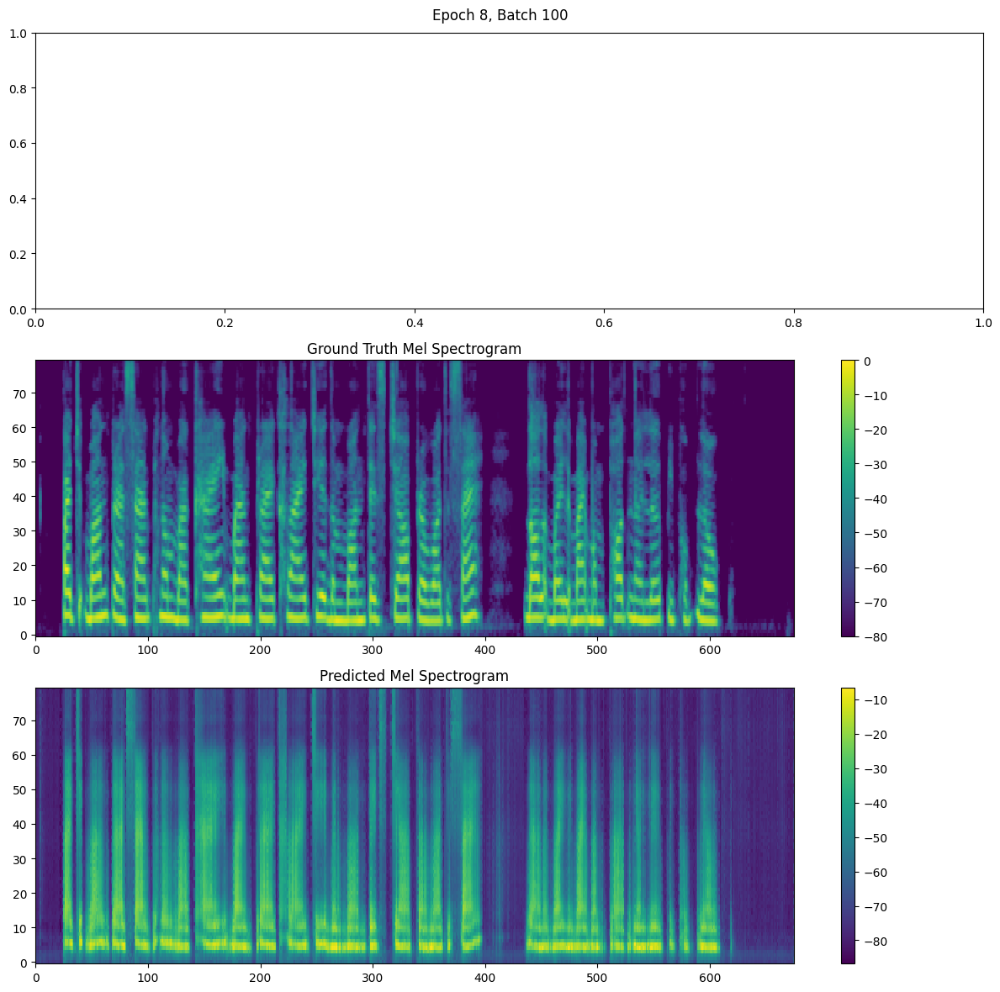

Gradient norm: 114.04776741630157
Epoch 8/20, Batch 100, Loss: 91.8409, Mel Loss: 91.8275, Gate Loss: 0.0134, LR: 0.000349
Gradient norm: 78.10001361692383
Epoch 8/20, Batch 110, Loss: 74.5827, Mel Loss: 74.5723, Gate Loss: 0.0104, LR: 0.000349
Gradient norm: 43.376372291088614
Epoch 8/20, Batch 120, Loss: 116.5499, Mel Loss: 116.5314, Gate Loss: 0.0185, LR: 0.000349
Epoch 8/20, Average Loss: 98.1702


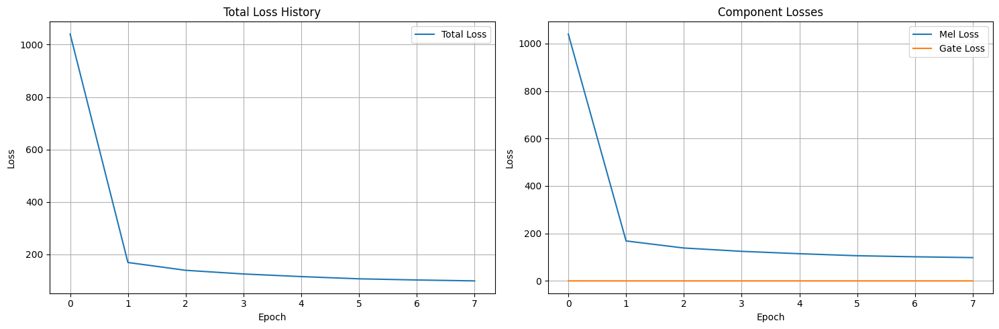

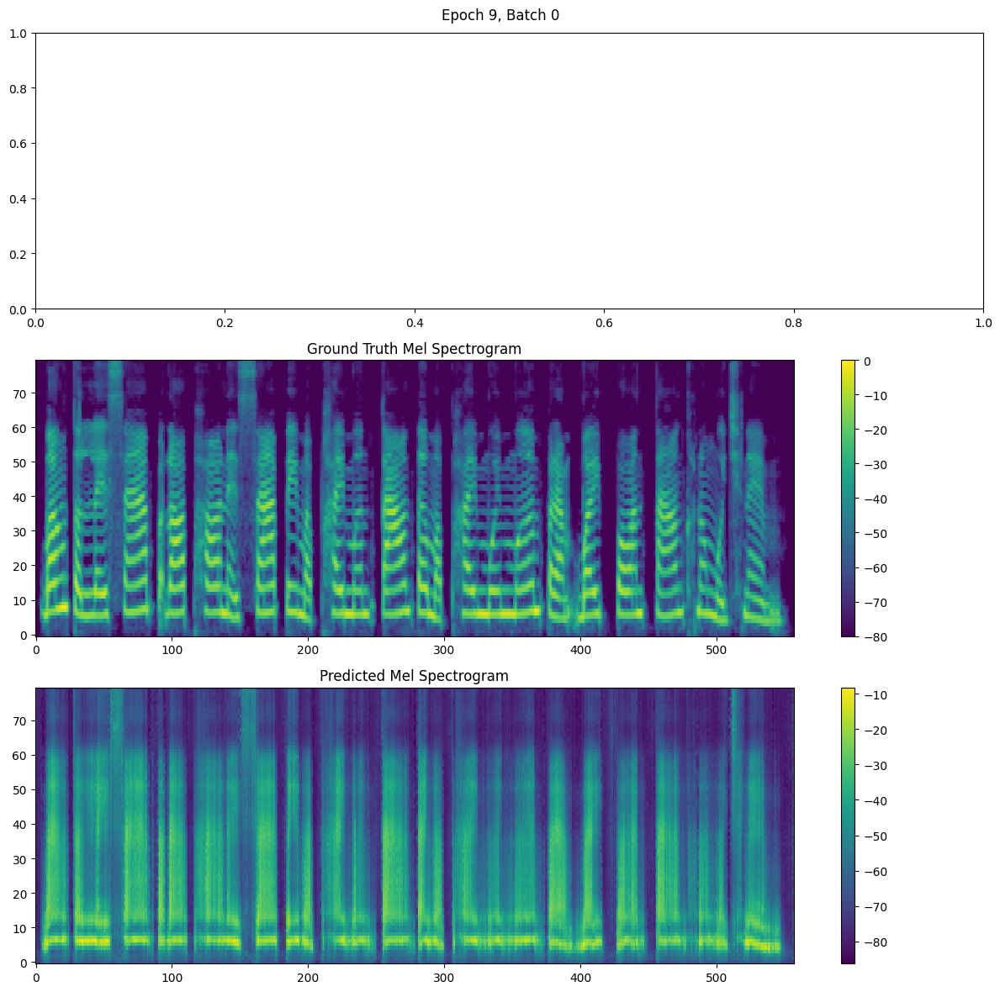

Gradient norm: 57.54305382132649
Epoch 9/20, Batch 0, Loss: 110.6248, Mel Loss: 110.6090, Gate Loss: 0.0157, LR: 0.000332
Gradient norm: 90.52906408280033
Epoch 9/20, Batch 10, Loss: 79.4865, Mel Loss: 79.4732, Gate Loss: 0.0133, LR: 0.000332
Gradient norm: 150.94819637611852
Epoch 9/20, Batch 20, Loss: 107.4179, Mel Loss: 107.4029, Gate Loss: 0.0150, LR: 0.000332
Gradient norm: 55.09668903686129
Epoch 9/20, Batch 30, Loss: 120.4570, Mel Loss: 120.4397, Gate Loss: 0.0173, LR: 0.000332
Gradient norm: 83.67428240099369
Epoch 9/20, Batch 40, Loss: 101.9898, Mel Loss: 101.9742, Gate Loss: 0.0155, LR: 0.000332


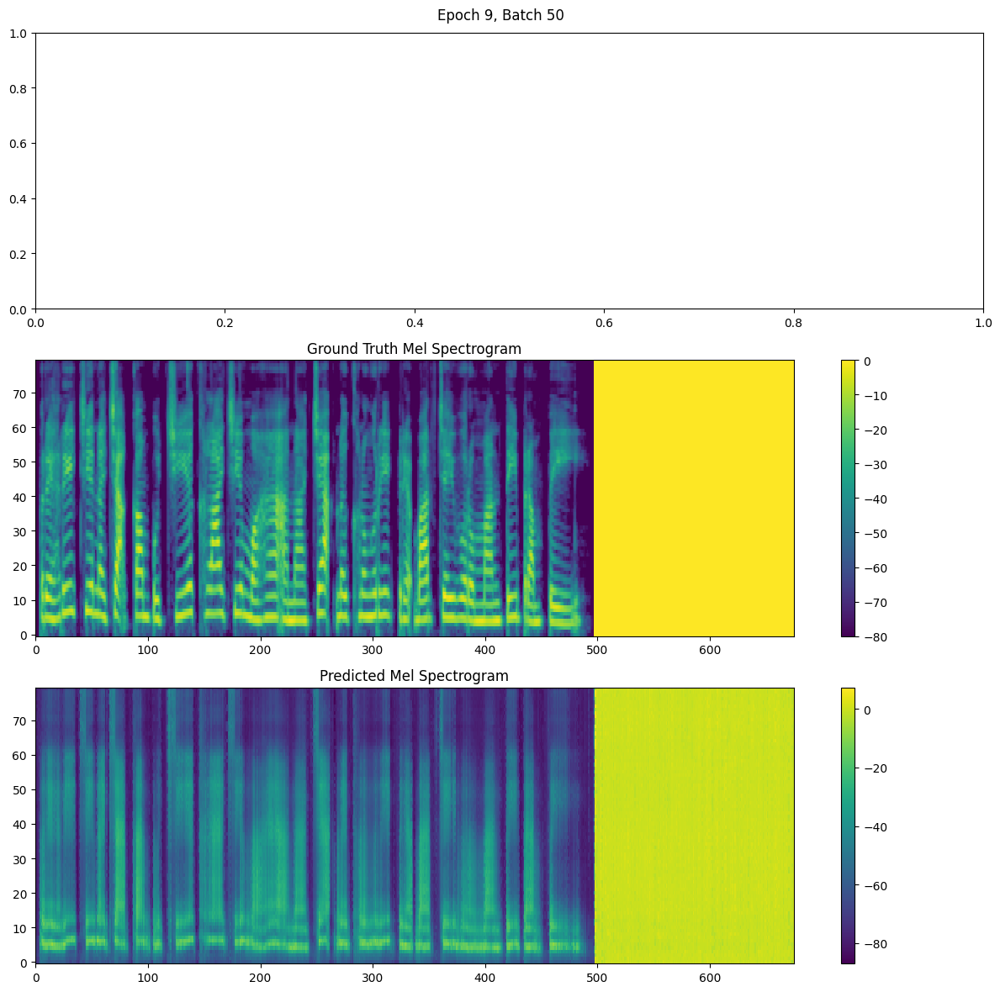

Gradient norm: 77.50843369812874
Epoch 9/20, Batch 50, Loss: 92.2528, Mel Loss: 92.2403, Gate Loss: 0.0125, LR: 0.000332
Gradient norm: 93.44249971641155
Epoch 9/20, Batch 60, Loss: 104.6338, Mel Loss: 104.6176, Gate Loss: 0.0162, LR: 0.000332
Gradient norm: 161.3661580471693
Epoch 9/20, Batch 70, Loss: 116.1030, Mel Loss: 116.0871, Gate Loss: 0.0159, LR: 0.000332
Gradient norm: 44.88157433170009
Epoch 9/20, Batch 80, Loss: 74.9660, Mel Loss: 74.9552, Gate Loss: 0.0108, LR: 0.000332
Gradient norm: 86.94600924666656
Epoch 9/20, Batch 90, Loss: 108.1460, Mel Loss: 108.1317, Gate Loss: 0.0144, LR: 0.000332


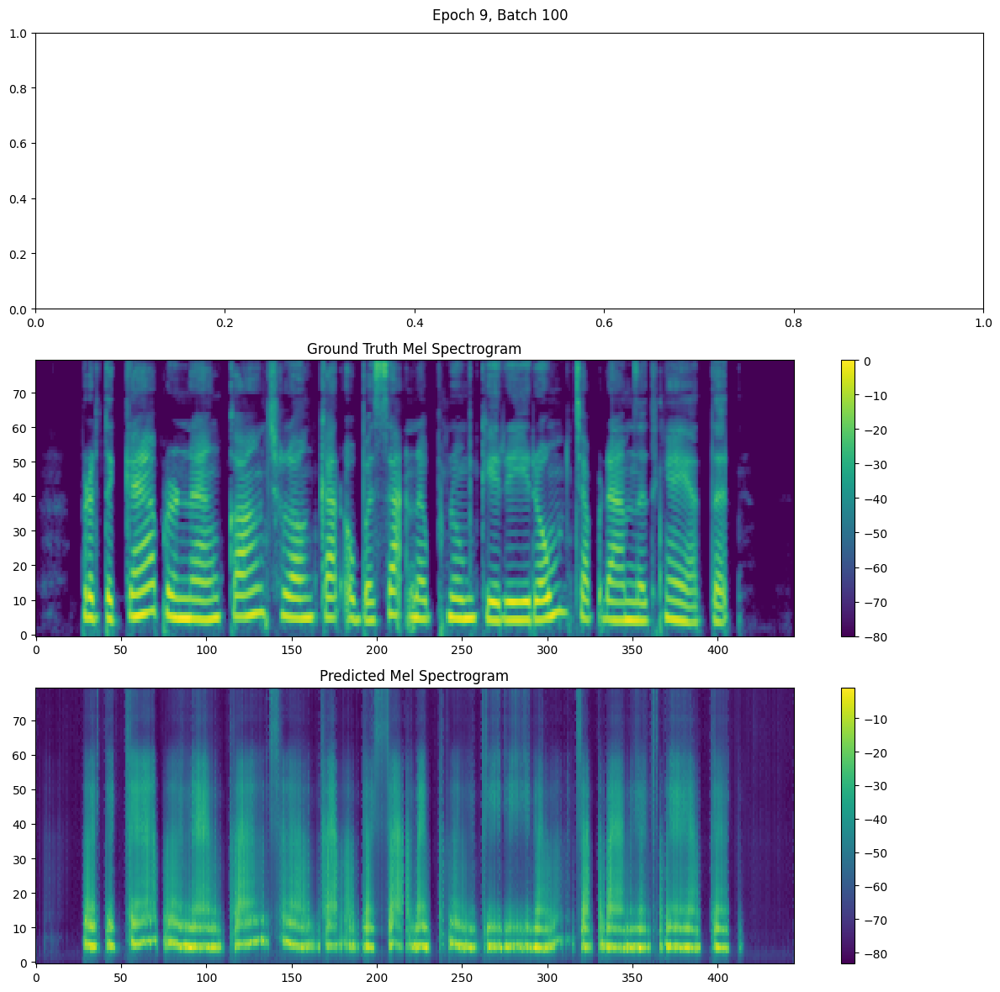

Gradient norm: 87.71545465636623
Epoch 9/20, Batch 100, Loss: 130.2080, Mel Loss: 130.1902, Gate Loss: 0.0178, LR: 0.000332
Gradient norm: 218.1413189636882
Epoch 9/20, Batch 110, Loss: 90.3797, Mel Loss: 90.3683, Gate Loss: 0.0115, LR: 0.000332
Gradient norm: 95.11433298974481
Epoch 9/20, Batch 120, Loss: 105.7662, Mel Loss: 105.7507, Gate Loss: 0.0155, LR: 0.000332
Epoch 9/20, Average Loss: 94.2148


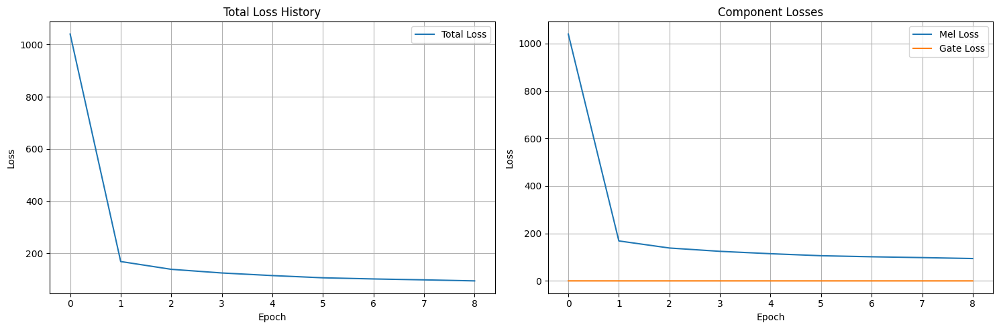

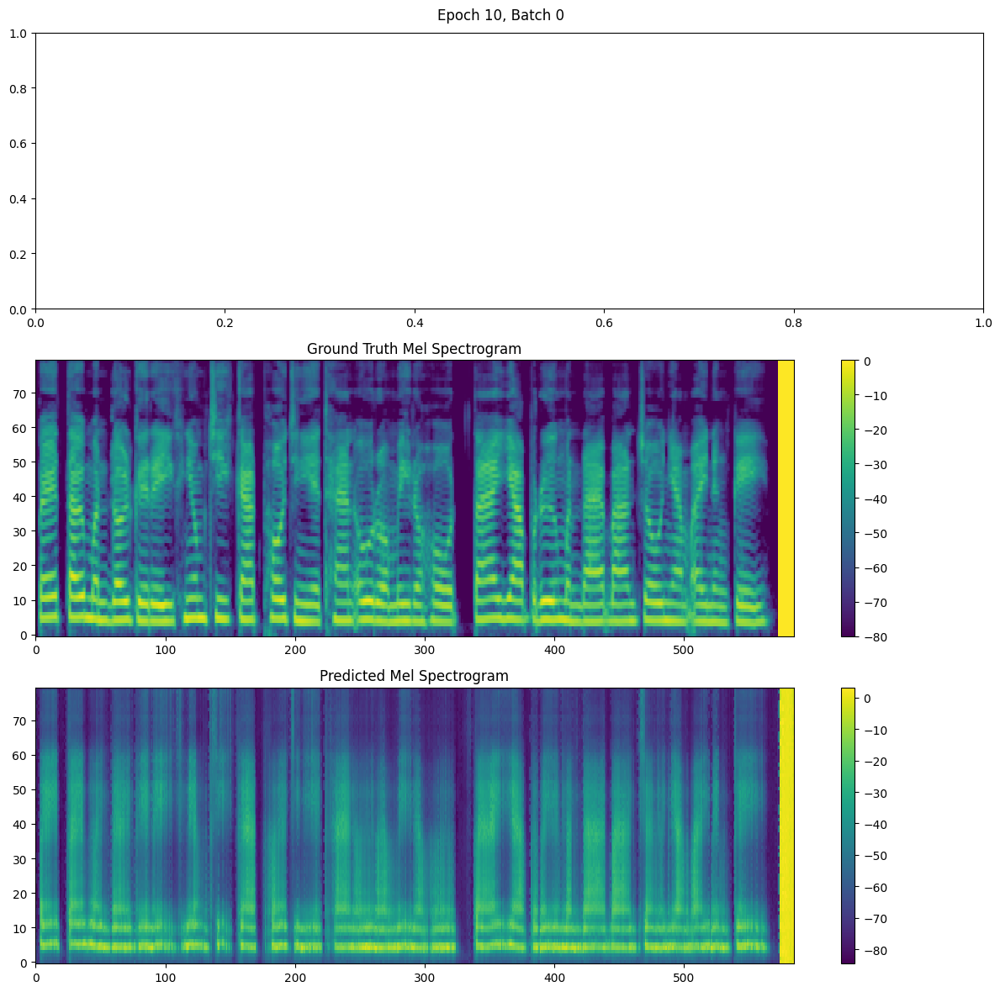

Gradient norm: 73.32615602317784
Epoch 10/20, Batch 0, Loss: 103.7831, Mel Loss: 103.7687, Gate Loss: 0.0143, LR: 0.000315
Gradient norm: 49.10564257593177
Epoch 10/20, Batch 10, Loss: 79.7399, Mel Loss: 79.7273, Gate Loss: 0.0127, LR: 0.000315
Gradient norm: 172.2600070217094
Epoch 10/20, Batch 20, Loss: 87.2079, Mel Loss: 87.1938, Gate Loss: 0.0140, LR: 0.000315
Gradient norm: 43.1551334653742
Epoch 10/20, Batch 30, Loss: 69.6287, Mel Loss: 69.6178, Gate Loss: 0.0109, LR: 0.000315
Gradient norm: 35.037117553025915
Epoch 10/20, Batch 40, Loss: 65.2641, Mel Loss: 65.2546, Gate Loss: 0.0094, LR: 0.000315


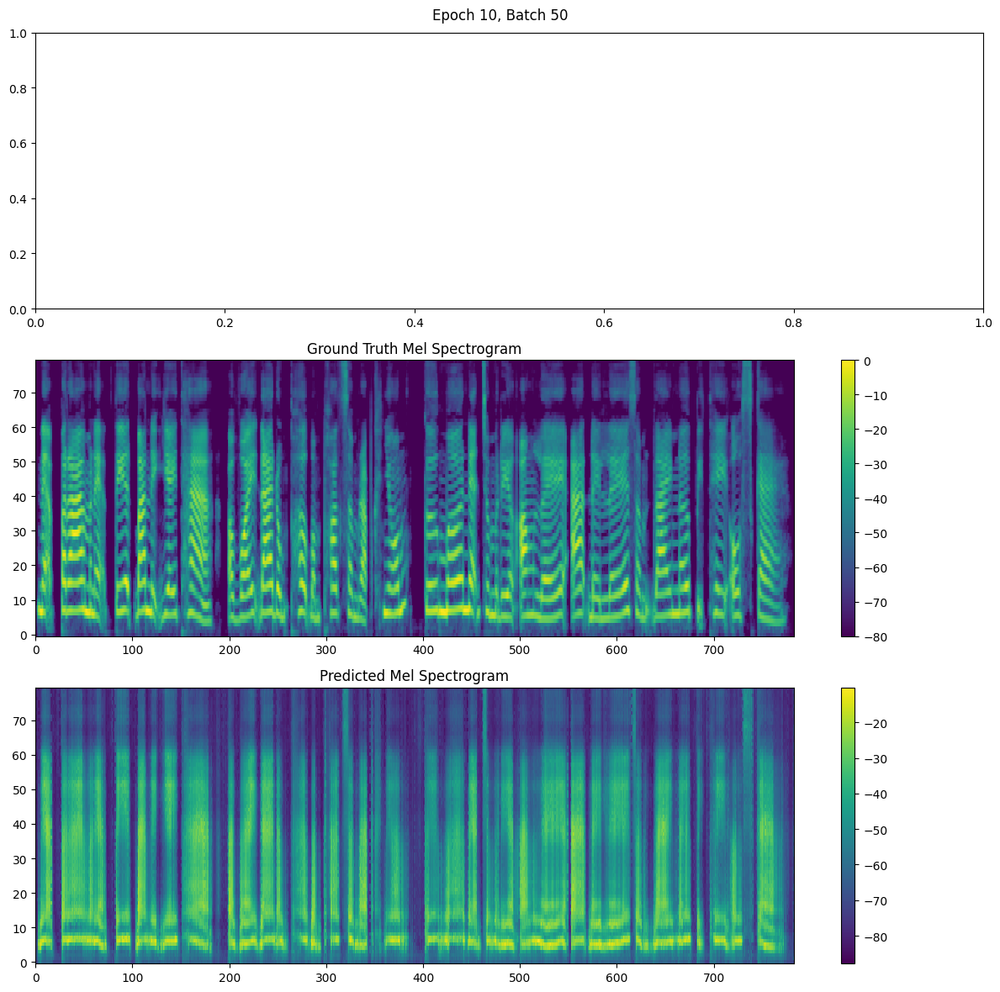

Gradient norm: 59.305858698785286
Epoch 10/20, Batch 50, Loss: 79.3911, Mel Loss: 79.3798, Gate Loss: 0.0114, LR: 0.000315
Gradient norm: 92.77020853372134
Epoch 10/20, Batch 60, Loss: 118.3414, Mel Loss: 118.3255, Gate Loss: 0.0159, LR: 0.000315
Gradient norm: 85.0163503726433
Epoch 10/20, Batch 70, Loss: 84.1547, Mel Loss: 84.1438, Gate Loss: 0.0108, LR: 0.000315
Gradient norm: 164.74935693235682
Epoch 10/20, Batch 80, Loss: 85.5071, Mel Loss: 85.4962, Gate Loss: 0.0110, LR: 0.000315
Gradient norm: 61.11789329788385
Epoch 10/20, Batch 90, Loss: 85.2107, Mel Loss: 85.1994, Gate Loss: 0.0113, LR: 0.000315


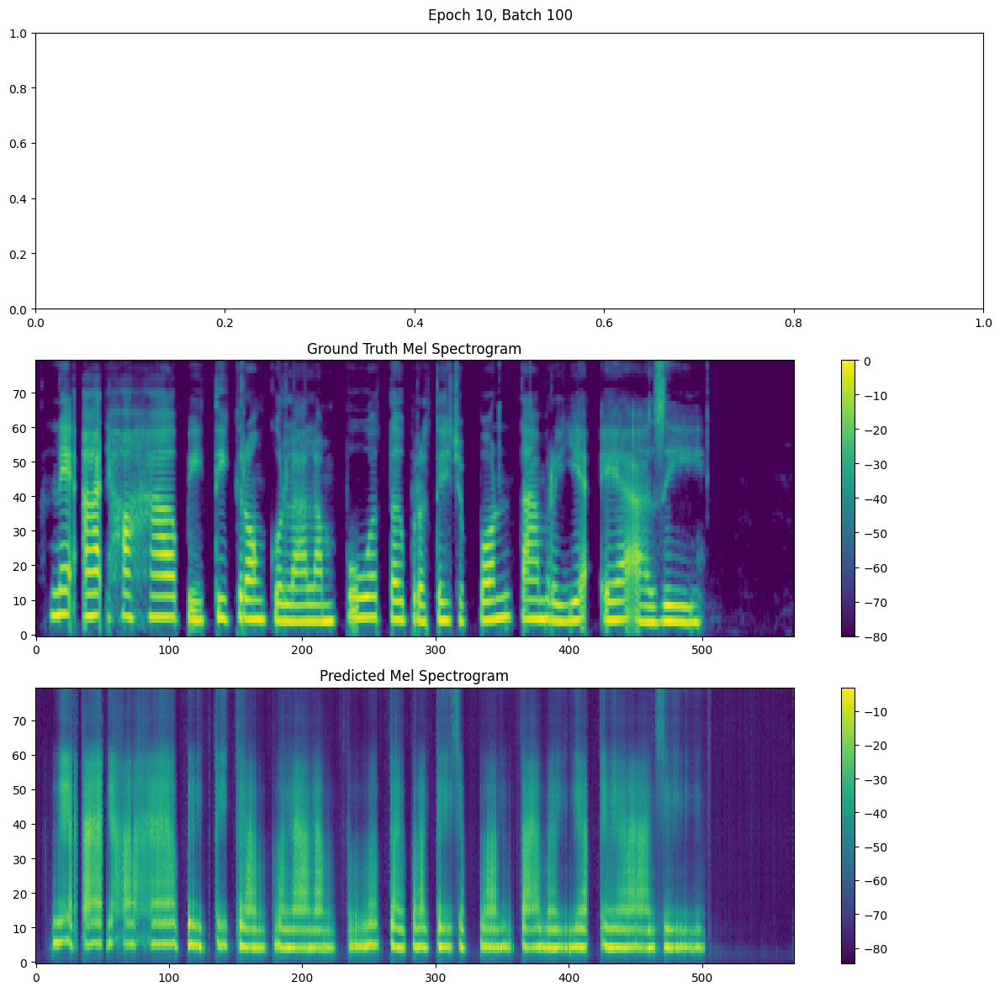

Gradient norm: 53.36175692362381
Epoch 10/20, Batch 100, Loss: 100.1302, Mel Loss: 100.1151, Gate Loss: 0.0151, LR: 0.000315
Gradient norm: 127.11677001378384
Epoch 10/20, Batch 110, Loss: 108.6403, Mel Loss: 108.6229, Gate Loss: 0.0174, LR: 0.000315
Gradient norm: 57.934000545226546
Epoch 10/20, Batch 120, Loss: 106.6468, Mel Loss: 106.6321, Gate Loss: 0.0148, LR: 0.000315
Epoch 10/20, Average Loss: 91.0765


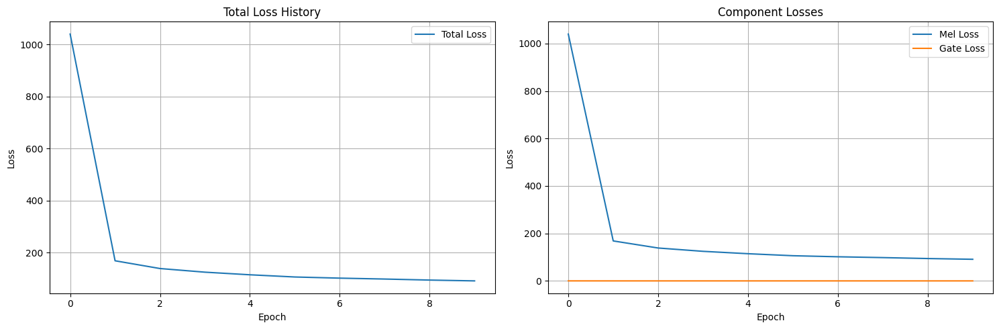

Checkpoint saved at epoch 10
Sample text shape: torch.Size([1, 48])
Sample text length: tensor([48], device='cuda:0')
Error during checkpoint generation: Tacotron2.infer() got an unexpected keyword argument 'max_decoder_steps'
Continuing training...


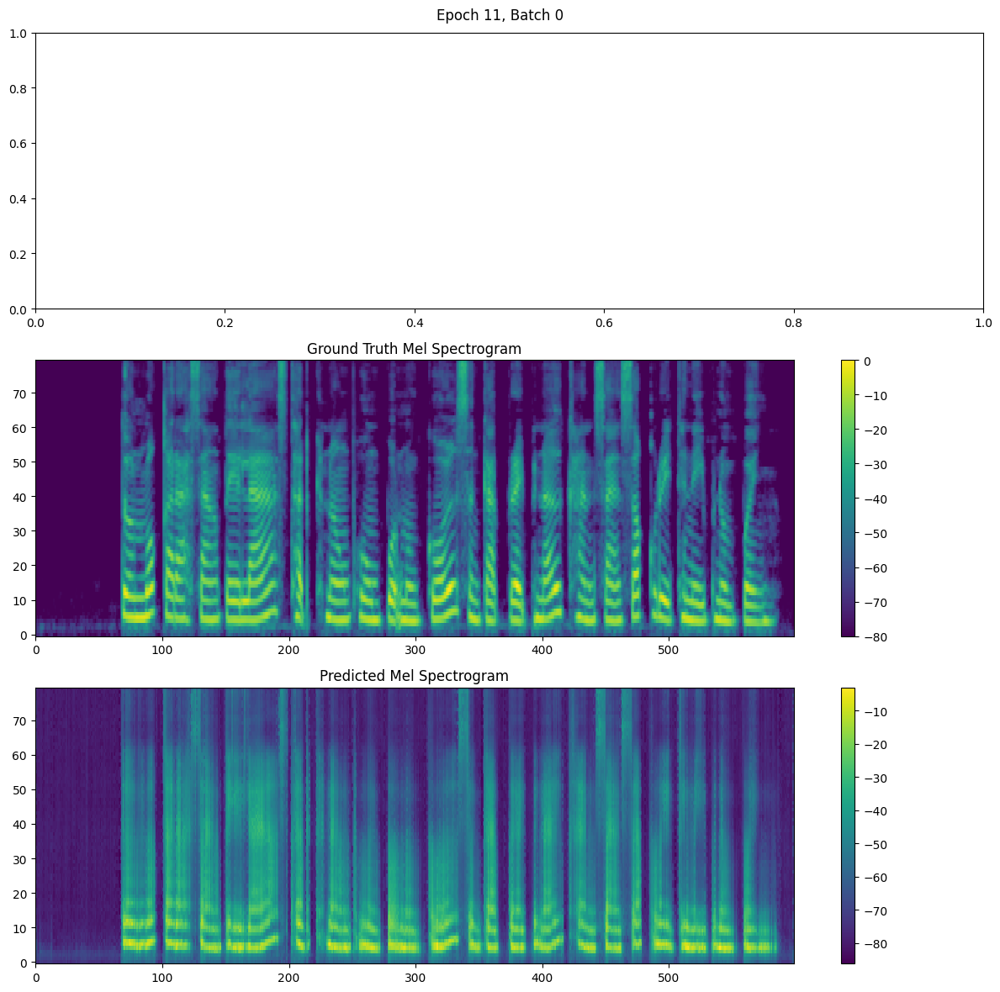

Gradient norm: 184.77793011452354
Epoch 11/20, Batch 0, Loss: 94.1480, Mel Loss: 94.1341, Gate Loss: 0.0139, LR: 0.000299
Gradient norm: 116.33754186224047
Epoch 11/20, Batch 10, Loss: 80.5665, Mel Loss: 80.5550, Gate Loss: 0.0115, LR: 0.000299
Gradient norm: 57.064716619140114
Epoch 11/20, Batch 20, Loss: 67.6957, Mel Loss: 67.6864, Gate Loss: 0.0093, LR: 0.000299
Gradient norm: 61.6108070433465
Epoch 11/20, Batch 30, Loss: 78.0851, Mel Loss: 78.0739, Gate Loss: 0.0112, LR: 0.000299
Gradient norm: 49.047715836052
Epoch 11/20, Batch 40, Loss: 91.7492, Mel Loss: 91.7360, Gate Loss: 0.0132, LR: 0.000299


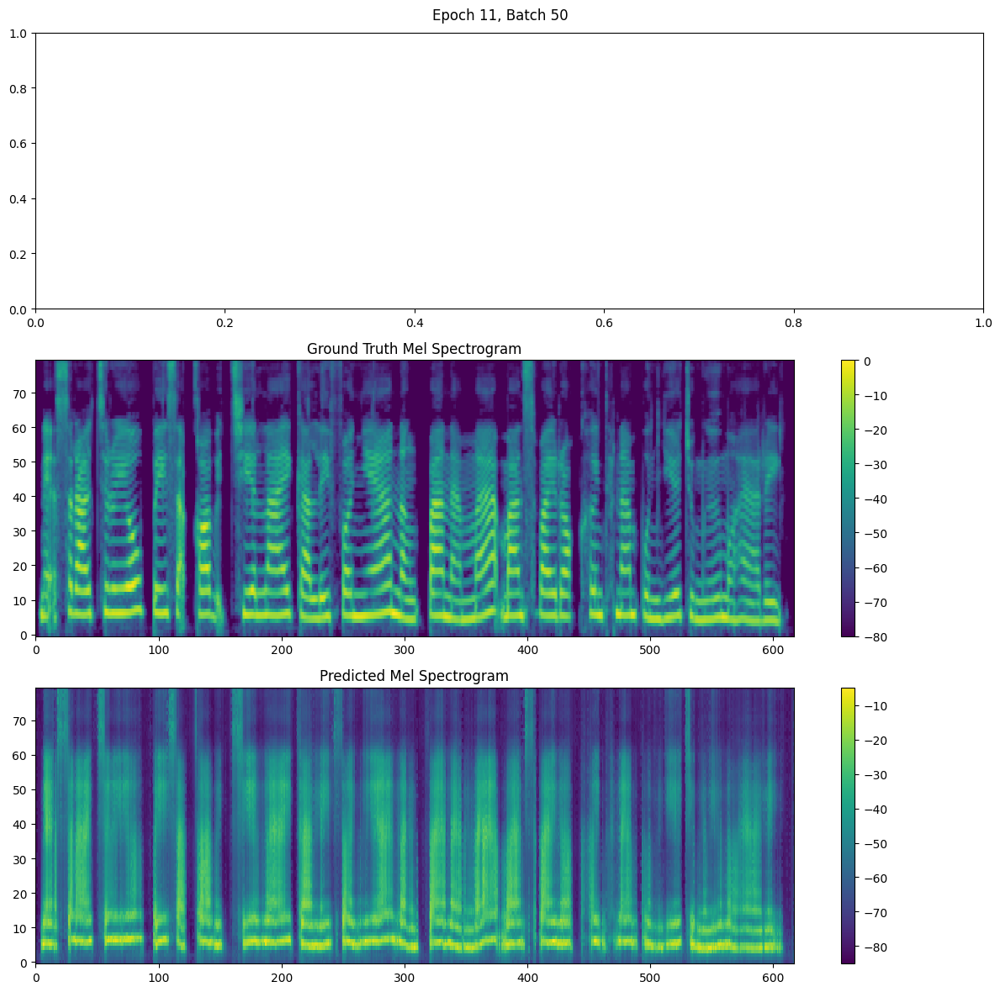

Gradient norm: 122.51283376529241
Epoch 11/20, Batch 50, Loss: 85.0712, Mel Loss: 85.0585, Gate Loss: 0.0127, LR: 0.000299
Gradient norm: 107.25964108080916
Epoch 11/20, Batch 60, Loss: 103.0132, Mel Loss: 102.9987, Gate Loss: 0.0145, LR: 0.000299
Gradient norm: 144.62390514631844
Epoch 11/20, Batch 70, Loss: 92.0818, Mel Loss: 92.0692, Gate Loss: 0.0126, LR: 0.000299
Gradient norm: 76.44956365110876
Epoch 11/20, Batch 80, Loss: 97.5869, Mel Loss: 97.5731, Gate Loss: 0.0138, LR: 0.000299
Gradient norm: 216.22936666361738
Epoch 11/20, Batch 90, Loss: 90.1315, Mel Loss: 90.1191, Gate Loss: 0.0124, LR: 0.000299


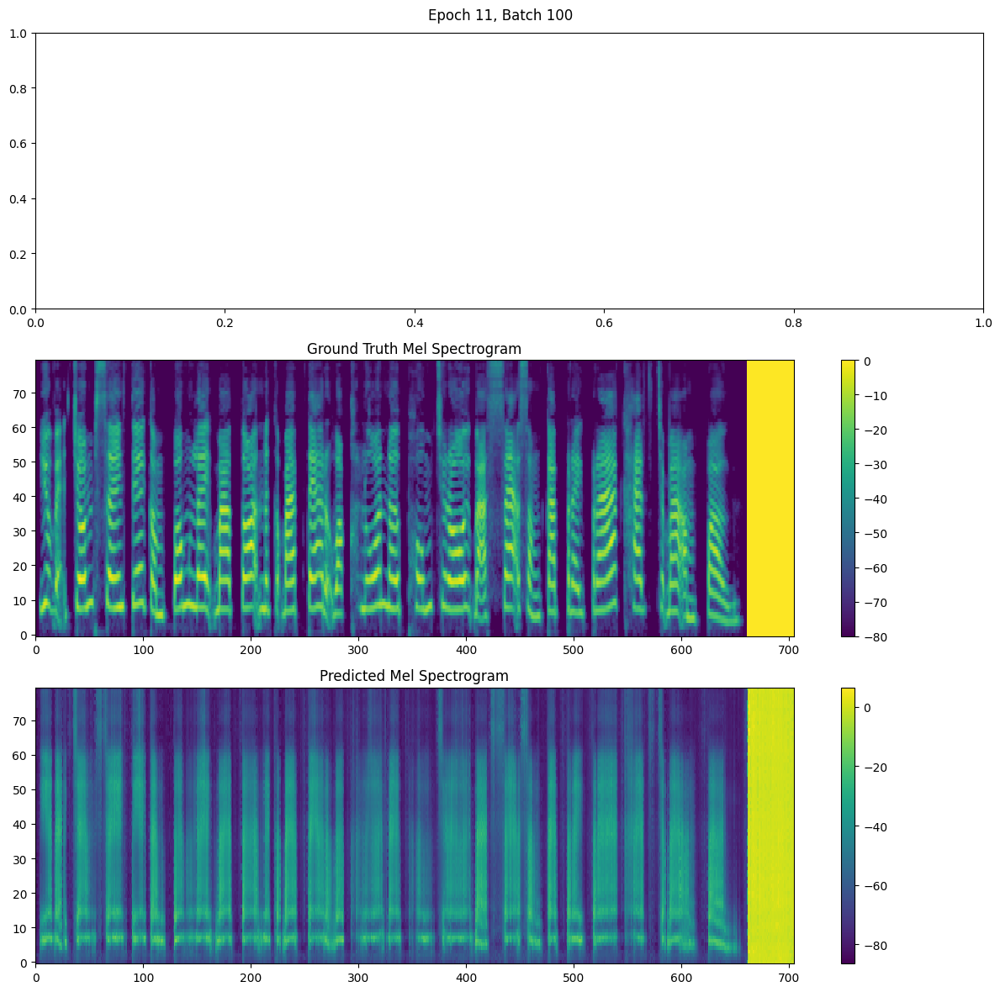

Gradient norm: 52.65063661839816
Epoch 11/20, Batch 100, Loss: 88.8579, Mel Loss: 88.8479, Gate Loss: 0.0101, LR: 0.000299
Gradient norm: 179.18262812406778
Epoch 11/20, Batch 110, Loss: 100.0622, Mel Loss: 100.0486, Gate Loss: 0.0136, LR: 0.000299
Gradient norm: 163.96373388406306
Epoch 11/20, Batch 120, Loss: 86.8927, Mel Loss: 86.8814, Gate Loss: 0.0113, LR: 0.000299
Epoch 11/20, Average Loss: 88.1876


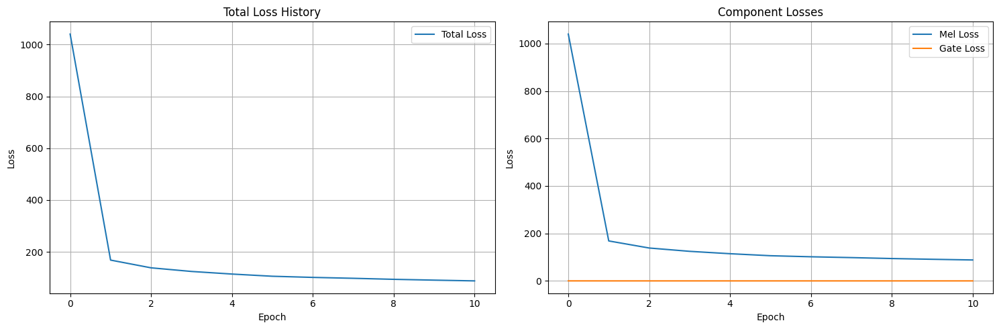

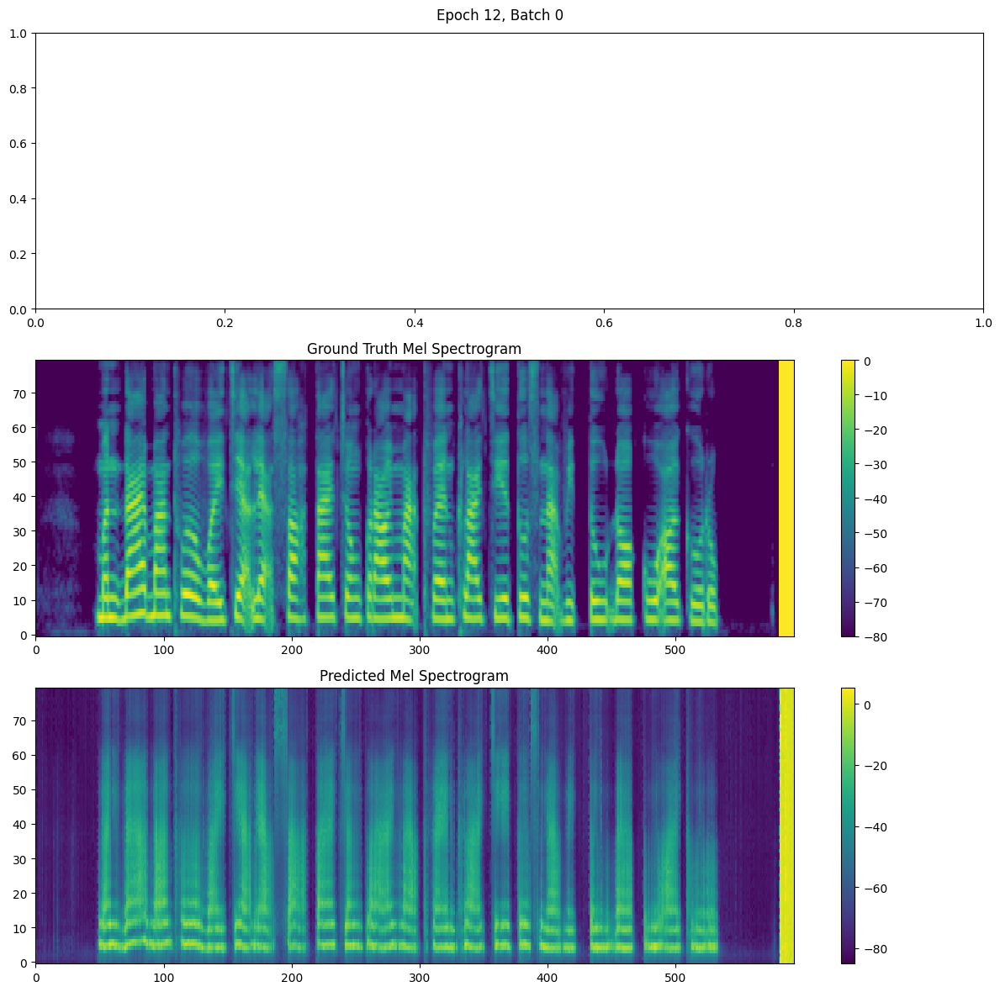

Gradient norm: 84.80058941969837
Epoch 12/20, Batch 0, Loss: 92.3618, Mel Loss: 92.3489, Gate Loss: 0.0129, LR: 0.000284
Gradient norm: 57.431507132511484
Epoch 12/20, Batch 10, Loss: 98.5989, Mel Loss: 98.5858, Gate Loss: 0.0132, LR: 0.000284
Gradient norm: 237.76335754682262
Epoch 12/20, Batch 20, Loss: 85.8107, Mel Loss: 85.7989, Gate Loss: 0.0118, LR: 0.000284
Gradient norm: 99.26621952057752
Epoch 12/20, Batch 30, Loss: 75.6305, Mel Loss: 75.6199, Gate Loss: 0.0106, LR: 0.000284
Gradient norm: 116.76286508107239
Epoch 12/20, Batch 40, Loss: 88.0285, Mel Loss: 88.0165, Gate Loss: 0.0120, LR: 0.000284


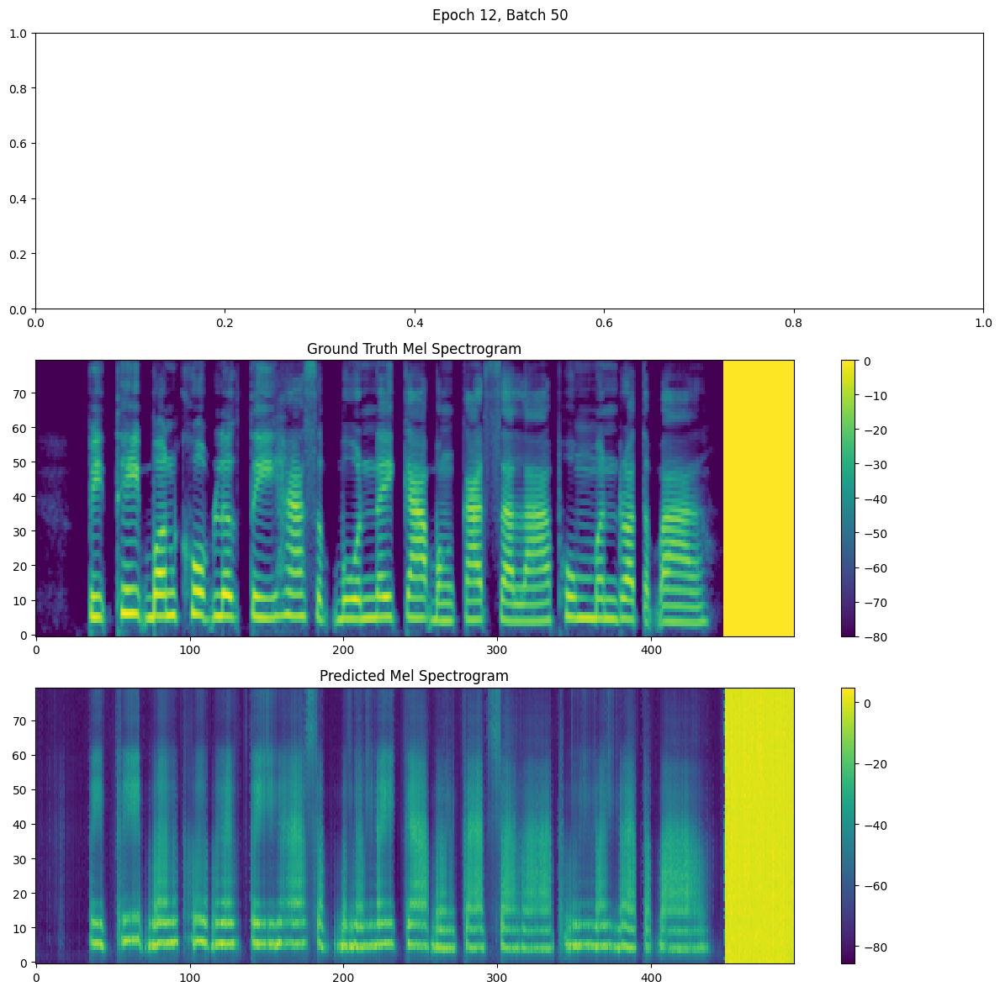

Gradient norm: 70.06455273222089
Epoch 12/20, Batch 50, Loss: 101.1902, Mel Loss: 101.1745, Gate Loss: 0.0158, LR: 0.000284
Gradient norm: 38.69366027765474
Epoch 12/20, Batch 60, Loss: 74.7886, Mel Loss: 74.7792, Gate Loss: 0.0094, LR: 0.000284
Gradient norm: 104.49970592789676
Epoch 12/20, Batch 70, Loss: 99.4147, Mel Loss: 99.3991, Gate Loss: 0.0156, LR: 0.000284
Gradient norm: 63.81859792746726
Epoch 12/20, Batch 80, Loss: 81.9806, Mel Loss: 81.9697, Gate Loss: 0.0108, LR: 0.000284
Gradient norm: 53.2904386454118
Epoch 12/20, Batch 90, Loss: 58.0440, Mel Loss: 58.0361, Gate Loss: 0.0079, LR: 0.000284


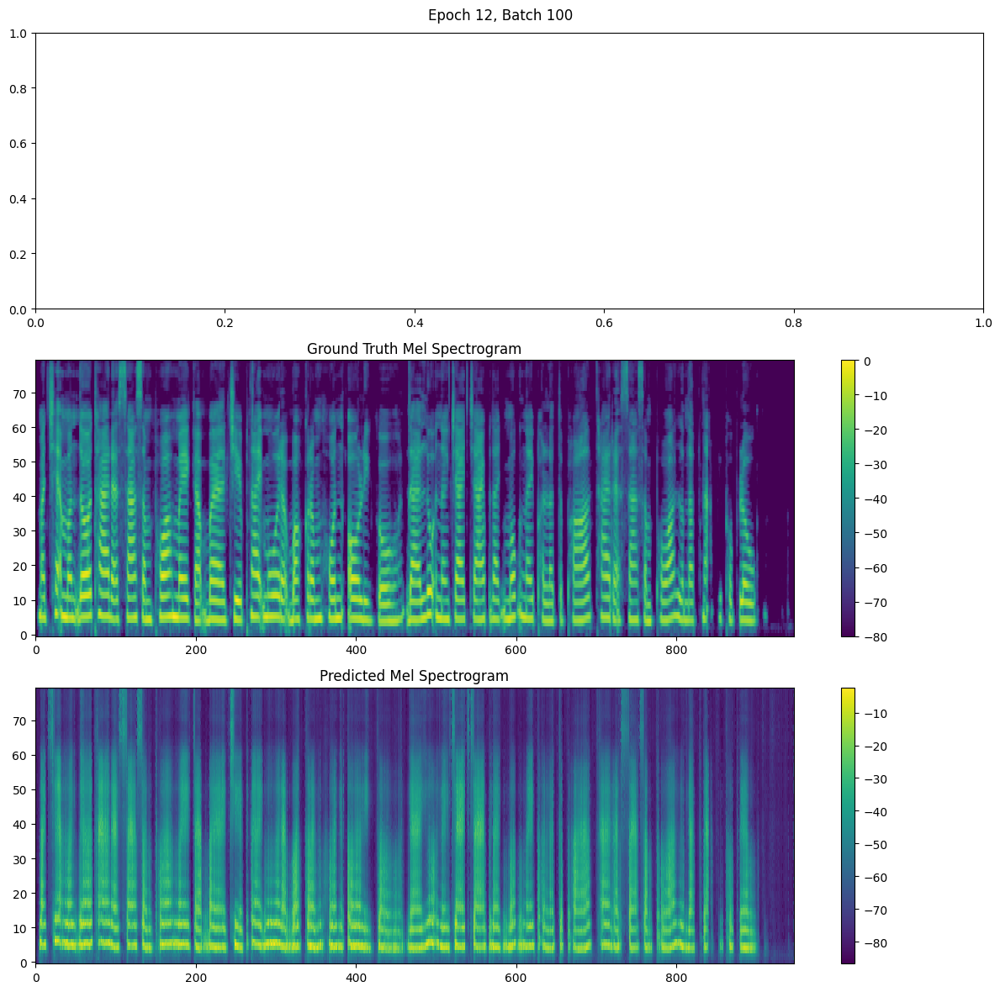

Gradient norm: 111.36390721544267
Epoch 12/20, Batch 100, Loss: 64.0755, Mel Loss: 64.0665, Gate Loss: 0.0090, LR: 0.000284
Gradient norm: 160.56116104000768
Epoch 12/20, Batch 110, Loss: 90.0675, Mel Loss: 90.0542, Gate Loss: 0.0133, LR: 0.000284
Gradient norm: 173.36413378142132
Epoch 12/20, Batch 120, Loss: 90.2103, Mel Loss: 90.1967, Gate Loss: 0.0136, LR: 0.000284
Epoch 12/20, Average Loss: 87.4025


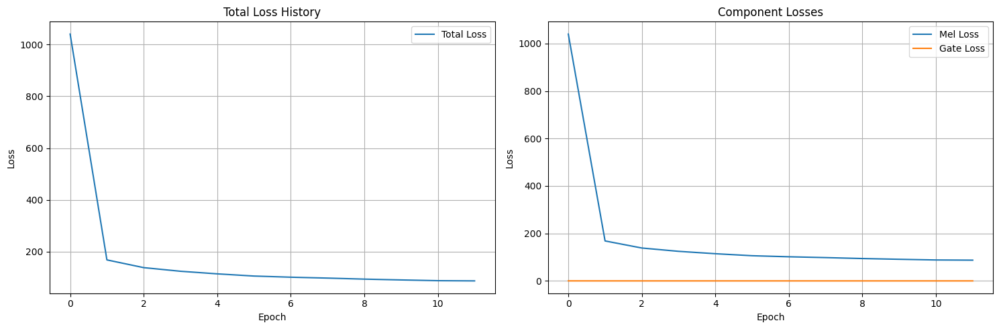

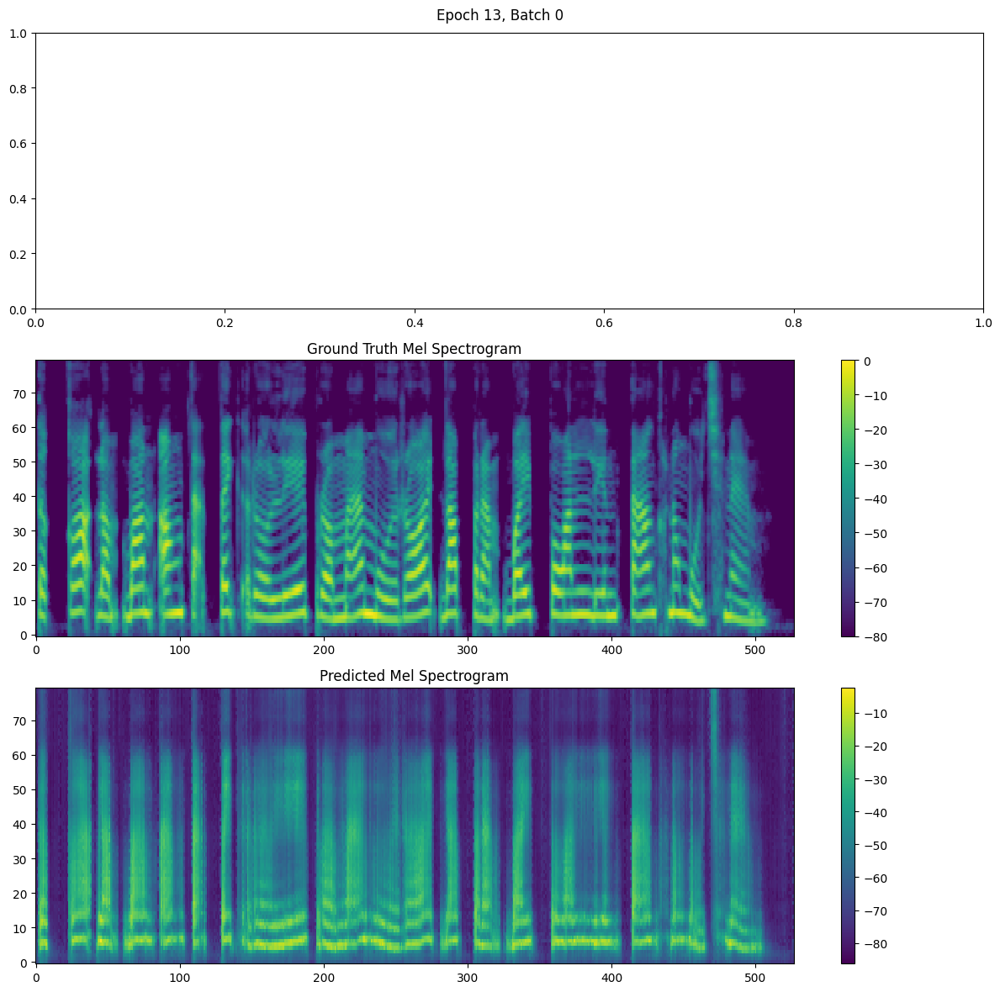

Gradient norm: 137.14519255598657
Epoch 13/20, Batch 0, Loss: 104.6914, Mel Loss: 104.6778, Gate Loss: 0.0136, LR: 0.000270
Gradient norm: 140.0920245147337
Epoch 13/20, Batch 10, Loss: 62.7943, Mel Loss: 62.7848, Gate Loss: 0.0095, LR: 0.000270
Gradient norm: 243.51969370177804
Epoch 13/20, Batch 20, Loss: 99.1543, Mel Loss: 99.1389, Gate Loss: 0.0154, LR: 0.000270
Gradient norm: 45.158613947927776
Epoch 13/20, Batch 30, Loss: 85.5483, Mel Loss: 85.5380, Gate Loss: 0.0104, LR: 0.000270
Gradient norm: 53.07491577399328
Epoch 13/20, Batch 40, Loss: 69.8014, Mel Loss: 69.7904, Gate Loss: 0.0109, LR: 0.000270


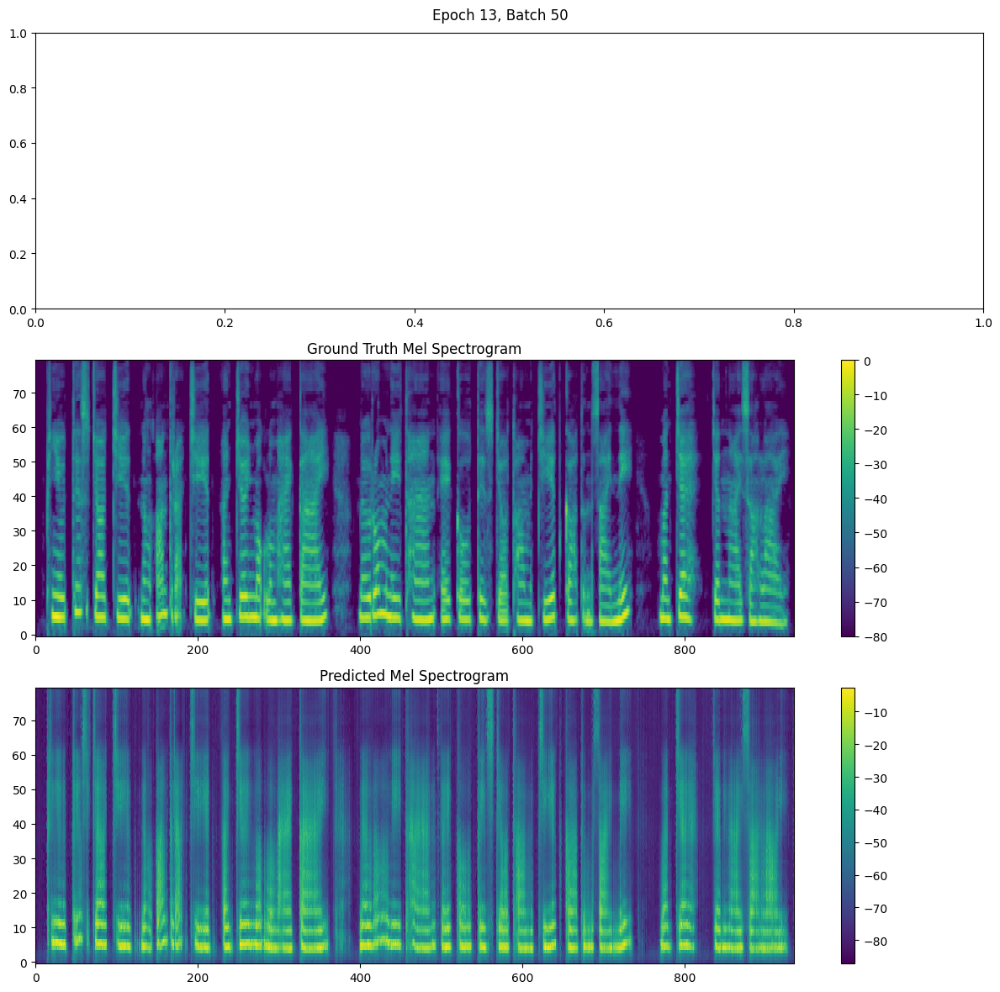

Gradient norm: 115.44424284940742
Epoch 13/20, Batch 50, Loss: 55.1780, Mel Loss: 55.1706, Gate Loss: 0.0074, LR: 0.000270
Gradient norm: 93.49042890030292
Epoch 13/20, Batch 60, Loss: 89.1545, Mel Loss: 89.1425, Gate Loss: 0.0120, LR: 0.000270
Gradient norm: 204.45378617036658
Epoch 13/20, Batch 70, Loss: 92.5107, Mel Loss: 92.4983, Gate Loss: 0.0124, LR: 0.000270
Gradient norm: 69.51302008050827
Epoch 13/20, Batch 80, Loss: 78.8776, Mel Loss: 78.8675, Gate Loss: 0.0101, LR: 0.000270
Gradient norm: 107.25222312808249
Epoch 13/20, Batch 90, Loss: 91.4889, Mel Loss: 91.4746, Gate Loss: 0.0143, LR: 0.000270


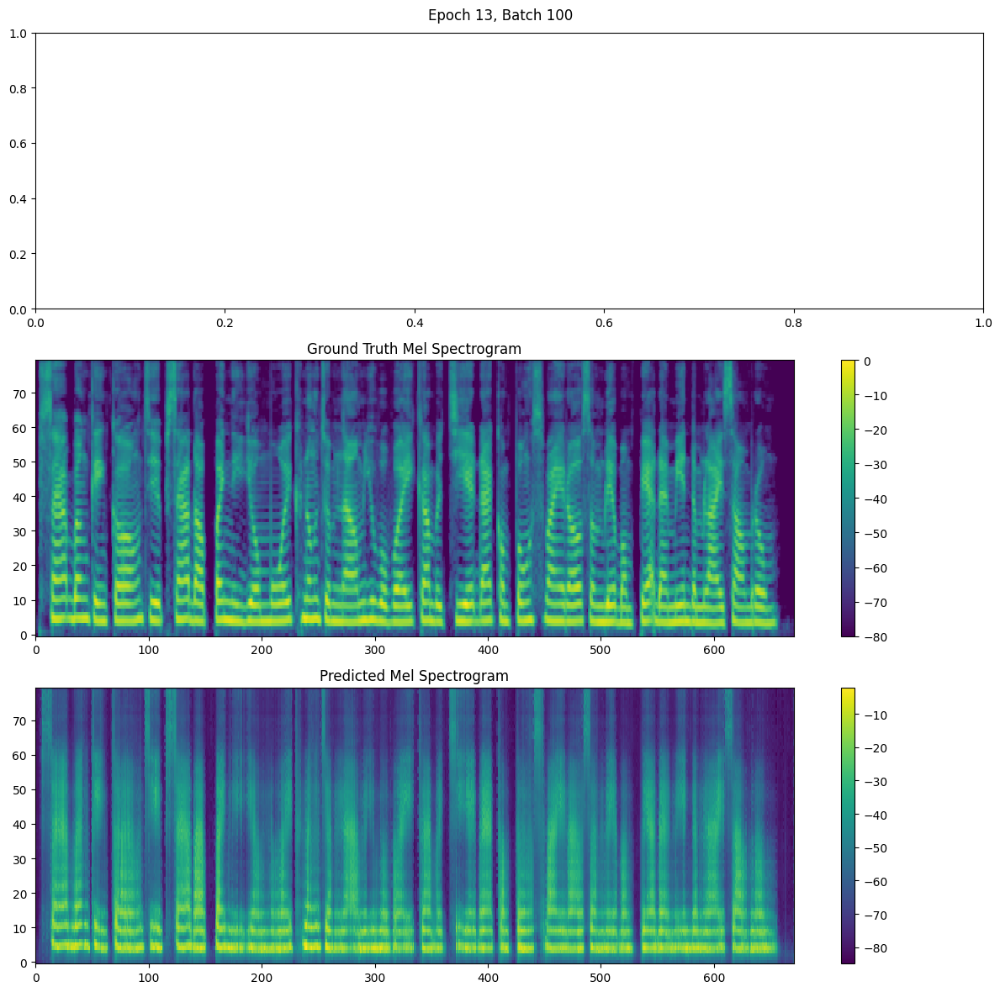

Gradient norm: 147.5204047996963
Epoch 13/20, Batch 100, Loss: 87.0641, Mel Loss: 87.0530, Gate Loss: 0.0111, LR: 0.000270
Gradient norm: 74.59647023872564
Epoch 13/20, Batch 110, Loss: 77.8000, Mel Loss: 77.7887, Gate Loss: 0.0113, LR: 0.000270
Gradient norm: 84.72735472254546
Epoch 13/20, Batch 120, Loss: 83.6727, Mel Loss: 83.6622, Gate Loss: 0.0105, LR: 0.000270
Epoch 13/20, Average Loss: 84.5572


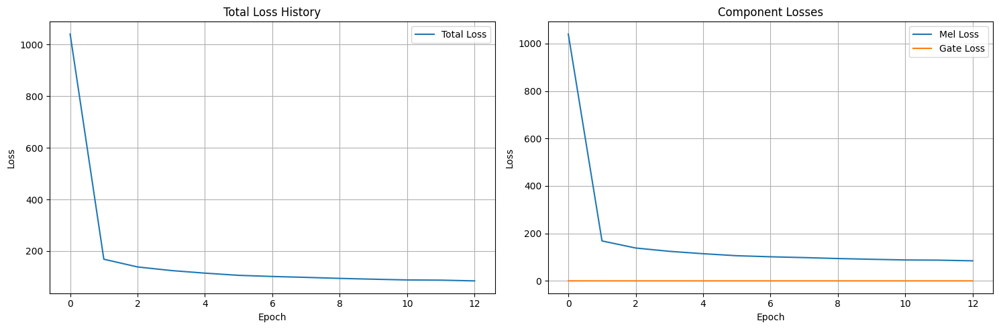

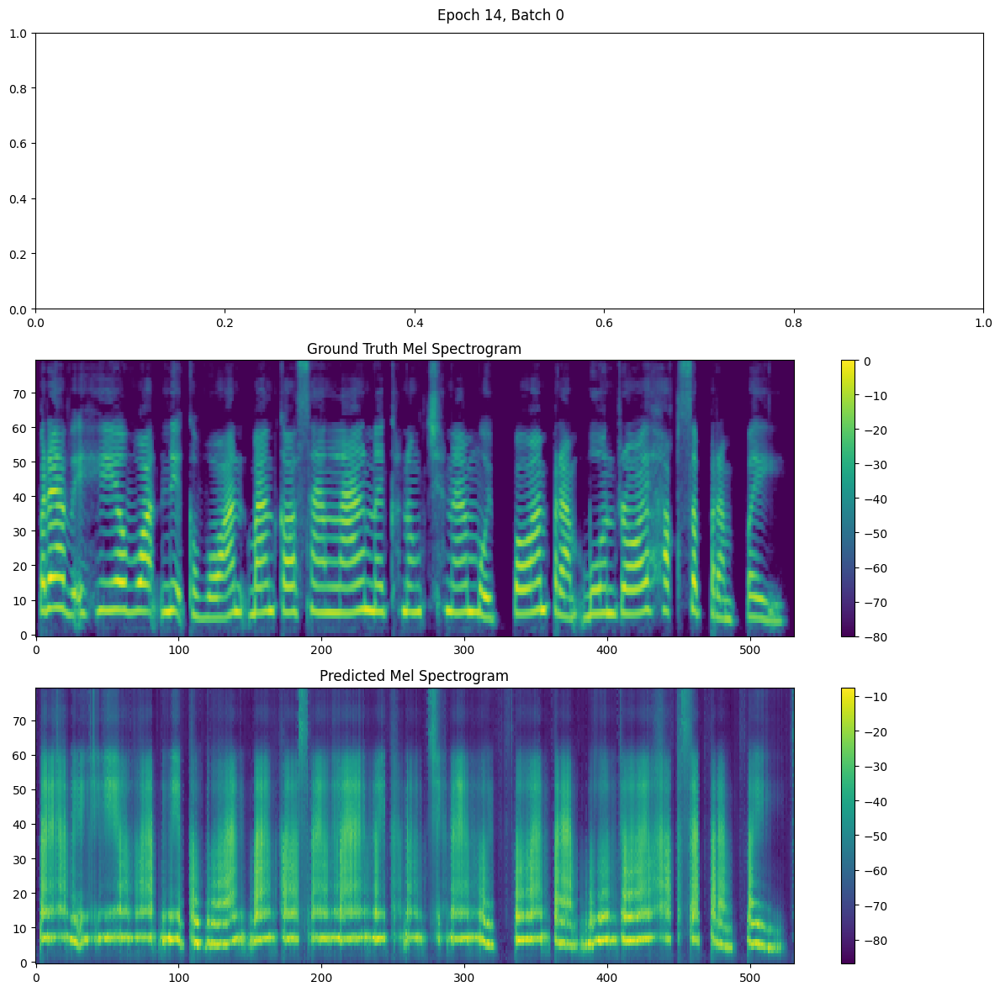

Gradient norm: 95.54558206635667
Epoch 14/20, Batch 0, Loss: 92.3786, Mel Loss: 92.3650, Gate Loss: 0.0136, LR: 0.000257
Gradient norm: 114.36827843838005
Epoch 14/20, Batch 10, Loss: 65.8665, Mel Loss: 65.8565, Gate Loss: 0.0101, LR: 0.000257
Gradient norm: 82.82477401218534
Epoch 14/20, Batch 20, Loss: 89.7147, Mel Loss: 89.7022, Gate Loss: 0.0125, LR: 0.000257
Gradient norm: 61.448032982348444
Epoch 14/20, Batch 30, Loss: 86.4133, Mel Loss: 86.4010, Gate Loss: 0.0122, LR: 0.000257
Gradient norm: 68.92321355407253
Epoch 14/20, Batch 40, Loss: 59.8275, Mel Loss: 59.8188, Gate Loss: 0.0087, LR: 0.000257


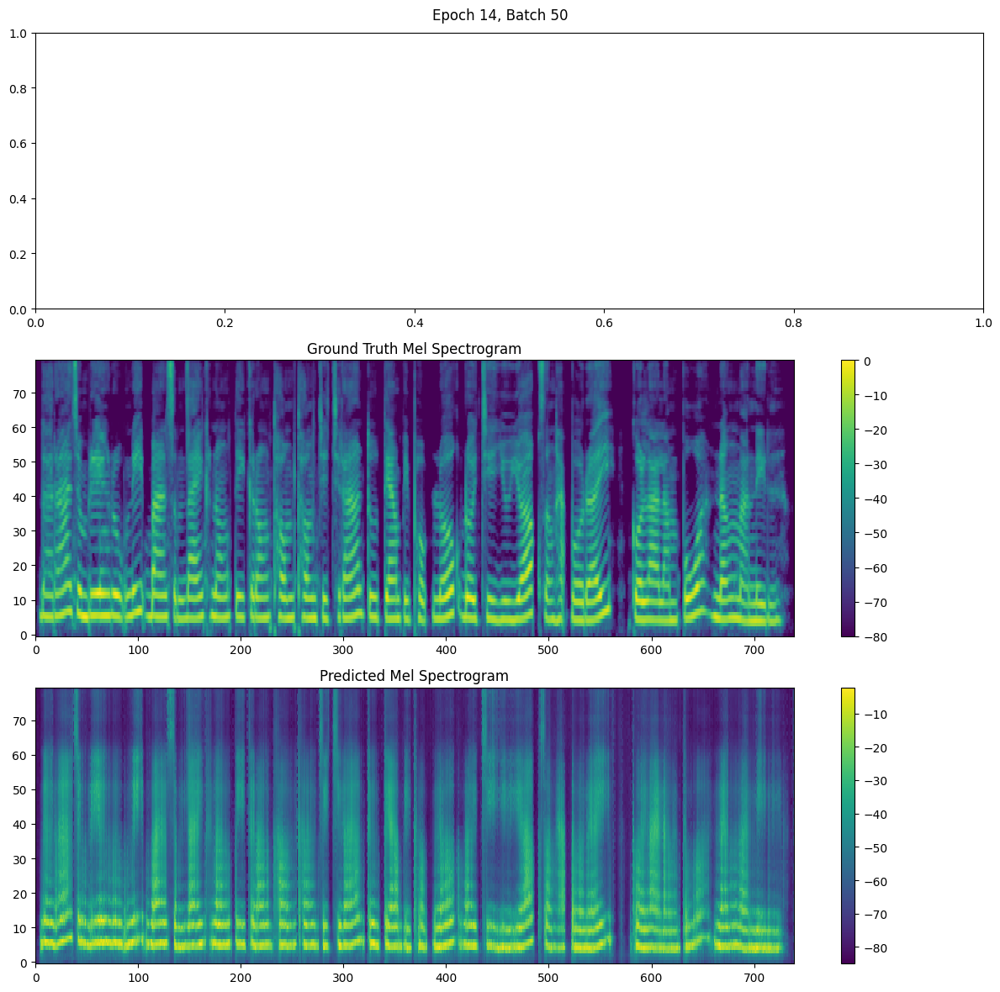

Gradient norm: 65.5092469898869
Epoch 14/20, Batch 50, Loss: 74.6957, Mel Loss: 74.6875, Gate Loss: 0.0082, LR: 0.000257
Gradient norm: 104.71009574616
Epoch 14/20, Batch 60, Loss: 77.9363, Mel Loss: 77.9254, Gate Loss: 0.0109, LR: 0.000257
Gradient norm: 141.74776353394984
Epoch 14/20, Batch 70, Loss: 86.4067, Mel Loss: 86.3938, Gate Loss: 0.0129, LR: 0.000257
Gradient norm: 129.29133149862741
Epoch 14/20, Batch 80, Loss: 99.8883, Mel Loss: 99.8761, Gate Loss: 0.0121, LR: 0.000257
Gradient norm: 219.305835424202
Epoch 14/20, Batch 90, Loss: 95.4312, Mel Loss: 95.4141, Gate Loss: 0.0171, LR: 0.000257


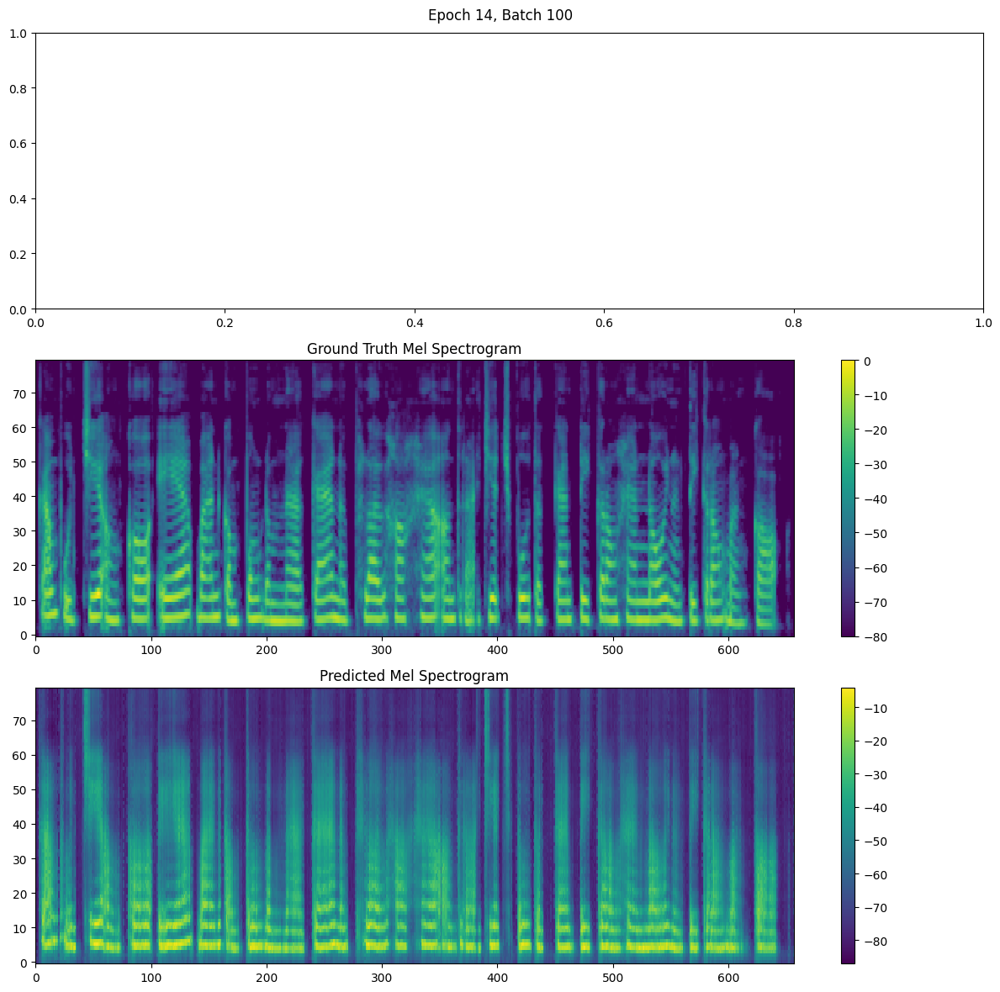

Gradient norm: 65.09896915972973
Epoch 14/20, Batch 100, Loss: 75.4643, Mel Loss: 75.4543, Gate Loss: 0.0101, LR: 0.000257
Gradient norm: 112.4231460122583
Epoch 14/20, Batch 110, Loss: 77.5955, Mel Loss: 77.5845, Gate Loss: 0.0110, LR: 0.000257
Gradient norm: 177.74623590310517
Epoch 14/20, Batch 120, Loss: 99.9535, Mel Loss: 99.9397, Gate Loss: 0.0137, LR: 0.000257
Epoch 14/20, Average Loss: 81.7176


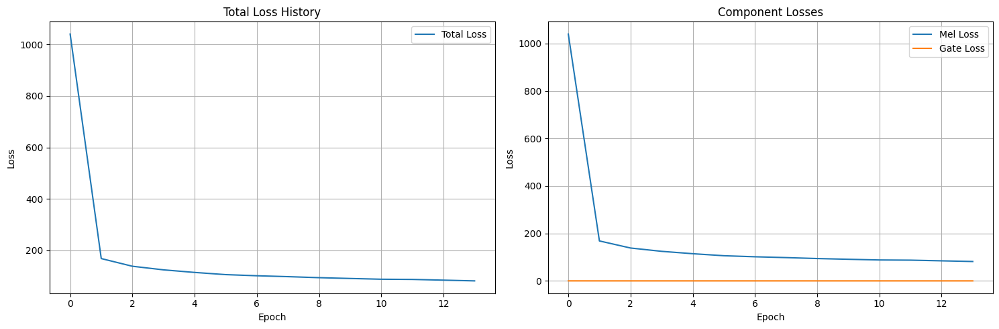

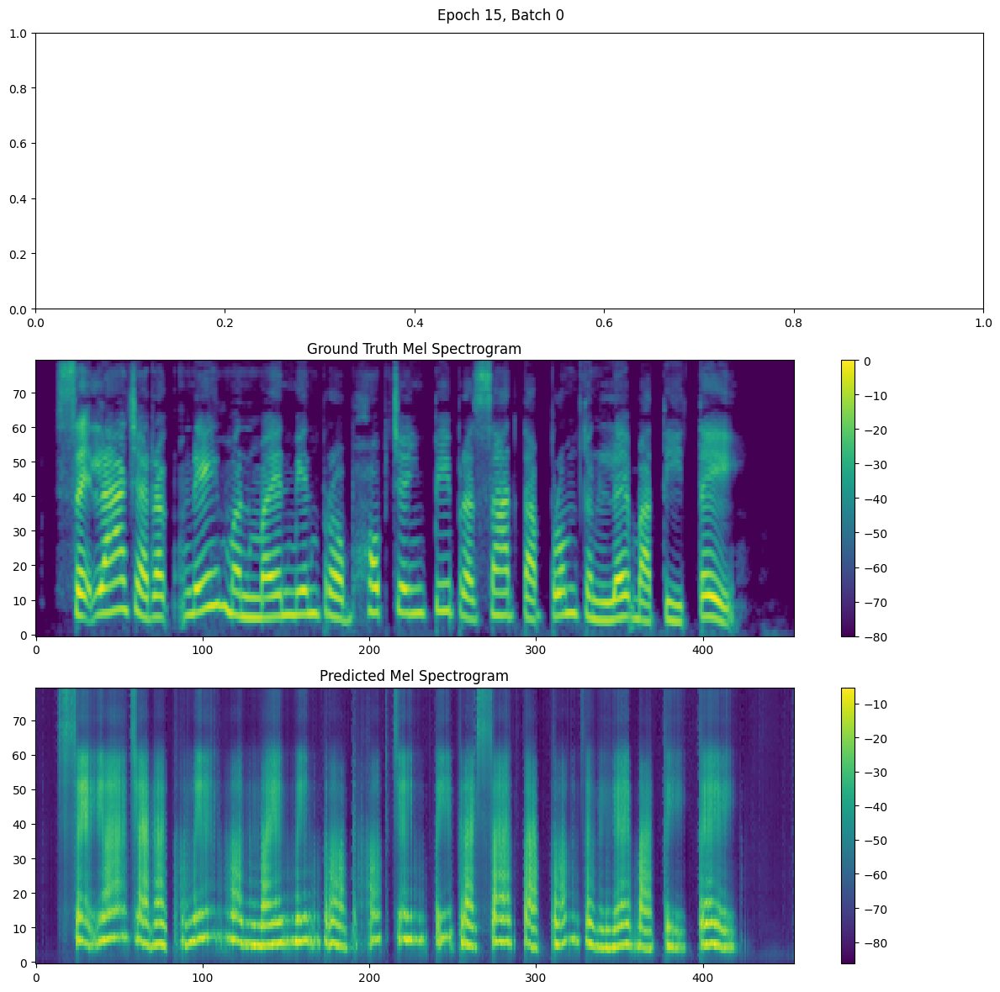

Gradient norm: 113.34242629980066
Epoch 15/20, Batch 0, Loss: 103.8388, Mel Loss: 103.8212, Gate Loss: 0.0176, LR: 0.000244
Gradient norm: 165.52836276212892
Epoch 15/20, Batch 10, Loss: 97.5306, Mel Loss: 97.5156, Gate Loss: 0.0150, LR: 0.000244
Gradient norm: 162.77970348094934
Epoch 15/20, Batch 20, Loss: 68.3386, Mel Loss: 68.3294, Gate Loss: 0.0092, LR: 0.000244
Gradient norm: 46.79683151495562
Epoch 15/20, Batch 30, Loss: 64.8023, Mel Loss: 64.7939, Gate Loss: 0.0084, LR: 0.000244
Gradient norm: 56.766434190556225
Epoch 15/20, Batch 40, Loss: 83.5635, Mel Loss: 83.5516, Gate Loss: 0.0119, LR: 0.000244


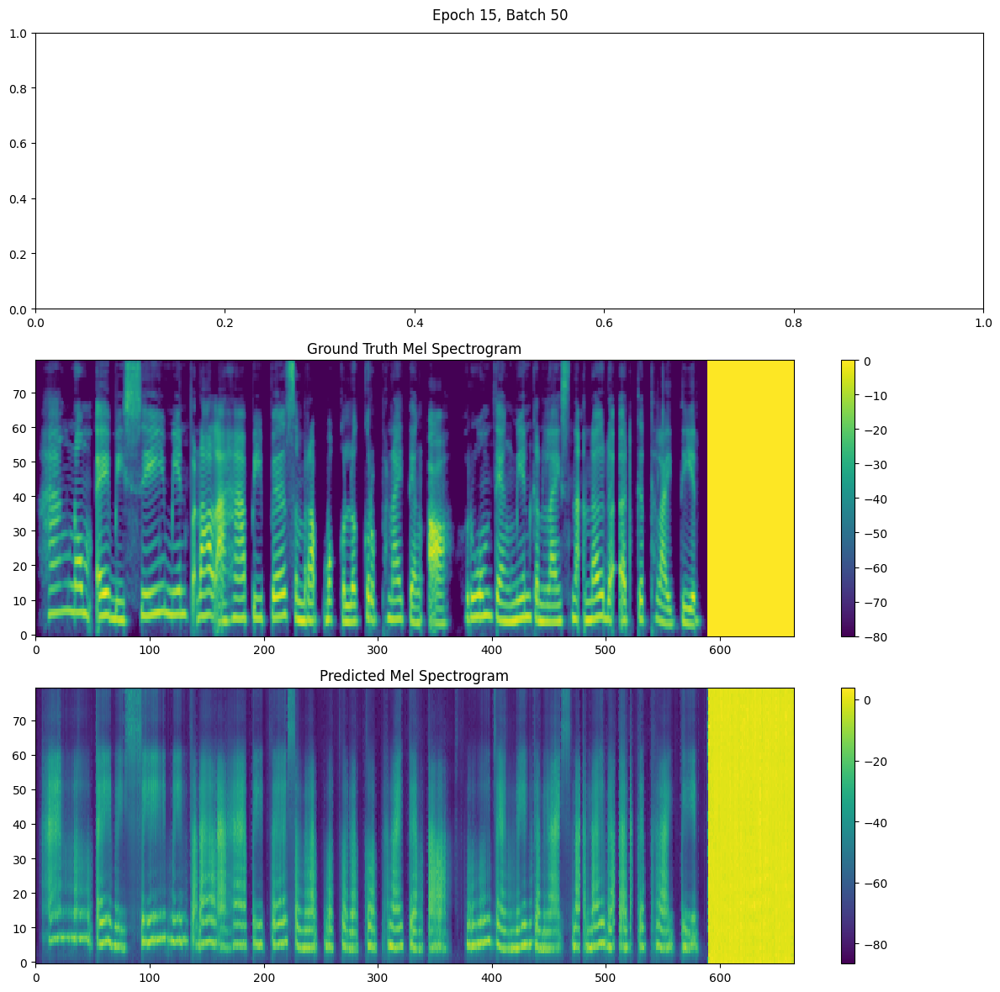

Gradient norm: 118.24879817225579
Epoch 15/20, Batch 50, Loss: 90.3222, Mel Loss: 90.3118, Gate Loss: 0.0103, LR: 0.000244
Gradient norm: 178.83058760778954
Epoch 15/20, Batch 60, Loss: 80.0031, Mel Loss: 79.9899, Gate Loss: 0.0132, LR: 0.000244
Gradient norm: 69.80374831748647
Epoch 15/20, Batch 70, Loss: 63.2813, Mel Loss: 63.2718, Gate Loss: 0.0095, LR: 0.000244
Gradient norm: 94.48881986891006
Epoch 15/20, Batch 80, Loss: 89.5969, Mel Loss: 89.5860, Gate Loss: 0.0108, LR: 0.000244
Gradient norm: 190.5813423258658
Epoch 15/20, Batch 90, Loss: 67.6451, Mel Loss: 67.6357, Gate Loss: 0.0095, LR: 0.000244


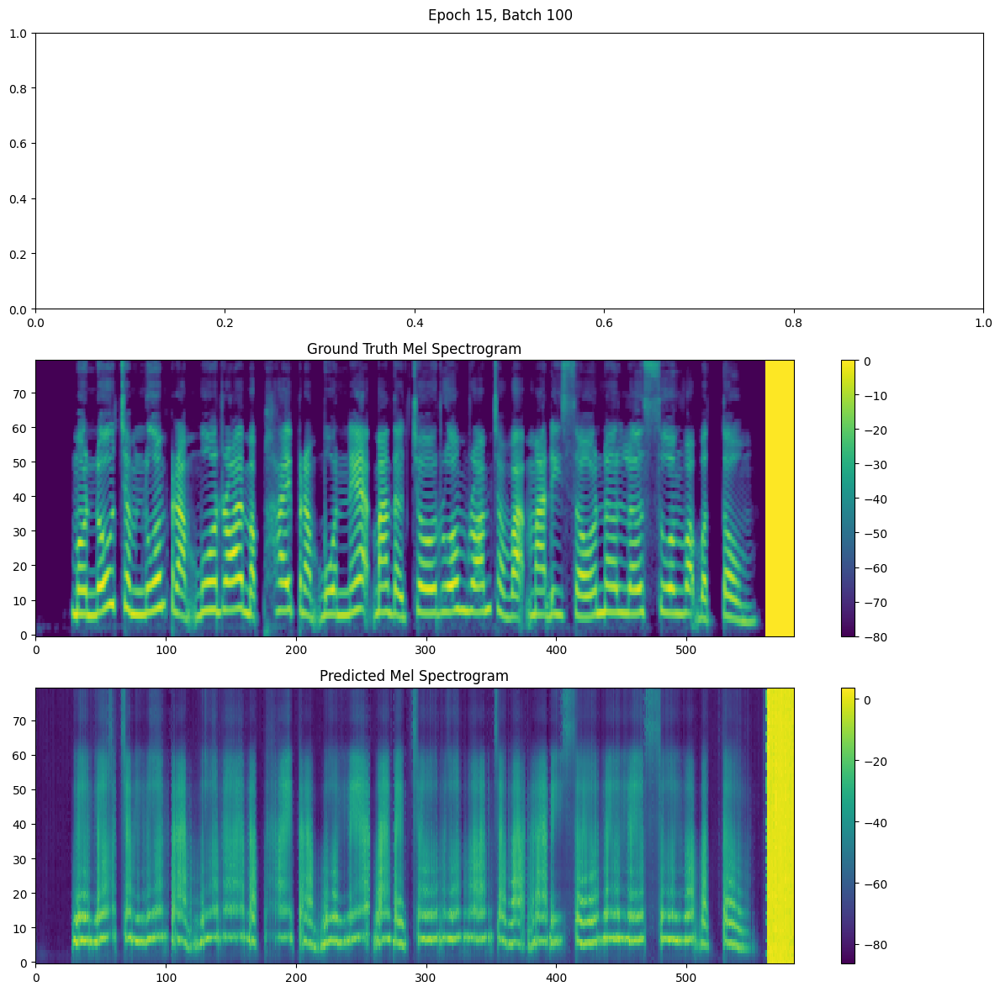

Gradient norm: 240.10429253564257
Epoch 15/20, Batch 100, Loss: 93.1699, Mel Loss: 93.1594, Gate Loss: 0.0105, LR: 0.000244
Gradient norm: 281.7508351921841
Epoch 15/20, Batch 110, Loss: 83.1208, Mel Loss: 83.1109, Gate Loss: 0.0098, LR: 0.000244
Gradient norm: 64.1781876498225
Epoch 15/20, Batch 120, Loss: 75.2663, Mel Loss: 75.2572, Gate Loss: 0.0091, LR: 0.000244
Epoch 15/20, Average Loss: 81.4864


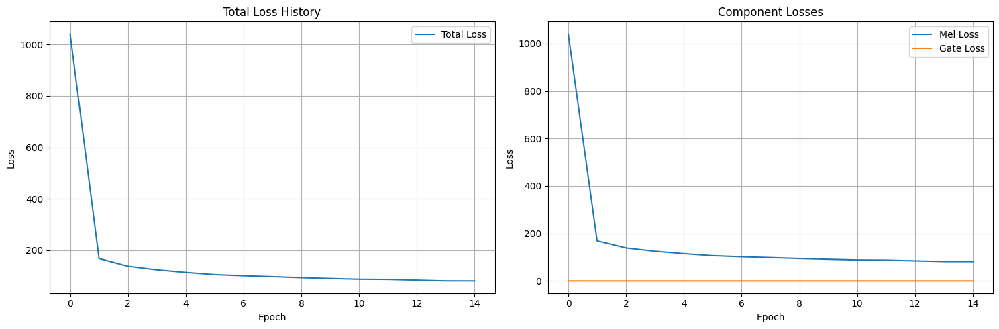

Checkpoint saved at epoch 15
Sample text shape: torch.Size([1, 49])
Sample text length: tensor([49], device='cuda:0')
Error during checkpoint generation: Tacotron2.infer() got an unexpected keyword argument 'max_decoder_steps'
Continuing training...


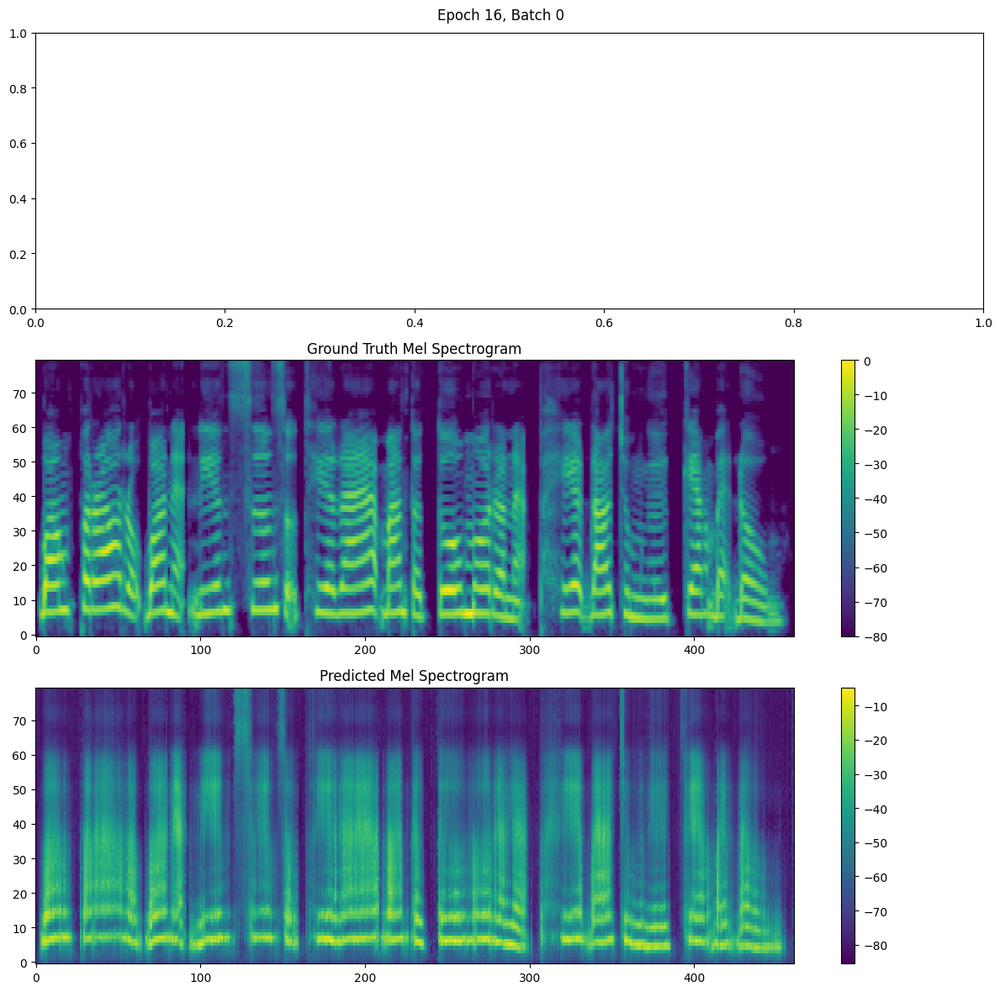

Gradient norm: 170.43161844978317
Epoch 16/20, Batch 0, Loss: 100.9601, Mel Loss: 100.9443, Gate Loss: 0.0158, LR: 0.000232
Gradient norm: 230.61871212880877
Epoch 16/20, Batch 10, Loss: 104.1785, Mel Loss: 104.1652, Gate Loss: 0.0133, LR: 0.000232
Gradient norm: 111.089074222882
Epoch 16/20, Batch 20, Loss: 81.0139, Mel Loss: 81.0034, Gate Loss: 0.0105, LR: 0.000232
Gradient norm: 192.58816903891926
Epoch 16/20, Batch 30, Loss: 68.5246, Mel Loss: 68.5157, Gate Loss: 0.0089, LR: 0.000232
Gradient norm: 136.41475278956847
Epoch 16/20, Batch 40, Loss: 107.3693, Mel Loss: 107.3533, Gate Loss: 0.0160, LR: 0.000232


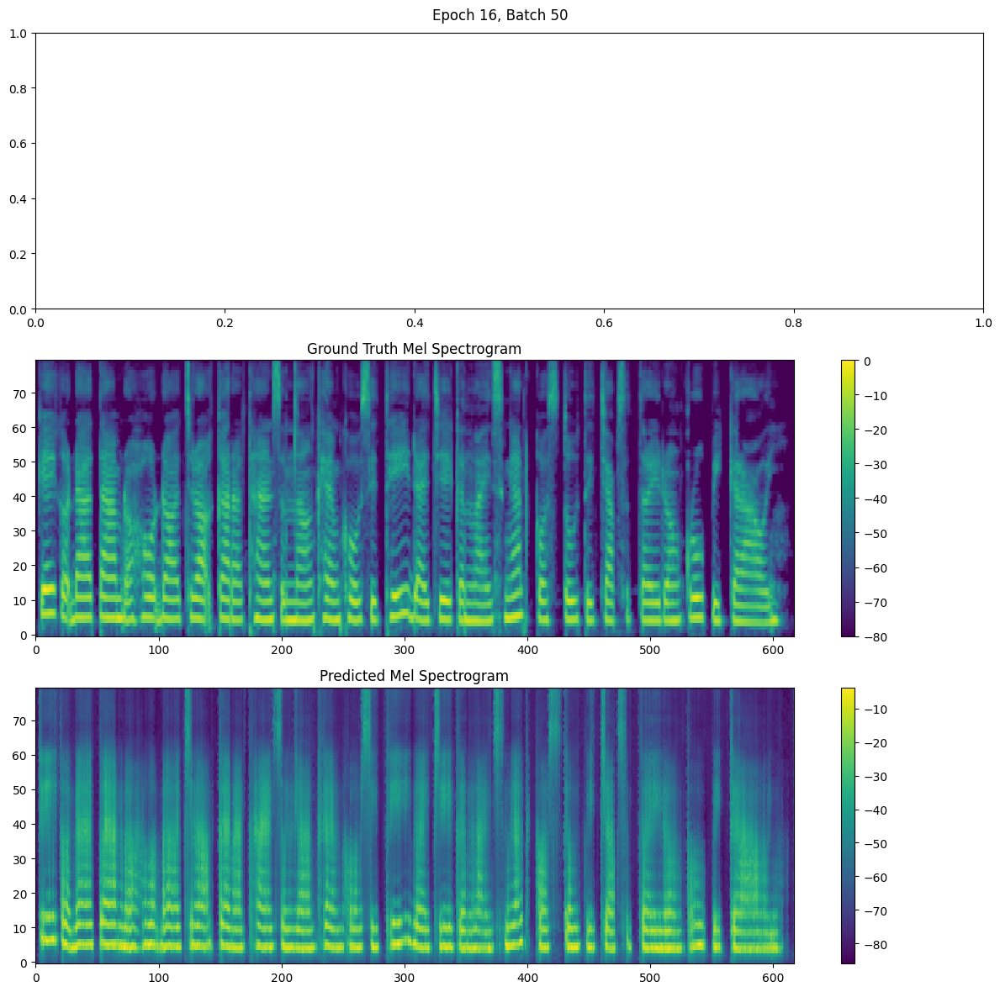

Gradient norm: 122.20331094413238
Epoch 16/20, Batch 50, Loss: 85.0701, Mel Loss: 85.0585, Gate Loss: 0.0116, LR: 0.000232
Gradient norm: 154.63440058740832
Epoch 16/20, Batch 60, Loss: 97.1853, Mel Loss: 97.1740, Gate Loss: 0.0113, LR: 0.000232
Gradient norm: 48.075371714932444
Epoch 16/20, Batch 70, Loss: 69.3910, Mel Loss: 69.3814, Gate Loss: 0.0096, LR: 0.000232
Gradient norm: 187.59184337909625
Epoch 16/20, Batch 80, Loss: 82.0133, Mel Loss: 82.0038, Gate Loss: 0.0095, LR: 0.000232
Gradient norm: 133.85115032420072
Epoch 16/20, Batch 90, Loss: 80.3241, Mel Loss: 80.3115, Gate Loss: 0.0126, LR: 0.000232


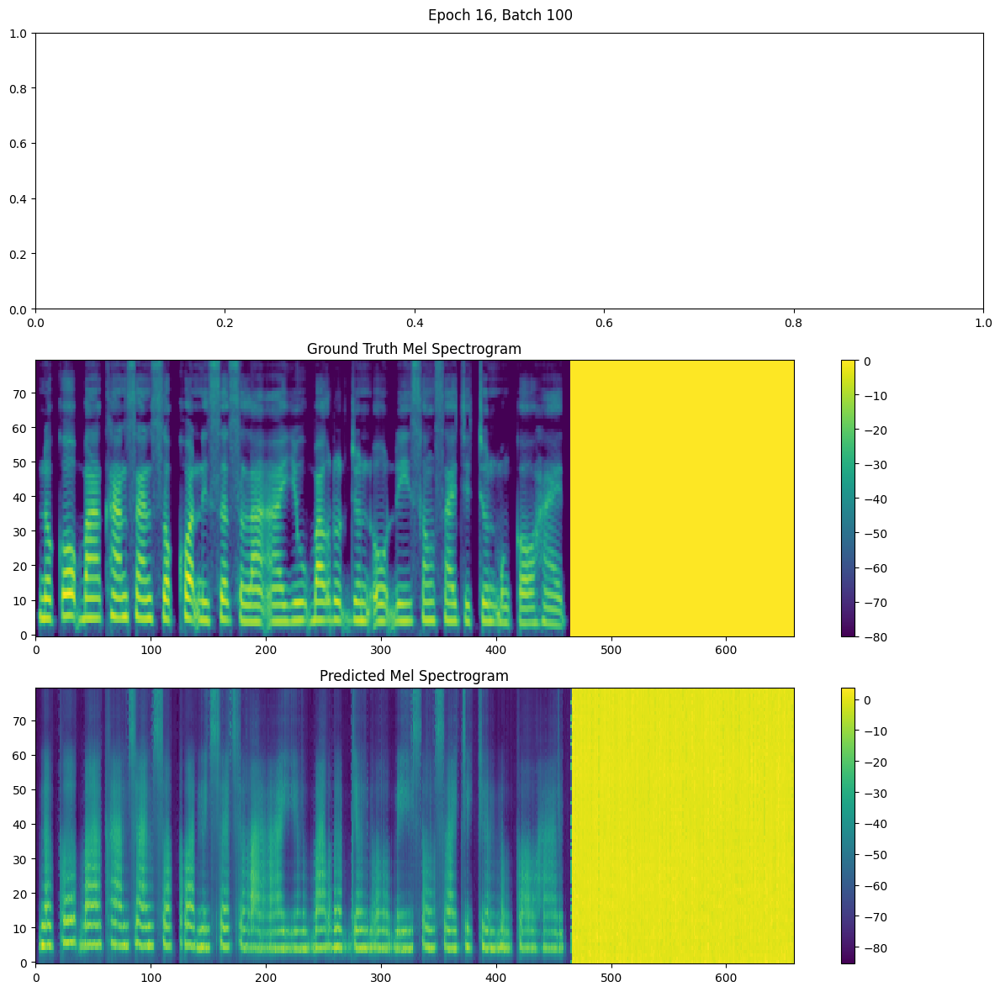

Gradient norm: 59.268179195525356
Epoch 16/20, Batch 100, Loss: 77.3899, Mel Loss: 77.3795, Gate Loss: 0.0103, LR: 0.000232
Gradient norm: 79.7473816432056
Epoch 16/20, Batch 110, Loss: 77.6495, Mel Loss: 77.6387, Gate Loss: 0.0108, LR: 0.000232
Gradient norm: 159.30052404893272
Epoch 16/20, Batch 120, Loss: 75.8893, Mel Loss: 75.8799, Gate Loss: 0.0094, LR: 0.000232
Epoch 16/20, Average Loss: 79.9412


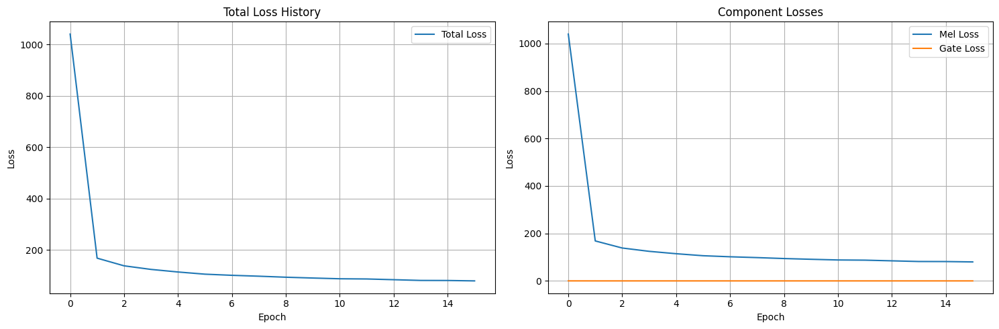

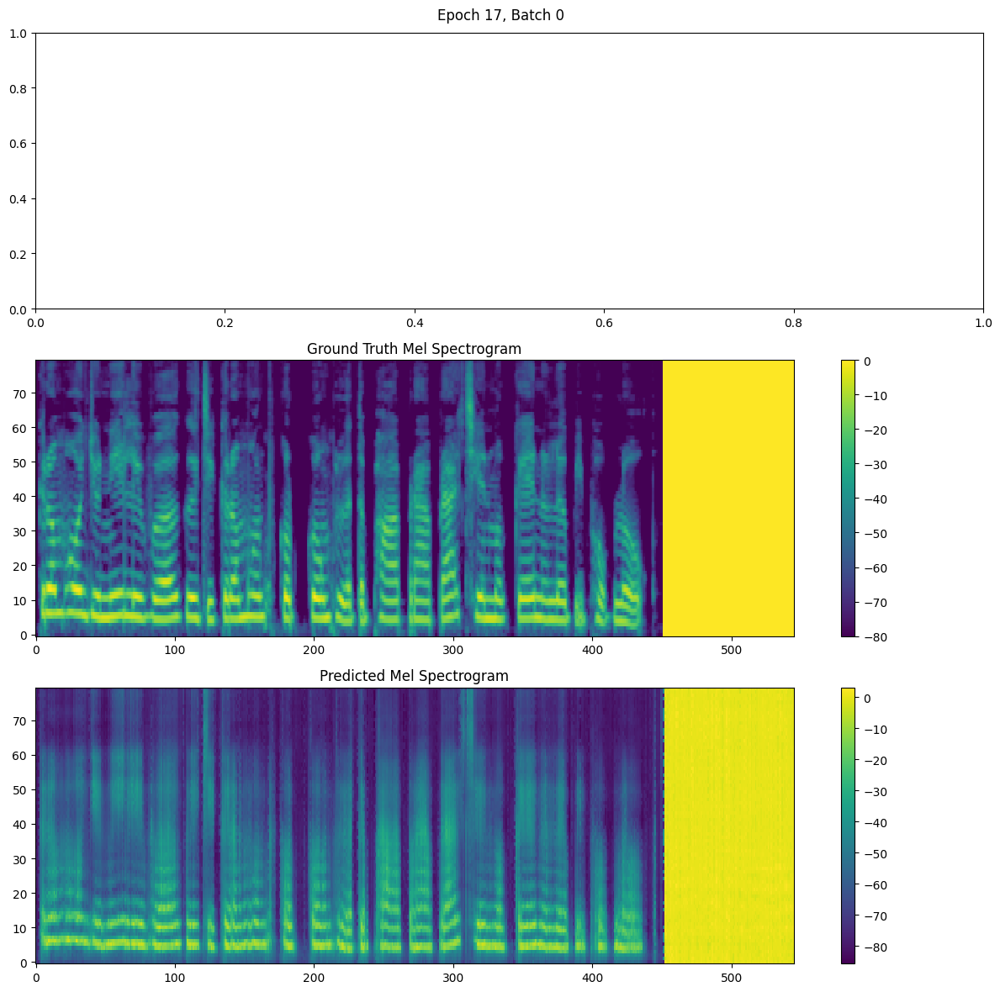

Gradient norm: 81.9249312015516
Epoch 17/20, Batch 0, Loss: 89.7593, Mel Loss: 89.7472, Gate Loss: 0.0121, LR: 0.000220
Gradient norm: 59.06680049338068
Epoch 17/20, Batch 10, Loss: 68.4264, Mel Loss: 68.4162, Gate Loss: 0.0102, LR: 0.000220
Gradient norm: 94.36089505611675
Epoch 17/20, Batch 20, Loss: 91.9037, Mel Loss: 91.8904, Gate Loss: 0.0132, LR: 0.000220
Gradient norm: 127.36701424868477
Epoch 17/20, Batch 30, Loss: 89.6499, Mel Loss: 89.6392, Gate Loss: 0.0107, LR: 0.000220
Gradient norm: 191.59482696985435
Epoch 17/20, Batch 40, Loss: 73.8232, Mel Loss: 73.8135, Gate Loss: 0.0097, LR: 0.000220


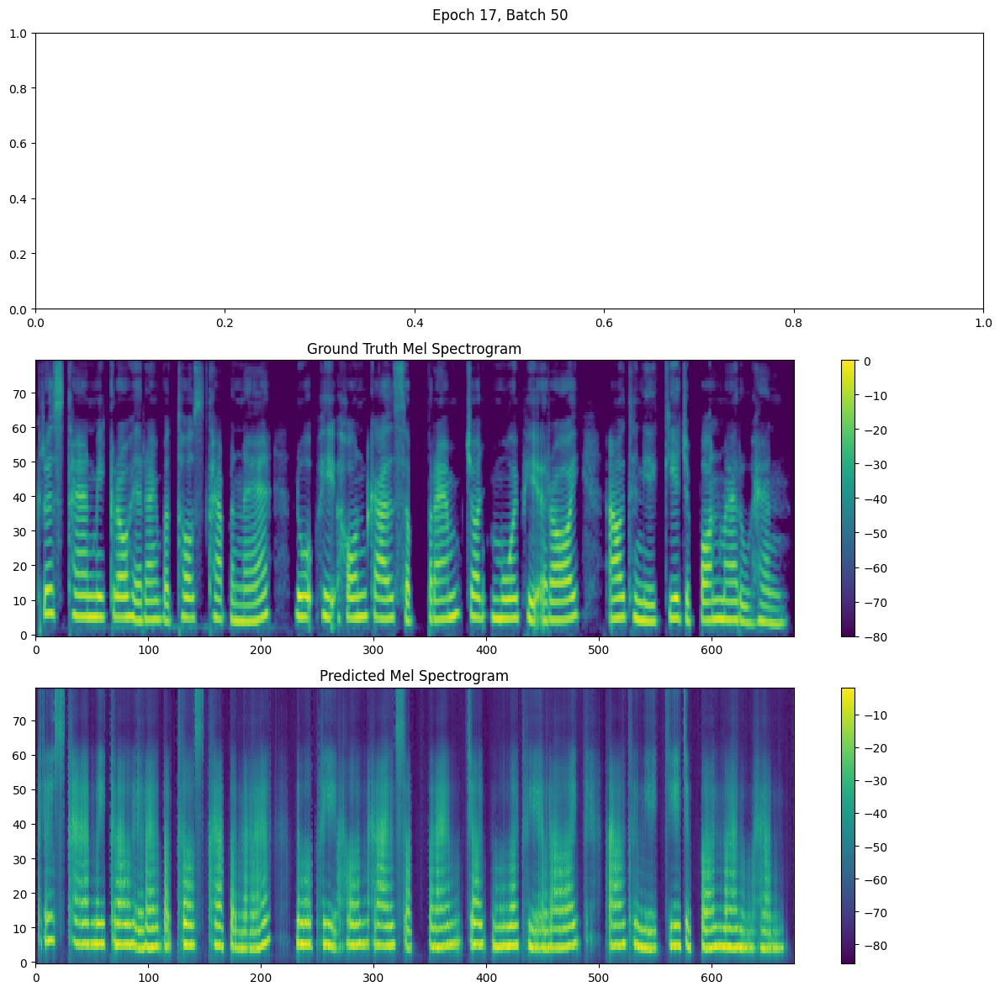

Gradient norm: 157.0572737634986
Epoch 17/20, Batch 50, Loss: 71.2740, Mel Loss: 71.2626, Gate Loss: 0.0114, LR: 0.000220
Gradient norm: 69.64442052444866
Epoch 17/20, Batch 60, Loss: 69.5380, Mel Loss: 69.5257, Gate Loss: 0.0123, LR: 0.000220
Gradient norm: 81.45159635042077
Epoch 17/20, Batch 70, Loss: 89.7126, Mel Loss: 89.7009, Gate Loss: 0.0118, LR: 0.000220
Gradient norm: 77.15911869895467
Epoch 17/20, Batch 80, Loss: 73.4667, Mel Loss: 73.4550, Gate Loss: 0.0117, LR: 0.000220
Gradient norm: 56.175164198153986
Epoch 17/20, Batch 90, Loss: 75.5985, Mel Loss: 75.5875, Gate Loss: 0.0110, LR: 0.000220


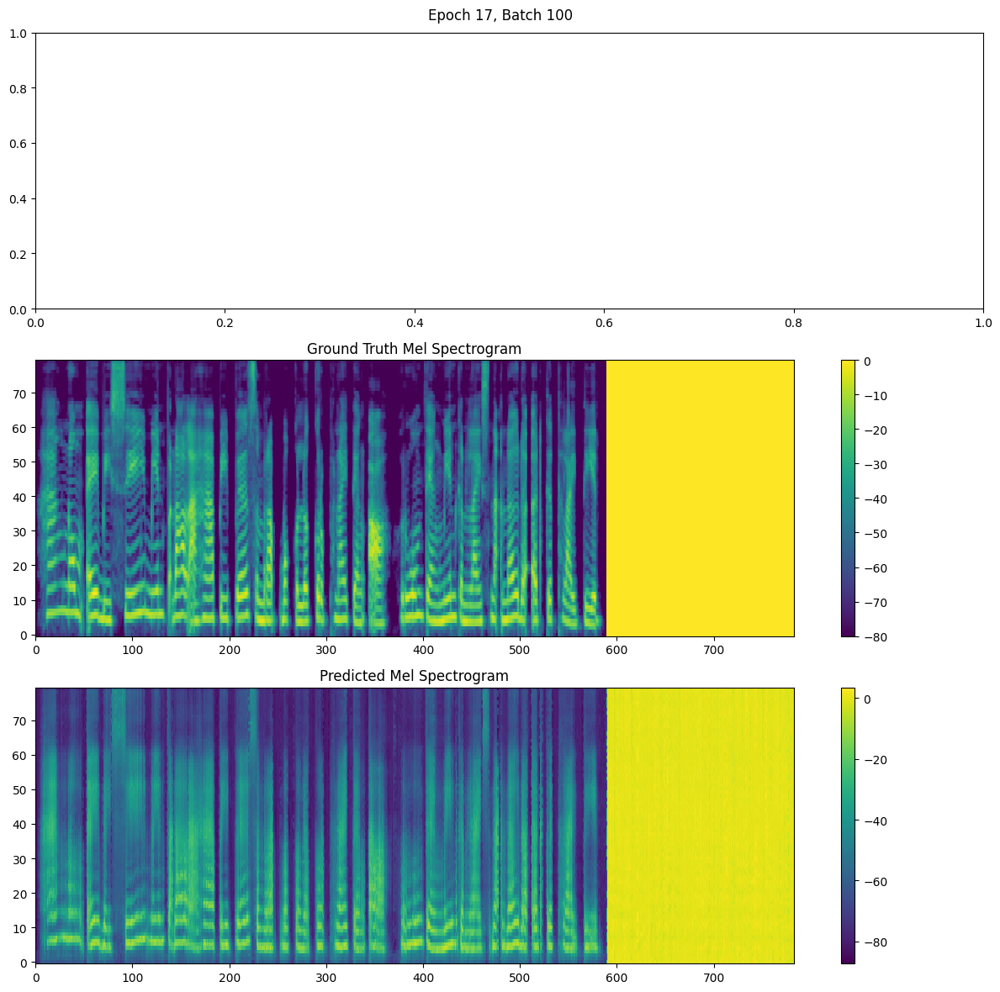

Gradient norm: 130.98299892235346
Epoch 17/20, Batch 100, Loss: 66.3053, Mel Loss: 66.2967, Gate Loss: 0.0085, LR: 0.000220
Gradient norm: 60.3299816860974
Epoch 17/20, Batch 110, Loss: 72.8641, Mel Loss: 72.8538, Gate Loss: 0.0103, LR: 0.000220
Gradient norm: 80.05243026706626
Epoch 17/20, Batch 120, Loss: 70.2708, Mel Loss: 70.2610, Gate Loss: 0.0098, LR: 0.000220
Epoch 17/20, Average Loss: 77.6112


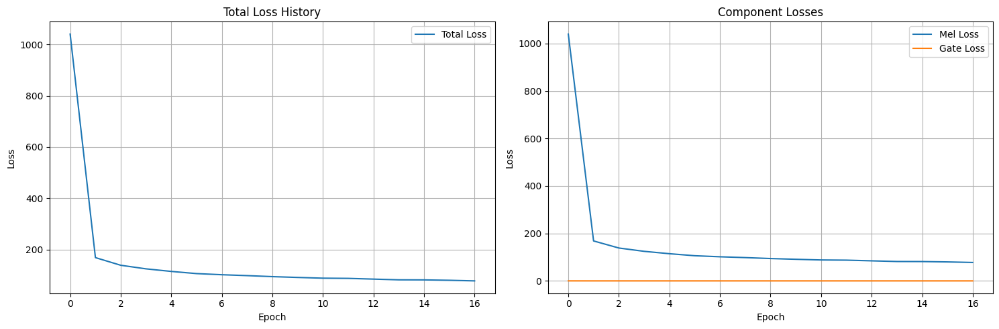

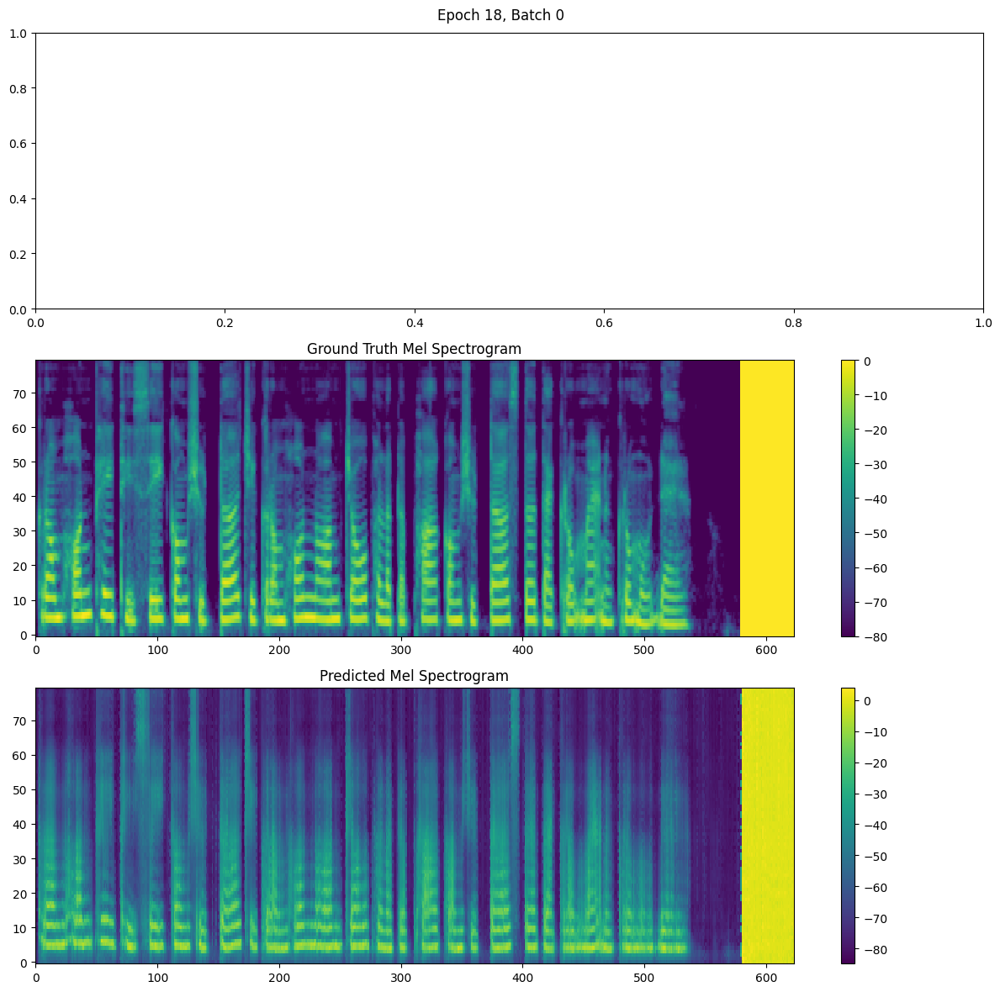

Gradient norm: 240.68422998869445
Epoch 18/20, Batch 0, Loss: 83.2857, Mel Loss: 83.2734, Gate Loss: 0.0123, LR: 0.000209
Gradient norm: 81.37827420786917
Epoch 18/20, Batch 10, Loss: 82.3561, Mel Loss: 82.3432, Gate Loss: 0.0128, LR: 0.000209
Gradient norm: 115.30324277863483
Epoch 18/20, Batch 20, Loss: 80.1301, Mel Loss: 80.1177, Gate Loss: 0.0124, LR: 0.000209
Gradient norm: 91.70632579009869
Epoch 18/20, Batch 30, Loss: 64.0168, Mel Loss: 64.0087, Gate Loss: 0.0081, LR: 0.000209
Gradient norm: 198.51392356550056
Epoch 18/20, Batch 40, Loss: 82.1524, Mel Loss: 82.1439, Gate Loss: 0.0085, LR: 0.000209


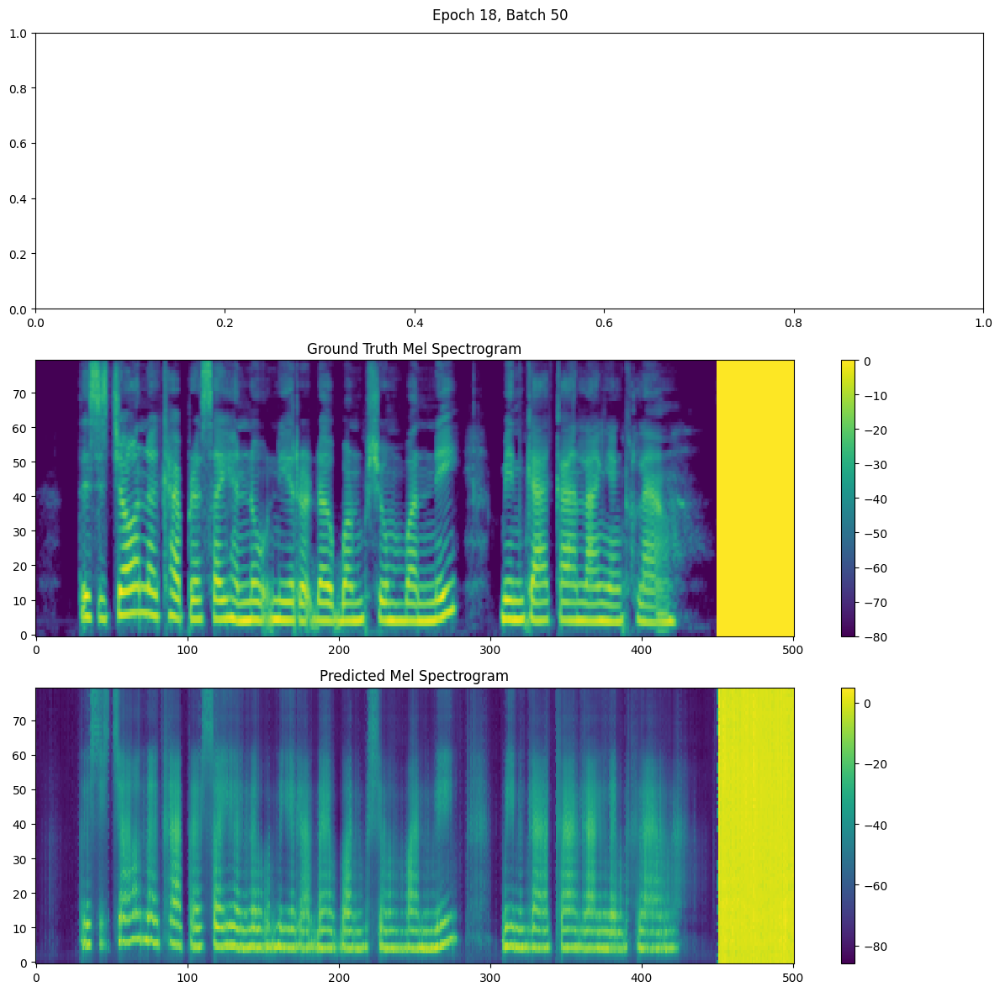

Gradient norm: 155.45981455263515
Epoch 18/20, Batch 50, Loss: 92.1573, Mel Loss: 92.1429, Gate Loss: 0.0144, LR: 0.000209
Gradient norm: 91.36929287693992
Epoch 18/20, Batch 60, Loss: 50.6607, Mel Loss: 50.6533, Gate Loss: 0.0075, LR: 0.000209
Gradient norm: 47.550895765516884
Epoch 18/20, Batch 70, Loss: 62.1969, Mel Loss: 62.1878, Gate Loss: 0.0090, LR: 0.000209
Gradient norm: 81.26652011771205
Epoch 18/20, Batch 80, Loss: 62.3924, Mel Loss: 62.3850, Gate Loss: 0.0074, LR: 0.000209
Gradient norm: 152.30721712119012
Epoch 18/20, Batch 90, Loss: 89.6092, Mel Loss: 89.5965, Gate Loss: 0.0127, LR: 0.000209


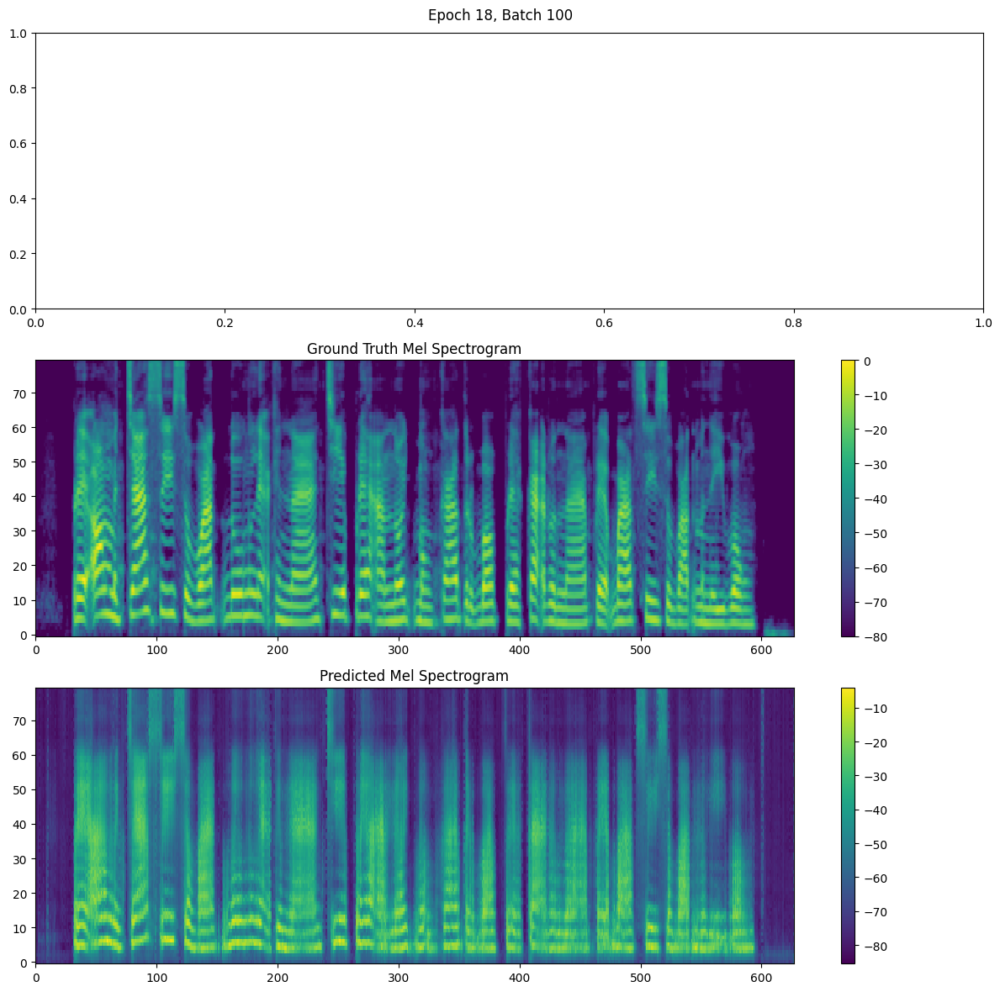

Gradient norm: 177.171011388347
Epoch 18/20, Batch 100, Loss: 76.1279, Mel Loss: 76.1167, Gate Loss: 0.0112, LR: 0.000209
Gradient norm: 77.9565013478593
Epoch 18/20, Batch 110, Loss: 71.6140, Mel Loss: 71.6056, Gate Loss: 0.0084, LR: 0.000209
Gradient norm: 134.29810499838354
Epoch 18/20, Batch 120, Loss: 82.9420, Mel Loss: 82.9306, Gate Loss: 0.0114, LR: 0.000209
Epoch 18/20, Average Loss: 76.9628


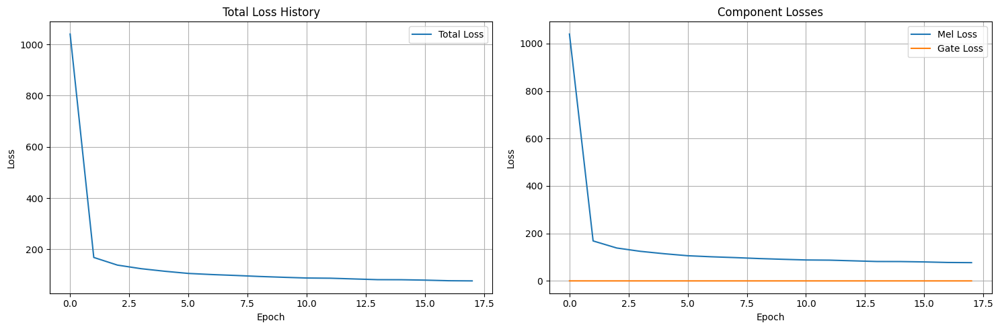

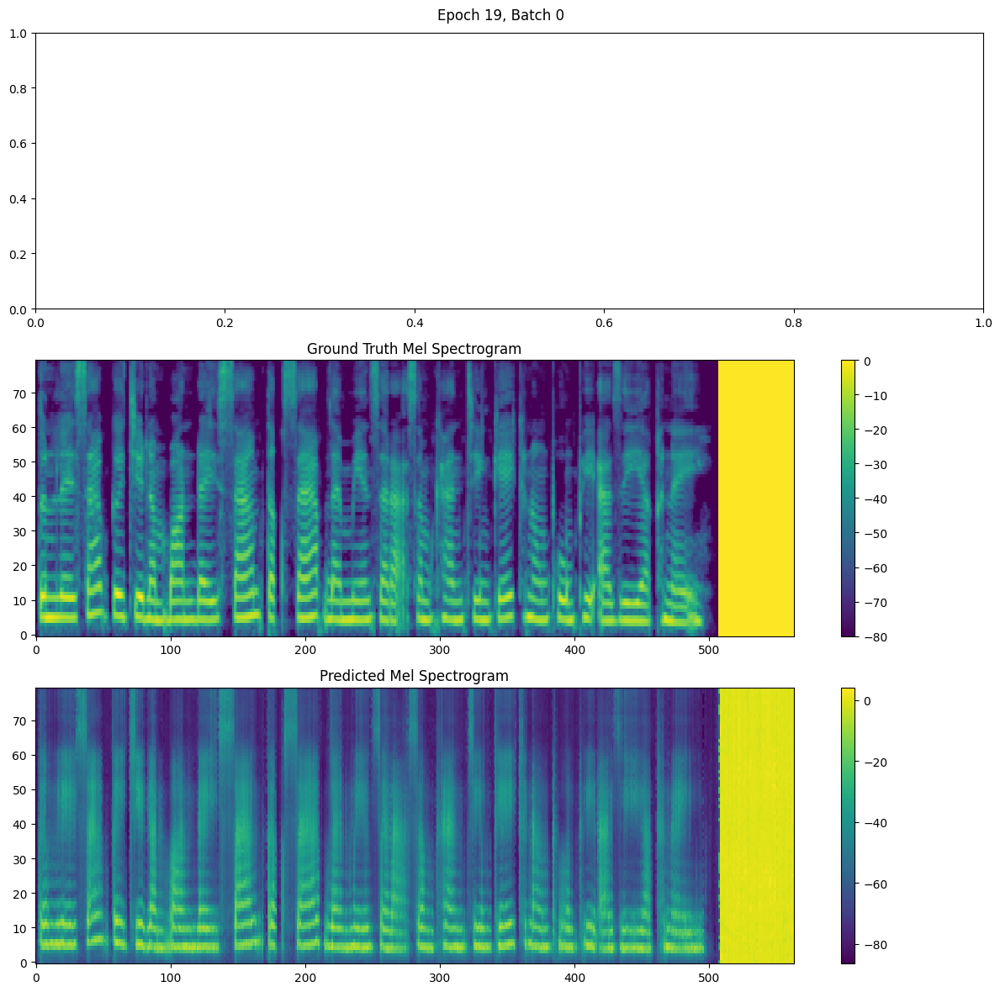

Gradient norm: 84.33545910342364
Epoch 19/20, Batch 0, Loss: 84.5213, Mel Loss: 84.5112, Gate Loss: 0.0101, LR: 0.000199
Gradient norm: 84.68537792868584
Epoch 19/20, Batch 10, Loss: 83.5703, Mel Loss: 83.5583, Gate Loss: 0.0120, LR: 0.000199
Gradient norm: 77.98385847970172
Epoch 19/20, Batch 20, Loss: 63.8911, Mel Loss: 63.8828, Gate Loss: 0.0083, LR: 0.000199
Gradient norm: 154.63424476248443
Epoch 19/20, Batch 30, Loss: 95.3071, Mel Loss: 95.2915, Gate Loss: 0.0156, LR: 0.000199
Gradient norm: 121.11330611231577
Epoch 19/20, Batch 40, Loss: 86.4203, Mel Loss: 86.4077, Gate Loss: 0.0127, LR: 0.000199


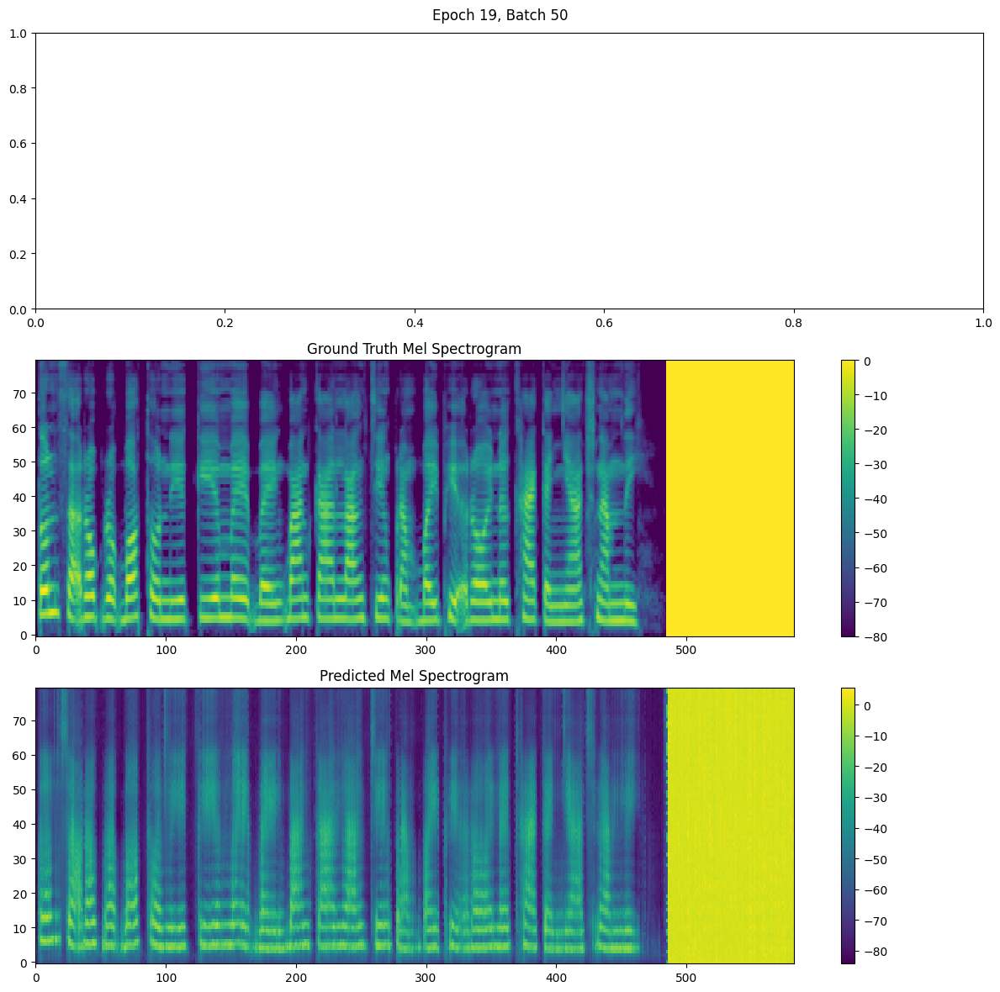

Gradient norm: 120.47603252276338
Epoch 19/20, Batch 50, Loss: 77.7528, Mel Loss: 77.7402, Gate Loss: 0.0126, LR: 0.000199
Gradient norm: 155.51762108037047
Epoch 19/20, Batch 60, Loss: 91.9396, Mel Loss: 91.9280, Gate Loss: 0.0115, LR: 0.000199
Gradient norm: 96.73759245146641
Epoch 19/20, Batch 70, Loss: 96.3665, Mel Loss: 96.3530, Gate Loss: 0.0135, LR: 0.000199
Gradient norm: 144.27959366619768
Epoch 19/20, Batch 80, Loss: 66.1256, Mel Loss: 66.1191, Gate Loss: 0.0065, LR: 0.000199
Gradient norm: 177.21214275990187
Epoch 19/20, Batch 90, Loss: 89.4349, Mel Loss: 89.4239, Gate Loss: 0.0110, LR: 0.000199


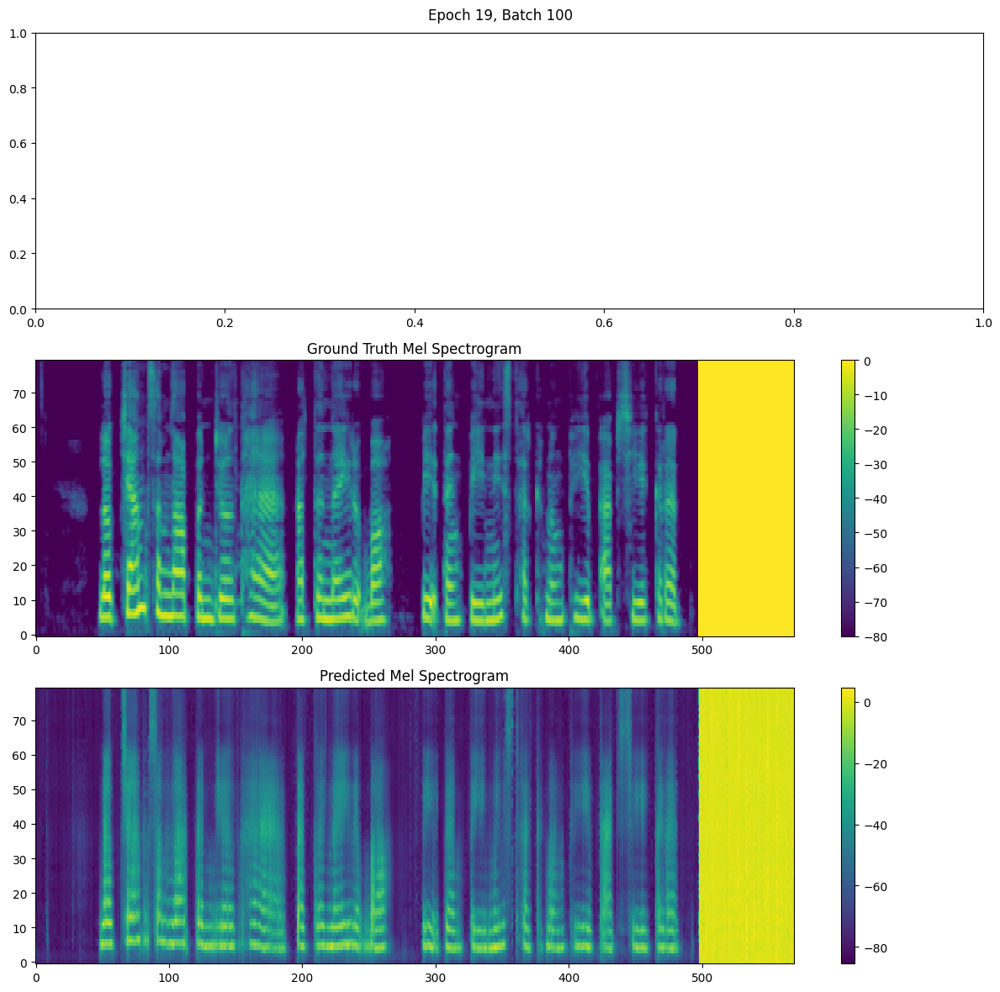

Gradient norm: 169.97488076716408
Epoch 19/20, Batch 100, Loss: 83.2621, Mel Loss: 83.2503, Gate Loss: 0.0118, LR: 0.000199
Gradient norm: 114.76789994603494
Epoch 19/20, Batch 110, Loss: 77.1512, Mel Loss: 77.1394, Gate Loss: 0.0118, LR: 0.000199
Gradient norm: 174.49769262815997
Epoch 19/20, Batch 120, Loss: 72.8359, Mel Loss: 72.8261, Gate Loss: 0.0098, LR: 0.000199
Epoch 19/20, Average Loss: 76.8879


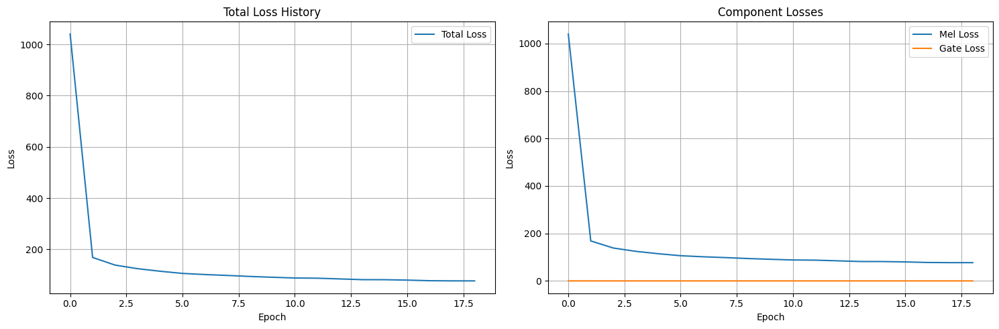

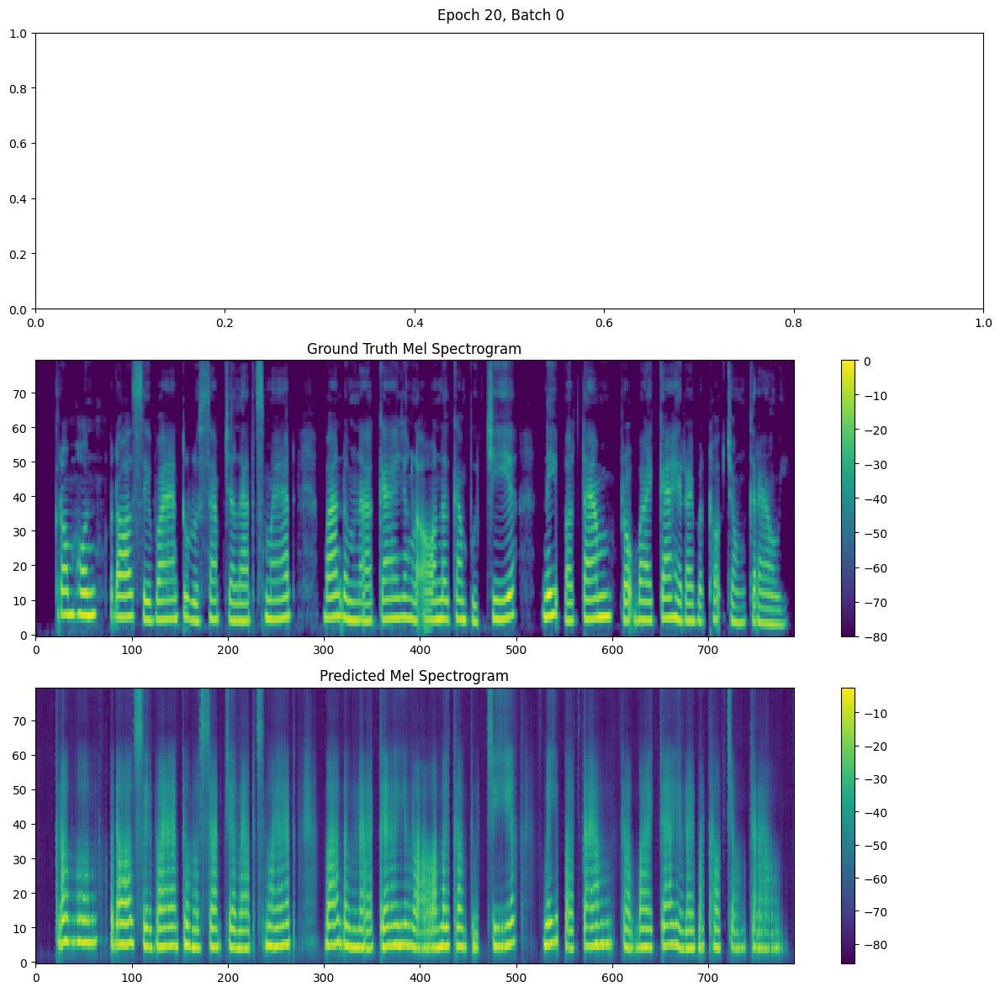

Gradient norm: 110.6717825289448
Epoch 20/20, Batch 0, Loss: 65.4488, Mel Loss: 65.4413, Gate Loss: 0.0075, LR: 0.000189
Gradient norm: 91.12790383934833
Epoch 20/20, Batch 10, Loss: 77.5060, Mel Loss: 77.4963, Gate Loss: 0.0097, LR: 0.000189
Gradient norm: 93.35761198197336
Epoch 20/20, Batch 20, Loss: 62.5240, Mel Loss: 62.5147, Gate Loss: 0.0093, LR: 0.000189
Gradient norm: 140.17155819360747
Epoch 20/20, Batch 30, Loss: 76.1598, Mel Loss: 76.1505, Gate Loss: 0.0092, LR: 0.000189
Gradient norm: 56.049318741307026
Epoch 20/20, Batch 40, Loss: 64.8472, Mel Loss: 64.8396, Gate Loss: 0.0076, LR: 0.000189


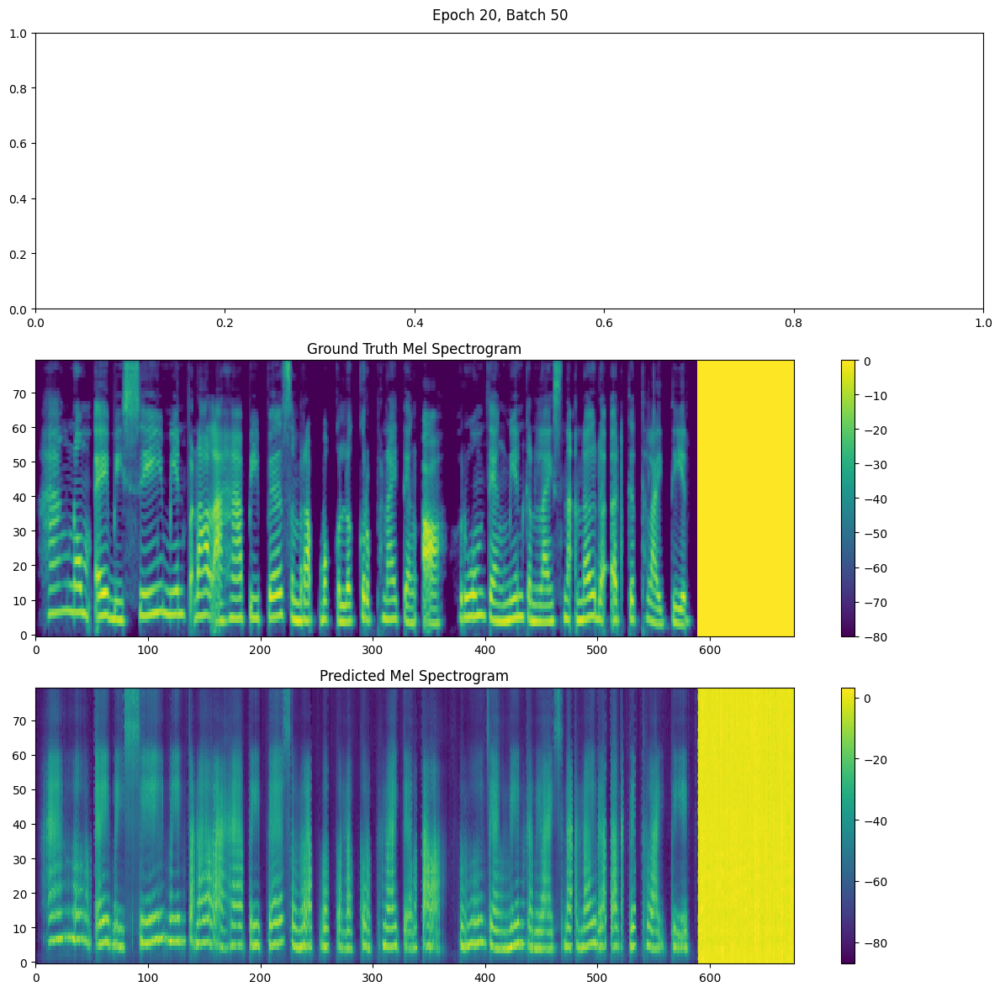

Gradient norm: 177.10553919210253
Epoch 20/20, Batch 50, Loss: 77.9319, Mel Loss: 77.9224, Gate Loss: 0.0095, LR: 0.000189
Gradient norm: 76.17576311198997
Epoch 20/20, Batch 60, Loss: 69.9808, Mel Loss: 69.9714, Gate Loss: 0.0094, LR: 0.000189
Gradient norm: 62.158253060688594
Epoch 20/20, Batch 70, Loss: 66.3494, Mel Loss: 66.3396, Gate Loss: 0.0098, LR: 0.000189
Gradient norm: 61.93826032696916
Epoch 20/20, Batch 80, Loss: 56.6888, Mel Loss: 56.6799, Gate Loss: 0.0089, LR: 0.000189
Gradient norm: 165.45148258689946
Epoch 20/20, Batch 90, Loss: 91.5389, Mel Loss: 91.5260, Gate Loss: 0.0128, LR: 0.000189


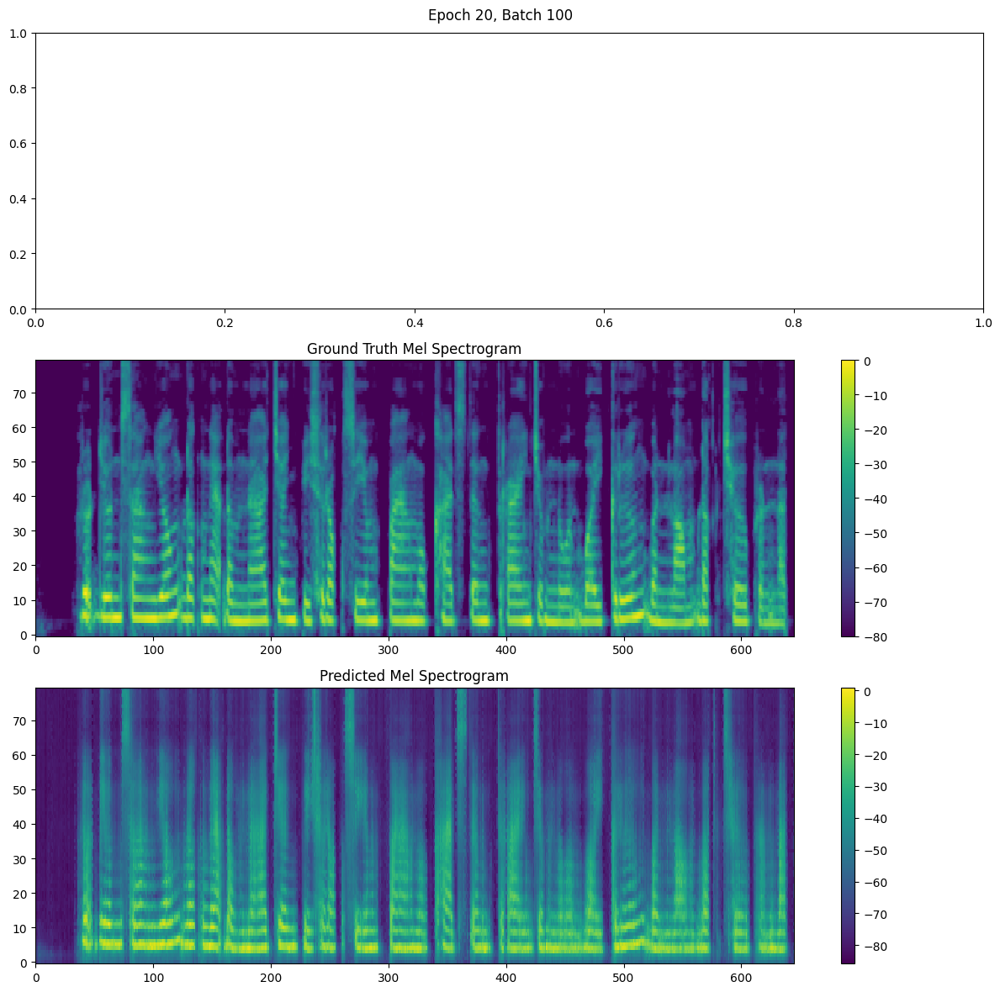

Gradient norm: 142.26647918148763
Epoch 20/20, Batch 100, Loss: 71.9438, Mel Loss: 71.9338, Gate Loss: 0.0100, LR: 0.000189
Gradient norm: 102.70288120594319
Epoch 20/20, Batch 110, Loss: 69.4843, Mel Loss: 69.4733, Gate Loss: 0.0109, LR: 0.000189
Gradient norm: 89.93440001129296
Epoch 20/20, Batch 120, Loss: 72.6548, Mel Loss: 72.6446, Gate Loss: 0.0102, LR: 0.000189
Epoch 20/20, Average Loss: 73.6058


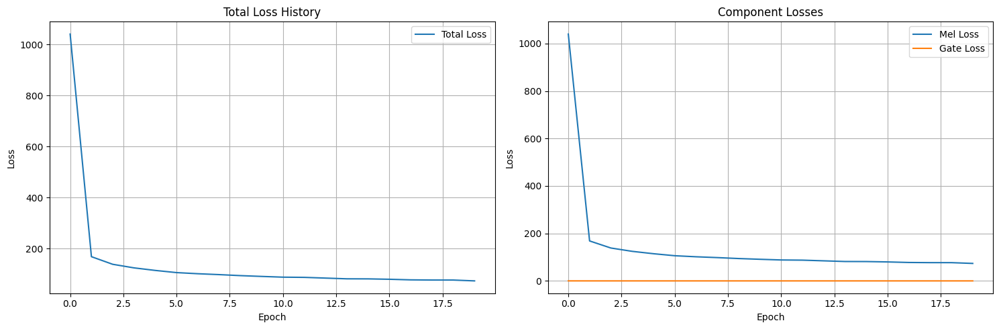

Checkpoint saved at epoch 20
Sample text shape: torch.Size([1, 87])
Sample text length: tensor([87], device='cuda:0')
Error during checkpoint generation: Tacotron2.infer() got an unexpected keyword argument 'max_decoder_steps'
Continuing training...

Training Completed!


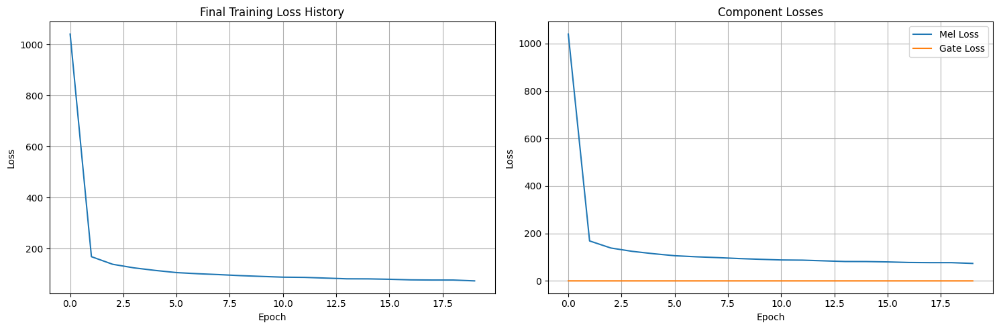

In [18]:
import torch.nn as nn
import torch.optim as optim
import matplotlib.pyplot as plt
import numpy as np
import torchaudio
import torch
import random

# Load Tacotron 2 and vocoder
device = "cuda" if torch.cuda.is_available() else "cpu"
tacotron2 = torch.hub.load('NVIDIA/DeepLearningExamples:torchhub',
                          'nvidia_tacotron2',
                          model_math='fp16',
                          pretrained=False)
tacotron2 = tacotron2.to(device)

# Initialize vocoder
vocoder = torchaudio.pipelines.TACOTRON2_WAVERNN_CHAR_LJSPEECH.get_vocoder().to(device)

# Initialize lists to store history
loss_history = []
mel_loss_history = []
gate_loss_history = []

# Training parameters
optimizer = optim.Adam(tacotron2.parameters(),
                      lr=5e-4,  # Reduced learning rate
                      weight_decay=1e-6)
scheduler = torch.optim.lr_scheduler.ExponentialLR(optimizer, gamma=0.95)
epochs = 20
grad_clip_thresh = 1.0
teacher_forcing_ratio = 0.9

def plot_waveform_and_mel(mel_output, mel_target, waveform, epoch, batch_idx):
    """Plot waveform and mel spectrograms"""
    fig, axes = plt.subplots(3, 1, figsize=(12, 12))

    # Plot waveform
    # waveform = waveform.cpu().squeeze(0).numpy()
    # time_axis = np.arange(len(waveform)) / 22050
    # axes[0].plot(time_axis, waveform)
    # axes[0].set_title('Generated Waveform')
    # axes[0].set_xlabel('Time (s)')
    # axes[0].set_ylabel('Amplitude')
    # axes[0].grid(True)

    # Plot ground truth mel spectrogram
    im = axes[1].imshow(mel_target, aspect='auto', origin='lower', interpolation='none')
    axes[1].set_title('Ground Truth Mel Spectrogram')
    plt.colorbar(im, ax=axes[1])

    # Plot predicted mel spectrogram
    im = axes[2].imshow(mel_output, aspect='auto', origin='lower', interpolation='none')
    axes[2].set_title('Predicted Mel Spectrogram')
    plt.colorbar(im, ax=axes[2])

    plt.suptitle(f'Epoch {epoch+1}, Batch {batch_idx}')
    plt.tight_layout()
    plt.show()

def plot_training_progress(loss_history, mel_losses, gate_losses):
    """Plot the training progress"""
    plt.figure(figsize=(15, 5))

    plt.subplot(1, 2, 1)
    plt.plot(loss_history, label='Total Loss')
    plt.title('Total Loss History')
    plt.xlabel('Epoch')
    plt.ylabel('Loss')
    plt.grid(True)
    plt.legend()

    plt.subplot(1, 2, 2)
    plt.plot(mel_losses, label='Mel Loss')
    plt.plot(gate_losses, label='Gate Loss')
    plt.title('Component Losses')
    plt.xlabel('Epoch')
    plt.ylabel('Loss')
    plt.grid(True)
    plt.legend()

    plt.tight_layout()
    plt.show()

# Training loop
for epoch in range(epochs):
    tacotron2.train()
    running_loss = 0.0
    running_mel_loss = 0.0
    running_gate_loss = 0.0

    for batch_idx, (text_padded, text_lengths, mel_padded, mel_lengths, gates_padded) in enumerate(dataloader):
        # Move all tensors to device
        text_padded = text_padded.to(device)
        text_lengths = text_lengths.to(device)
        mel_padded = mel_padded.to(device)
        mel_lengths = mel_lengths.to(device)
        gates_padded = gates_padded.to(device)

        try:
            # Forward pass
            max_len = torch.max(mel_lengths).item()
            use_teacher_forcing = (random.random() < teacher_forcing_ratio)
            model_inputs = (text_padded, text_lengths, mel_padded, max_len, mel_lengths)

            outputs = tacotron2(model_inputs)
            mel_out, mel_out_postnet, gate_out = outputs[0], outputs[1], outputs[2]

            # Check output sizes
            if mel_out.size(2) < 2:
                print(f"Warning: Very short mel output detected (size: {mel_out.size()})")
                continue

            # Compute loss with size checks
            mel_target = mel_padded[:, :, :mel_out.size(2)]
            gate_target = gates_padded[:, :gate_out.size(1)]

            mel_loss = torch.nn.MSELoss()(mel_out, mel_target) + \
                      torch.nn.MSELoss()(mel_out_postnet, mel_target)
            gate_loss = torch.nn.BCEWithLogitsLoss()(gate_out, gate_target)
            loss = mel_loss + gate_loss

            # Visualization every 50 batches
            if batch_idx % 50 == 0:
                with torch.no_grad():
                    mel_target = mel_padded[0].cpu().detach().numpy()
                    mel_pred = mel_out_postnet[0].cpu().detach().numpy()

                    if mel_out_postnet.size(2) > 0:
                        try:
                            waveforms, lengths = vocoder(mel_out_postnet,
                                                       torch.tensor([mel_out_postnet.size(2)]))
                            plot_waveform_and_mel(mel_pred, mel_target, waveforms,
                                                epoch, batch_idx)
                        except Exception as e:
                            print(f"Error generating waveform: {e}")
                            continue

            if torch.isnan(loss):
                print(f"NaN loss detected at epoch {epoch}, batch {batch_idx}")
                print("Current learning rate:", optimizer.param_groups[0]['lr'])
                continue

            # Backward pass
            optimizer.zero_grad()
            loss.backward()

            # Gradient value checking
            total_norm = 0
            for p in tacotron2.parameters():
                if p.grad is not None:
                    param_norm = p.grad.data.norm(2)
                    total_norm += param_norm.item() ** 2
            total_norm = total_norm ** (1. / 2)

            if batch_idx % 10 == 0:
                print(f"Gradient norm: {total_norm}")

            # Gradient clipping
            torch.nn.utils.clip_grad_norm_(tacotron2.parameters(), grad_clip_thresh)

            # Update weights
            optimizer.step()

            # Update running losses
            running_loss += loss.item()
            running_mel_loss += mel_loss.item()
            running_gate_loss += gate_loss.item()

            # Print progress
            if batch_idx % 10 == 0:
                print(f'Epoch {epoch+1}/{epochs}, Batch {batch_idx}, '
                      f'Loss: {loss.item():.4f}, '
                      f'Mel Loss: {mel_loss.item():.4f}, '
                      f'Gate Loss: {gate_loss.item():.4f}, '
                      f'LR: {optimizer.param_groups[0]["lr"]:.6f}')

        except RuntimeError as e:
            print(f"Error in batch {batch_idx}: {e}")
            print(f"Mel output size: {mel_out.size()}")
            print(f"Gate output size: {gate_out.size()}")
            print(f"Target mel size: {mel_padded.size()}")
            continue

    # Step the learning rate scheduler
    scheduler.step()

    # Calculate and store epoch losses
    num_batches = len(dataloader)
    epoch_loss = running_loss / num_batches
    epoch_mel_loss = running_mel_loss / num_batches
    epoch_gate_loss = running_gate_loss / num_batches

    loss_history.append(epoch_loss)
    mel_loss_history.append(epoch_mel_loss)
    gate_loss_history.append(epoch_gate_loss)

    print(f'Epoch {epoch+1}/{epochs}, Average Loss: {epoch_loss:.4f}')

    # Plot training progress
    plot_training_progress(loss_history, mel_loss_history, gate_loss_history)

    # Save checkpoint and generate samples
    if (epoch + 1) % 5 == 0:
        # Save checkpoint
        checkpoint = {
            'epoch': epoch,
            'model_state_dict': tacotron2.state_dict(),
            'optimizer_state_dict': optimizer.state_dict(),
            'scheduler_state_dict': scheduler.state_dict(),
            'loss': epoch_loss,
        }
        torch.save(checkpoint,
                f'{output_path}/models/tacotron2_checkpoint_epoch_{epoch+1}.pth')
        print(f'Checkpoint saved at epoch {epoch + 1}')

        # Generate and plot sample at checkpoint
        with torch.no_grad():
            try:
                # Switch to eval mode for inference
                tacotron2.eval()

                # Get sample from batch
                sample_text = text_padded[0:1]
                sample_text_lengths = text_lengths[0:1]

                print(f"Sample text shape: {sample_text.shape}")
                print(f"Sample text length: {sample_text_lengths}")

                # Try inference with lower gate threshold
                if hasattr(tacotron2.decoder, 'gate_threshold'):
                    tacotron2.decoder.gate_threshold = 0.2

                # Generate mel spectrogram
                mel_outputs, mel_outputs_postnet, _ = tacotron2.infer(
                    sample_text,
                    sample_text_lengths,
                    max_decoder_steps=1000  # Force longer generation
                )

                print(f"Generated mel shape: {mel_outputs_postnet.shape}")

                # Only proceed if we have a valid spectrogram
                if mel_outputs_postnet.size(2) > 1:
                    try:
                        waveforms, lengths = vocoder(
                            mel_outputs_postnet,
                            torch.tensor([mel_outputs_postnet.size(2)])
                        )
                        plot_waveform_and_mel(
                            mel_outputs_postnet[0].cpu().numpy(),
                            mel_padded[0].cpu().numpy(),
                            waveforms,
                            epoch,
                            "checkpoint"
                        )
                    except Exception as e:
                        print(f"Error generating checkpoint waveform: {e}")
                else:
                    print("Generated spectrogram too short for visualization")

            except Exception as e:
                print(f"Error during checkpoint generation: {e}")
                print("Continuing training...")

            # Switch back to training mode
            tacotron2.train()

print("\nTraining Completed!")

# Final training visualization
plt.figure(figsize=(15, 5))
plt.subplot(1, 2, 1)
plt.plot(loss_history)
plt.title('Final Training Loss History')
plt.xlabel('Epoch')
plt.ylabel('Loss')
plt.grid(True)

plt.subplot(1, 2, 2)
plt.plot(mel_loss_history, label='Mel Loss')
plt.plot(gate_loss_history, label='Gate Loss')
plt.title('Component Losses')
plt.xlabel('Epoch')
plt.ylabel('Loss')
plt.grid(True)
plt.legend()

plt.tight_layout()
plt.show()

### Text Synthesizing

In [23]:
import IPython
import torch
import torchaudio
import os
import torchaudio.transforms as T

def griffin_lim_vocoder(mel_spectrogram, n_iter=32):
    # Debug prints
    print(f"Mel spectrogram shape: {mel_spectrogram.shape}")
    print(f"Mel spectrogram min/max: {mel_spectrogram.min(dim=2)[0].min(dim=1)[0]}/{mel_spectrogram.max(dim=2)[0].max(dim=1)[0]}")
    print(f"Any NaN values: {torch.isnan(mel_spectrogram).any()}")

    # Ensure we have valid values
    if mel_spectrogram.size(2) == 0:
        raise ValueError("Empty mel spectrogram")

    # Convert mel spectrogram back to linear spectrogram
    n_fft = 2048
    mel_to_linear = T.InverseMelScale(
        n_stft=n_fft // 2 + 1,
        n_mels=80,
        sample_rate=22050,
        norm='slaney',  # Add normalization
        mel_scale='slaney'  # Specify mel scale type
    ).to(device)

    # Normalize mel spectrogram if needed
    if mel_spectrogram.min() < 0:
        mel_spectrogram = (mel_spectrogram - mel_spectrogram.min()) / (mel_spectrogram.max() - mel_spectrogram.min())

    linear_spectrogram = mel_to_linear(mel_spectrogram)
    print(f"Linear spectrogram shape: {linear_spectrogram.shape}")

    # Apply Griffin-Lim
    griffin_lim = T.GriffinLim(
        n_fft=n_fft,
        n_iter=n_iter,
        hop_length=256,
        win_length=2048,
        power=1.0
    ).to(device)

    try:
        waveforms = griffin_lim(linear_spectrogram)
        print(f"Generated waveform shape: {waveforms.shape}")
        return waveforms
    except Exception as e:
        print(f"Error in Griffin-Lim: {e}")
        raise


def load_universal_vocoder():
    vocoder = torch.hub.load('descriptinc/melgan-neurips', 'load_melgan')
    vocoder.eval()
    vocoder = vocoder.to(device)
    return vocoder

# Set CUDA_LAUNCH_BLOCKING to 1 for debugging
os.environ['CUDA_LAUNCH_BLOCKING'] = '1'

device = "cuda" if torch.cuda.is_available() else "cpu"
bundle = torchaudio.pipelines.TACOTRON2_WAVERNN_CHAR_LJSPEECH
vocoder = bundle.get_vocoder()

# Try moving the vocoder to the GPU again
try:
    vocoder = vocoder.to(device)
except RuntimeError as e:
    print(f"Error moving vocoder to GPU: {e}")
    print("Check data types and shapes, and ensure sufficient GPU memory.")
    device = "cpu" # Fallback to CPU
    vocoder = vocoder.to(device)

In [27]:
import ast

def load_vocab_from_txt(file_path):
    vocab = {}
    with open(file_path, 'r', encoding='utf-8') as f:
        vocab_str = f.read()

    vocab_dict = ast.literal_eval(vocab_str)
    vocab_set = list(vocab_dict.keys())

    return vocab_set

# Read vocab file
vocab_file_path = f"{output_path}/tacotron2_grapheme_vocab.txt"
vocab_dict = load_vocab_from_txt(vocab_file_path)
print(vocab_dict)

# Re-encode it
vocab = {token: idx for idx, token in enumerate(vocab_dict)}
print(vocab)

[' ', 'ក', 'ខ', 'គ', 'ឃ', 'ង', 'ច', 'ឆ', 'ជ', 'ឈ', 'ញ', 'ដ', 'ឋ', 'ឌ', 'ឍ', 'ណ', 'ត', 'ថ', 'ទ', 'ធ', 'ន', 'ប', 'ផ', 'ព', 'ភ', 'ម', 'យ', 'រ', 'ល', 'វ', 'ស', 'ហ', 'ឡ', 'អ', 'ឥ', 'ឧ', 'ឪ', 'ឫ', 'ឬ', 'ឭ', 'ឮ', 'ឯ', 'ឱ', 'ា', 'ិ', 'ី', 'ឹ', 'ឺ', 'ុ', 'ូ', 'ួ', 'ើ', 'ឿ', 'ៀ', 'េ', 'ែ', 'ៃ', 'ោ', 'ៅ', 'ំ', 'ះ', 'ៈ', '៉', '៊', '់', '៌', '៍', '៎', '៏', '័', '្']
{' ': 0, 'ក': 1, 'ខ': 2, 'គ': 3, 'ឃ': 4, 'ង': 5, 'ច': 6, 'ឆ': 7, 'ជ': 8, 'ឈ': 9, 'ញ': 10, 'ដ': 11, 'ឋ': 12, 'ឌ': 13, 'ឍ': 14, 'ណ': 15, 'ត': 16, 'ថ': 17, 'ទ': 18, 'ធ': 19, 'ន': 20, 'ប': 21, 'ផ': 22, 'ព': 23, 'ភ': 24, 'ម': 25, 'យ': 26, 'រ': 27, 'ល': 28, 'វ': 29, 'ស': 30, 'ហ': 31, 'ឡ': 32, 'អ': 33, 'ឥ': 34, 'ឧ': 35, 'ឪ': 36, 'ឫ': 37, 'ឬ': 38, 'ឭ': 39, 'ឮ': 40, 'ឯ': 41, 'ឱ': 42, 'ា': 43, 'ិ': 44, 'ី': 45, 'ឹ': 46, 'ឺ': 47, 'ុ': 48, 'ូ': 49, 'ួ': 50, 'ើ': 51, 'ឿ': 52, 'ៀ': 53, 'េ': 54, 'ែ': 55, 'ៃ': 56, 'ោ': 57, 'ៅ': 58, 'ំ': 59, 'ះ': 60, 'ៈ': 61, '៉': 62, '៊': 63, '់': 64, '៌': 65, '៍': 66, '៎': 67, '៏': 68, '័': 69, '្': 70}


In [28]:
def char_tokenize(text):
    # Special handling for Khmer text to properly handle subconsonants
    chars = []
    i = 0
    while i < len(text):
        if i + 1 < len(text) and text[i + 1] == '្':
            # Include the character, subconsonant marker, and following consonant
            chars.append(text[i])    # First consonant
            chars.append(text[i+1])  # Subconsonant marker
            i += 2
            if i < len(text):
                chars.append(text[i]) # Second consonant
                i += 1
        else:
            chars.append(text[i])
            i += 1
    return chars

# សួស្តីខ្ញុំឈ្មោះសំ ទំហំទ្រូង សម្លៀកបំពាក់

# Test with your word
text = "ស្ពាន កំពង់ ចម្លង អ្នកលឿង នៅ ព្រៃវែង"
tokenized_text = char_tokenize(text)
print(f"Tokenized: {tokenized_text}")

# Now encode the characters
encoded_text = [vocab[token] for token in tokenized_text]
print(f"Encoded: {encoded_text}")

input_text = torch.tensor(encoded_text, dtype=torch.long)
print(f"Input: {input_text}")
input_lengths = torch.tensor([len(encoded_text)], dtype=torch.long)
print(f"Input length: {input_lengths}")

# Debug input processing
print("Input text:", text)  # The actual text being processed
print("Encoded text:", encoded_text)  # The encoded values
print("Vocabulary size:", len(vocab))
print("Max token value in input:", max(encoded_text))

Tokenized: ['ស', '្', 'ព', 'ា', 'ន', ' ', 'ក', 'ំ', 'ព', 'ង', '់', ' ', 'ច', 'ម', '្', 'ល', 'ង', ' ', 'អ', '្', 'ន', 'ក', 'ល', 'ឿ', 'ង', ' ', 'ន', 'ៅ', ' ', 'ព', '្', 'រ', 'ៃ', 'វ', 'ែ', 'ង']
Encoded: [30, 70, 23, 43, 20, 0, 1, 59, 23, 5, 64, 0, 6, 25, 70, 28, 5, 0, 33, 70, 20, 1, 28, 52, 5, 0, 20, 58, 0, 23, 70, 27, 56, 29, 55, 5]
Input: tensor([30, 70, 23, 43, 20,  0,  1, 59, 23,  5, 64,  0,  6, 25, 70, 28,  5,  0,
        33, 70, 20,  1, 28, 52,  5,  0, 20, 58,  0, 23, 70, 27, 56, 29, 55,  5])
Input length: tensor([36])
Input text: ស្ពាន កំពង់ ចម្លង អ្នកលឿង នៅ ព្រៃវែង
Encoded text: [30, 70, 23, 43, 20, 0, 1, 59, 23, 5, 64, 0, 6, 25, 70, 28, 5, 0, 33, 70, 20, 1, 28, 52, 5, 0, 20, 58, 0, 23, 70, 27, 56, 29, 55, 5]
Vocabulary size: 71
Max token value in input: 70


D:\temp\ipykernel_22480\1772975705.py:6: FutureWarning: You are using `torch.load` with `weights_only=False` (the current default value), which uses the default pickle module implicitly. It is possible to construct malicious pickle data which will execute arbitrary code during unpickling (See https://github.com/pytorch/pytorch/blob/main/SECURITY.md#untrusted-models for more details). In a future release, the default value for `weights_only` will be flipped to `True`. This limits the functions that could be executed during unpickling. Arbitrary objects will no longer be allowed to be loaded via this mode unless they are explicitly allowlisted by the user via `torch.serialization.add_safe_globals`. We recommend you start setting `weights_only=True` for any use case where you don't have full control of the loaded file. Please open an issue on GitHub for any issues related to this experimental feature.
  checkpoint = torch.load(f"{output_path}/models/tacotron2_checkpoint_epoch_20.pth",
Usi

Original input shape: torch.Size([1, 36])
Reshaped input shape: torch.Size([1, 36])
Input lengths shape: torch.Size([1])
Vocabulary check:
Input text tokens: [30, 70, 23, 43, 20, 0, 1, 59, 23, 5, 64, 0, 6, 25, 70, 28, 5, 0, 33, 70, 20, 1, 28, 52, 5, 0, 20, 58, 0, 23, 70, 27, 56, 29, 55, 5]
Vocabulary size: 148
Embedding dimension: 512

Inference outputs:
Mel output shape: torch.Size([1, 80, 1])
Mel lengths: tensor([0], device='cuda:0', dtype=torch.int32)
Gate values shape: torch.Size([1, 1, 36])
Gate values min/max: 0.000/0.067
Padding mel output from 1 to 50 frames
Mel Output: tensor([[[-68.9101,   0.0000,   0.0000,  ...,   0.0000,   0.0000,   0.0000],
         [-65.4881,   0.0000,   0.0000,  ...,   0.0000,   0.0000,   0.0000],
         [-63.6988,   0.0000,   0.0000,  ...,   0.0000,   0.0000,   0.0000],
         ...,
         [-73.6057,   0.0000,   0.0000,  ...,   0.0000,   0.0000,   0.0000],
         [-73.7020,   0.0000,   0.0000,  ...,   0.0000,   0.0000,   0.0000],
         [-73.12

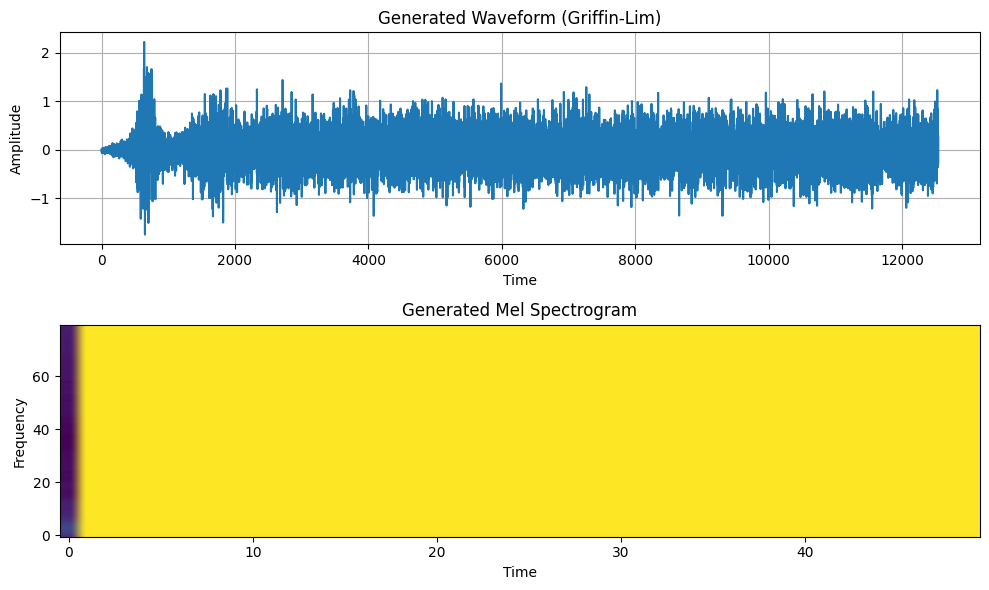


Input range verification:
Min input value: 0
Max input value: 70
Vocabulary size: 148


In [31]:
import torch.nn as nn
import matplotlib.pyplot as plt
import IPython.display

# Load model and checkpoint
checkpoint = torch.load(f"{output_path}/models/tacotron2_checkpoint_epoch_20.pth",
                       map_location=torch.device('cpu'))

# Create model
model = torch.hub.load('NVIDIA/DeepLearningExamples:torchhub',
                      'nvidia_tacotron2',
                      model_math='fp16',
                      pretrained=False)

# Get the embedding weights from checkpoint
checkpoint_embed_weight = checkpoint['model_state_dict']['embedding.weight']
orig_vocab_size = checkpoint_embed_weight.shape[0]  # 148
embedding_dim = checkpoint_embed_weight.shape[1]    # 512

# Create new embedding that matches the checkpoint
model.embedding = nn.Embedding(orig_vocab_size, embedding_dim)
# Load just the model state dict, not the entire checkpoint
try:
    model.load_state_dict(checkpoint['model_state_dict'])
except RuntimeError as e:
    print(f"Detailed error loading state dict: {e}")
    # Print model vs checkpoint keys for comparison
    model_keys = set(model.state_dict().keys())
    checkpoint_keys = set(checkpoint['model_state_dict'].keys())
    print("\nMissing keys:", model_keys - checkpoint_keys)
    print("\nUnexpected keys:", checkpoint_keys - model_keys)

model = model.to(device)
model.eval()

# Debug the input shapes
print("Original input shape:", input_text.shape)
input_text = input_text.view(1, -1)  # Reshape to (batch_size, sequence_length)
print("Reshaped input shape:", input_text.shape)
input_lengths = torch.tensor([input_text.size(1)], dtype=torch.long, device=device)
print("Input lengths shape:", input_lengths.shape)

# Debug input and model state
print("Vocabulary check:")
print(f"Input text tokens: {encoded_text}")
print(f"Vocabulary size: {orig_vocab_size}")
print(f"Embedding dimension: {embedding_dim}")

# Inference code
with torch.no_grad():
    input_text = input_text.view(1, -1).long()
    input_lengths = torch.tensor([input_text.size(1)], dtype=torch.long, device=device)

    input_text = input_text.to(device)
    input_lengths = input_lengths.to(device)

    try:
        # Set a lower gate threshold to generate longer sequences
        if hasattr(model.decoder, 'gate_threshold'):
            model.decoder.gate_threshold = 0.2

        # Generate mel spectrogram
        mel_output, mel_lengths, gate = model.infer(input_text, input_lengths)

        print(f"\nInference outputs:")
        print(f"Mel output shape: {mel_output.shape}")
        print(f"Mel lengths: {mel_lengths}")
        print(f"Gate values shape: {gate.shape}")
        print(f"Gate values min/max: {gate.min().item():.3f}/{gate.max().item():.3f}")

        if mel_output.size(2) > 0:
            # Force a minimum length if needed
            min_length = 50
            if mel_output.size(2) < min_length:
                print(f"Padding mel output from {mel_output.size(2)} to {min_length} frames")
                mel_output = torch.nn.functional.pad(mel_output, (0, min_length - mel_output.size(2)))
                mel_lengths = torch.tensor([min_length], device=device)

            print(f'Mel Output: {mel_output}')
            print(f'Mel Length: {mel_lengths}')
            waveforms = griffin_lim_vocoder(mel_output)

            # Plot and play audio
            def plot_waveform_and_spectrogram(waveforms, spec, sample_rate=22050):
                waveforms = waveforms.cpu().squeeze(0)
                spec = spec.cpu().squeeze(0)

                fig, (ax1, ax2) = plt.subplots(2, 1, figsize=(10, 6))

                ax1.plot(waveforms.numpy())
                ax1.set_title("Generated Waveform (Griffin-Lim)")
                ax1.set_xlabel("Time")
                ax1.set_ylabel("Amplitude")
                ax1.grid(True)

                ax2.imshow(spec, origin="lower", aspect="auto", cmap="viridis")
                ax2.set_title("Generated Mel Spectrogram")
                ax2.set_xlabel("Time")
                ax2.set_ylabel("Frequency")
                plt.tight_layout()

                plt.show()
                return IPython.display.Audio(waveforms.numpy(), rate=sample_rate)

            audio_widget = plot_waveform_and_spectrogram(waveforms, mel_output)
            display(audio_widget)
        else:
            print("Generated spectrogram has zero length. Try adjusting the gate threshold.")

    except Exception as e:
        print(f"Inference error: {e}")
        import traceback
        traceback.print_exc()

# Let's also verify the input data range
print("\nInput range verification:")
print(f"Min input value: {input_text.min().item()}")
print(f"Max input value: {input_text.max().item()}")
print(f"Vocabulary size: {orig_vocab_size}")